In [1]:
!hostname

gnode014.cluster


In [2]:
!nvidia-smi

Sat Feb  3 16:26:37 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 545.23.08              Driver Version: 545.23.08    CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA H100 PCIe               Off | 00000000:A8:00.0 Off |                    0 |
| N/A   30C    P0              48W / 350W |      4MiB / 81559MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [3]:
import itertools as it
import pickle
import torch
import torch.nn as nn
import torch.optim as optim
import torch.fft
import torch.nn.functional as F
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sdeint
from toolbox import (
    make_loss,
    StatLoss,
    SINN,
    FPU
)
import time

In [4]:
torch.cuda.is_available()

True

In [5]:
device = torch.device('cuda')

In [6]:
print(torch.__version__)
print(torch.version.cuda)

2.0.1+cu118
11.8


In [7]:
seed = 1234
torch.set_default_dtype(torch.float)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)

200.0
(1000, 400) (1000, 400)
(400, 400) (400, 400) (400, 400)
(400, 400, 2)
CPU times: user 1.88 s, sys: 1.83 ms, total: 1.89 s
Wall time: 1.89 s


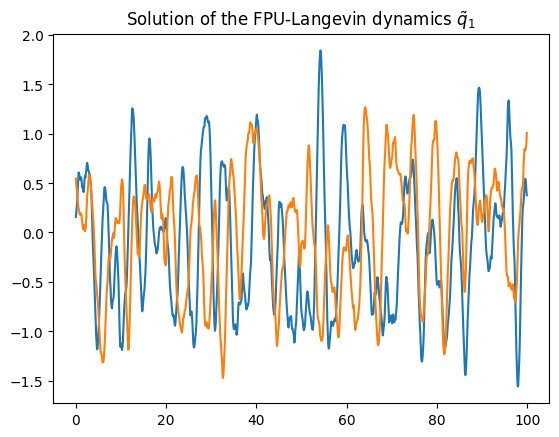

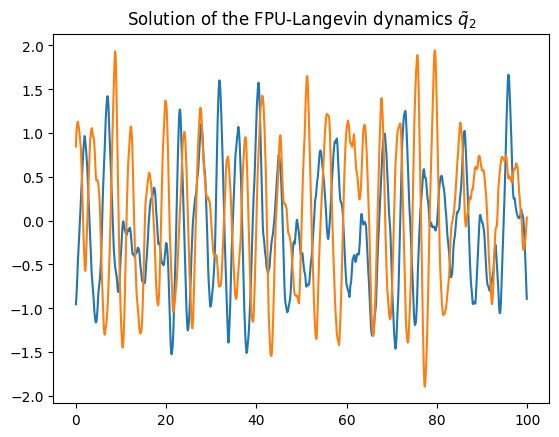

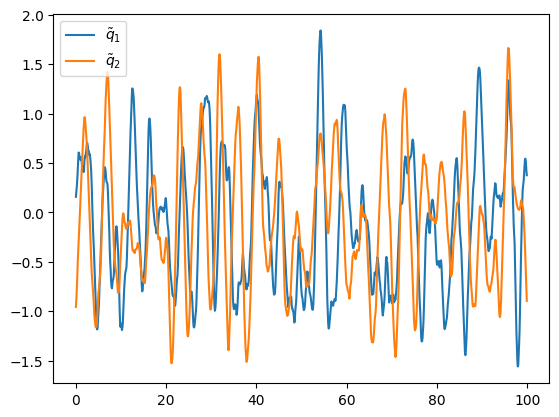

In [8]:
%%time

#### Generating SINN training data by solving SDE (Langevin dynamics)
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from scipy.integrate import quad


def V_FPU(x,U0,x0):
    v=U0/x0**4*x**3+U0/x0**2*x      # FPU potential 
    return v


#### Parameters 
gamma1 = 1                             # coupling constant 
gamma2 = .5                            # coupling constant
beta = 1                               # Inverse temperature, i.e. T=1/beta
dt = 0.01                              # Step-size of the SDE solver 
delta_t = 0.1                          # Step-size of the temporally coarse-grained path
batch = 400                           # Batch size 
sec_length = 400                       # Length of the input sequence 
U0 = 1                                 # FPU parameter, depth of the well 
x0 = 1                                 # FPU parameter, position of the basin 
rho = 0.25                             # Correlation of q1 and q2 

#### SDE solver (EM scheme) 
Time = 5*delta_t*sec_length
print(Time)
length=int(Time/dt)+1
t = np.linspace(0,Time,length) # define time axis
gap=int(delta_t/dt)
t_store=t[0:-1:gap]
q1_store = np.zeros([t_store.size+1,batch])
q2_store = np.zeros([t_store.size+1,batch])
# q_store = np.zeros([t_store.size+1,batch])
p1=np.zeros((2,batch))
p2=np.zeros((2,batch))
q1=np.zeros((2,batch))
q2=np.zeros((2,batch))

# solve SDE
j=1
for i in range(1,length):
     q1[1,:] = q1[0,:] + p1[0,:]*dt
     p1[1,:] = p1[0,:] + (-V_FPU(q1[0,:],U0,x0)-gamma1*p1[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma1/beta)
     q2[1,:] = q2[0,:] + p2[0,:]*dt
     p2[1,:] = p2[0,:] + (-V_FPU(q2[0,:],U0,x0)-gamma2*p2[0,:])*dt + np.random.randn(1,batch)*np.sqrt(2*dt*gamma2/beta)
     if i % gap ==0:            
            q1_store[j,:]=q1[1,:]
            q2_store[j,:]=rho*q1[1,:]+np.sqrt(1-rho**2)*q2[1,:]
            j=j+1
     p1[0,:]=p1[1,:]
     q1[0,:]=q1[1,:]
     p2[0,:]=p2[1,:]
     q2[0,:]=q2[1,:]

Toss=int(t_store.size/2)         
q1_store=q1_store[Toss:-1,:]         
q2_store=q2_store[Toss:-1,:]    
print(q1_store.shape,q2_store.shape)




plt.figure(0)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_1$")
# plt.savefig("figs/FPU_dt016.pdf", dpi=150)

plt.figure(1)
for i in range(2):
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,i])
plt.title(r"Solution of the FPU-Langevin dynamics $\tilde{q}_2$")

plt.figure(2)
plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0], label=r'$\tilde{q}_1$')
plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0], label=r'$\tilde{q}_2$')
# plt.title("Solution of the FPU-Langevin dynamics")
plt.legend()
# Construct the sample traj for SINN learning 
ini=np.random.randn(sec_length,batch)
Traj_q1=q1_store[0:sec_length,:]
Traj_q2=q2_store[0:sec_length,:]
print(ini.shape, Traj_q1.shape, Traj_q2.shape)

Traj = np.empty((sec_length,batch,2))
Traj[:,:,0] = Traj_q1
Traj[:,:,1] = Traj_q2
T=np.arange(len(Traj_q1[:,1]))*delta_t
x=np.linspace(-5,5,sec_length)
print(Traj.shape)

# 2 input

In [9]:
# Reformulating data into Torch tensors 
# Input of SINN should be of the form (seq_len, batch, input_size)

ini = np.random.randn(2*sec_length,2*batch).astype(np.float32) 
input = torch.from_numpy(ini.reshape(2*sec_length, batch, 2)).to(device)
batch_validation = batch
val_set = torch.normal(0.0, 1.0, (2*sec_length, batch_validation, 2), device=device)


Traj = Traj.astype(np.float32) 
target = torch.from_numpy(Traj.reshape(sec_length, batch, 2)).to(device)
print('The torch input size is', input.size(), input.dtype)
print('The torch validation size is', val_set.size(), val_set.dtype)
print('The torch target size is', target.size(), target.dtype)

The torch input size is torch.Size([800, 400, 2]) torch.float32
The torch validation size is torch.Size([800, 400, 2]) torch.float32
The torch target size is torch.Size([400, 400, 2]) torch.float32


(array([-3., -2., -1.,  0.,  1.,  2.,  3.]),
 [Text(0, -3.0, '−3'),
  Text(0, -2.0, '−2'),
  Text(0, -1.0, '−1'),
  Text(0, 0.0, '0'),
  Text(0, 1.0, '1'),
  Text(0, 2.0, '2'),
  Text(0, 3.0, '3')])

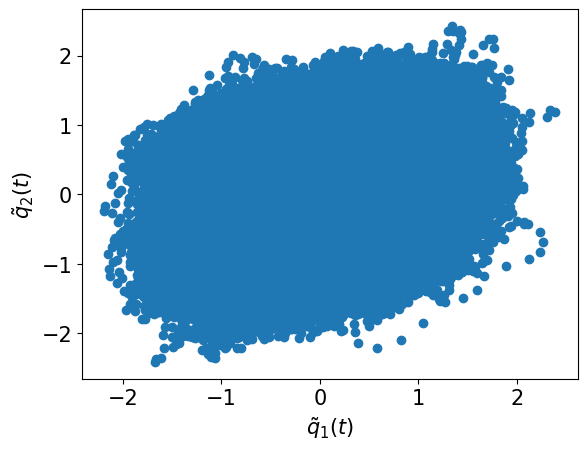

In [10]:
plt.scatter(Traj[:,:,0], Traj[:,:,1])
plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

In [11]:
# Defining Loss functions
LAGS = 400
N = 400
loss_acf_fft = make_loss('acf[fft]', target, lags=LAGS, device=device)
loss_acf_sec_moment = make_loss('acf[fft]', target**2, lags=LAGS, device=device)
loss_acf_bruteforce = make_loss('acf[bruteforce]', target, lags=LAGS, device=device)
loss_acf_randbrute = make_loss('acf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_ccf_fft = make_loss('ccf[fft]', target, lags=LAGS, device=device)
loss_ccf_sec_moment = make_loss('ccf[fft]', target**2, lags=LAGS, device=device)
loss_ccf_bruteforce = make_loss('ccf[bruteforce]', target, lags=LAGS, device=device)
loss_ccf_randbrute = make_loss('ccf[randombrute]', target, lags=LAGS, sample_lags=20, device=device)

loss_pdf_empirical1 = make_loss('pdf', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2 = make_loss('pdf6', target, lower=-5, upper=5, n=N, bw=None, device=device)
loss_pdf_empirical2D = make_loss('pdf2D', target, lower=-5, upper=5, n=N, bw=None, device=device)

torch.Size([400, 2])


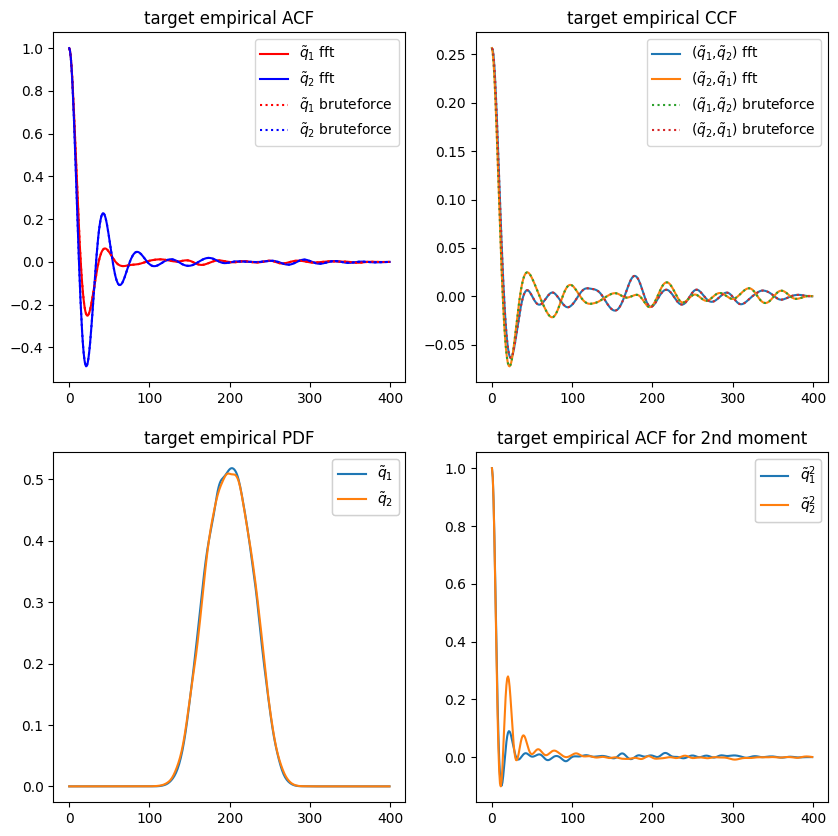

In [12]:
# Plotting target ACFs and PDF
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs[0,0].plot(loss_acf_fft._target.cpu()[...,0],'r', label=r'$\tilde{q}_1$ fft')
axs[0,0].plot(loss_acf_fft._target.cpu()[...,-1],'b', label=r'$\tilde{q}_2$ fft')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,0],'r:', label= r'$\tilde{q}_1$ bruteforce')
axs[0,0].plot(loss_acf_bruteforce._target.cpu()[...,1], 'b:', label=r'$\tilde{q}_2$ bruteforce')
axs[0,0].legend()
axs[0,0].set_title('target empirical ACF')

axs[0,1].plot(loss_ccf_fft._target.cpu()[...,0], label=r'($\tilde{q}_1$,$\tilde{q}_2$) fft')
axs[0,1].plot(loss_ccf_fft._target.cpu()[...,1], label=r'($\tilde{q}_2$,$\tilde{q}_1$) fft')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,0],':',label=r'($\tilde{q}_1$,$\tilde{q}_2$) bruteforce')
axs[0,1].plot(loss_ccf_bruteforce._target.cpu()[...,1],':',label=r'($\tilde{q}_2$,$\tilde{q}_1$) bruteforce')
# legend2 = axs[0,1].legend(iter(bf), ('q bf', 'p bf'), loc=1)
# axs[0,1].add_artist(legend2)
axs[0,1].legend()
axs[0,1].set_title('target empirical CCF')

x_grid=-np.linspace(-5,5,num=sec_length)
pdf = axs[1,0].plot(loss_pdf_empirical1._target.cpu())
legend3 = axs[1,0].legend(iter(pdf), (r'$\tilde{q}_1$', r'$\tilde{q}_2$'), loc=1)
axs[1,0].add_artist(legend3)
axs[1,0].set_title('target empirical PDF')


print(loss_acf_sec_moment._target.cpu().size())
sec_moment = axs[1,1].plot(loss_acf_sec_moment._target.cpu())
legend4 = axs[1,1].legend(iter(sec_moment), (r'$\tilde{q}_1^2$', r'$\tilde{q}_2^2$'),loc=1)
axs[1,1].set_title('target empirical ACF for 2nd moment')
axs[1,1].add_artist(legend4)

plt.show()

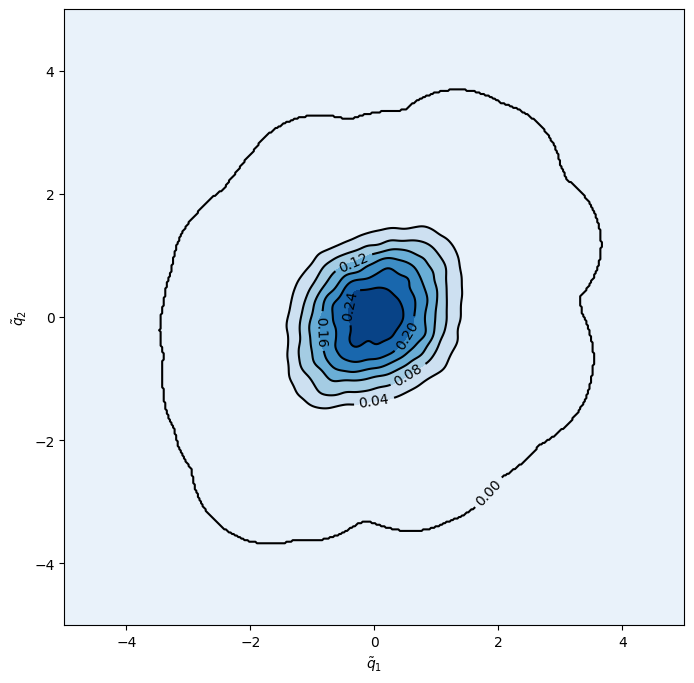

In [13]:
xmin, xmax = -5, 5
ymin, ymax = -5, 5

xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
fig = plt.figure(figsize=(8, 8))
ax = fig.gca()
ax.set_xlim(xmin, xmax)
ax.set_ylim(ymin, ymax)

# Contourf plot
cfset = ax.contourf(xx, yy, loss_pdf_empirical2D._target.cpu(), cmap='Blues')
## Or kernel density estimate plot instead of the contourf plot

# Contour plot
cset = ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), colors='k')
# Label plot
ax.clabel(cset, inline=1, fontsize=10)
ax.set_xlabel(r'$\tilde{q}_1$')
ax.set_ylabel(r'$\tilde{q}_2$')

plt.show()

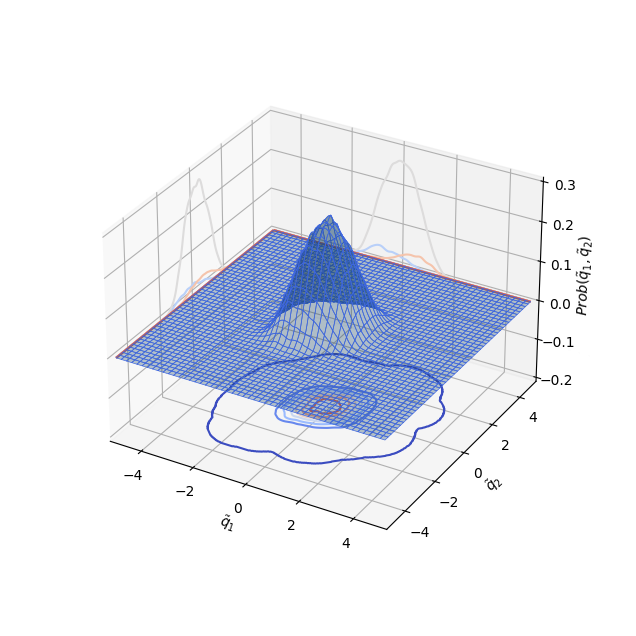

In [14]:
from mpl_toolkits.mplot3d import axes3d

ax = plt.figure(figsize=(8, 8)).add_subplot(projection='3d')
# fig = plt.figure()
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
ax.plot_surface(xx, yy, loss_pdf_empirical2D._target.cpu(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='z', offset=-0.2, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='x', offset=-5, cmap='coolwarm')
ax.contour(xx, yy, loss_pdf_empirical2D._target.cpu(), zdir='y', offset=5, cmap='coolwarm')

ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'$Prob(\tilde{q}_1,\tilde{q}_2)$')
ax.set_box_aspect(aspect=None, zoom=0.8)
plt.show()

Text(0.5, 1.0, 'target empirical PDF')

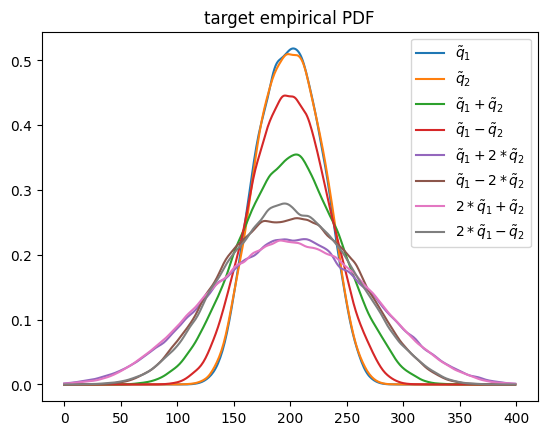

In [15]:
x_grid=-np.linspace(-5,5,num=sec_length)
plt.plot(loss_pdf_empirical1._target.cpu()[...,0],label=r'$\tilde{q}_1$')
plt.plot(loss_pdf_empirical1._target.cpu()[...,1],label=r'$\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,0],label=r'$\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,1],label=r'$\tilde{q}_1-\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,2],label=r'$\tilde{q}_1+2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,3],label=r'$\tilde{q}_1-2*\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,4],label=r'$2*\tilde{q}_1+\tilde{q}_2$')
plt.plot(loss_pdf_empirical2._target.cpu()[...,5],label=r'$2*\tilde{q}_1-\tilde{q}_2$')
plt.legend()
plt.title('target empirical PDF')

## 1.3. Loss function=CCF($\textbf{x}$)+PDF($\textbf{x}$)+ACF($\textbf{x}^2$)

In [16]:
class Model:
    def __init__(self, net):

        self.x_acf_s = None
        self.x_ccf_s = None
        self.x_pdf_s = None
        self.x_pdf2_s = None
        self.x_acf2_s = None
        self.s_collect = []

        self.net = net

        self.T_error=[]
        self.V_error=[]
        self.T_ccf=[]
        self.V_ccf=[]
        self.T_pdf=[]
        self.V_pdf=[]
        self.T_pdf2=[]
        self.V_pdf2=[]
        self.T_acf=[]
        self.V_acf=[]
        self.T_acf2=[]
        self.V_acf2=[]
        self.Step=[]
        self.iter = 0

    def train_U(self, x):
        return self.net(x)

    def predict_U(self, x):
        return self.train_U(x)

    def likelihood_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        loss = torch.reciprocal(2. * self.x_acf_s ** 2) * loss_acf.detach()      \
               + torch.reciprocal(2. * self.x_ccf_s ** 2) * loss_ccf.detach()    \
               + torch.reciprocal(2. * self.x_pdf_s ** 2) * loss_pdf.detach()    \
               + torch.reciprocal(2. * self.x_pdf2_s ** 2) * loss_pdf2.detach()  \
               + torch.reciprocal(2. * self.x_acf2_s ** 2) * loss_acf2.detach()  \
               + torch.log(self.x_acf_s * self.x_ccf_s * self.x_pdf_s * self.x_pdf2_s * self.x_acf2_s)
        return loss

    def true_loss(self, loss_acf, loss_ccf, loss_pdf, loss_pdf2, loss_acf2):
        return torch.reciprocal(2. * self.x_acf_s.detach() ** 2) * loss_acf + torch.reciprocal(2. * self.x_ccf_s.detach() ** 2) * loss_ccf + torch.reciprocal(2. * self.x_pdf_s.detach() ** 2) * loss_pdf + torch.reciprocal(2. * self.x_pdf2_s.detach() ** 2) * loss_pdf2 + torch.reciprocal(2. * self.x_acf2_s.detach() ** 2) * loss_acf2

    def run_baseline(self):
        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        for step in range(20000):
            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = loss_acf_fft(prediction)+ loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val)+ loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break

        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')



    def run_AW(self):
        self.x_acf_s = nn.Parameter(self.x_acf_s, requires_grad=True)
        self.x_ccf_s = nn.Parameter(self.x_ccf_s, requires_grad=True)
        self.x_pdf_s = nn.Parameter(self.x_pdf_s, requires_grad=True)
        self.x_pdf2_s = nn.Parameter(self.x_pdf2_s, requires_grad=True)
        self.x_acf2_s = nn.Parameter(self.x_acf2_s, requires_grad=True)


        optimizer_adam = optim.Adam(self.net.parameters(), lr=1e-3)
        optimizer_adam_weight = optim.Adam([self.x_acf_s] + [self.x_ccf_s] + [self.x_pdf_s] + [self.x_pdf2_s] + [self.x_acf2_s],
                                                     lr=1e-3)

        for step in range(20000):
            self.s_collect.append([self.iter, self.x_acf_s.item(), self.x_ccf_s.item(), self.x_pdf_s.item(), self.x_pdf2_s.item(), self.x_acf2_s.item()])

            optimizer_adam.zero_grad()
            ini = np.random.randn(2*sec_length, batch*self.net.lstm.input_size).astype(np.float32) 
            input = torch.from_numpy(ini.reshape(2*sec_length, batch, self.net.lstm.input_size)).to(device)
            prediction, _ = self.train_U(input)
            prediction = prediction[-LAGS:,:,:]
            loss = self.true_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam.step()
            self.iter += 1
            if step % 50 == 0: 
                with torch.no_grad():
                    loss = loss_acf_fft(prediction)+loss_ccf_fft(prediction)+loss_pdf_empirical1(prediction)+loss_pdf_empirical2(prediction)+loss_acf_sec_moment(prediction**2)
                    pred_val, _ = self.predict_U(val_set)
                    pred_val = pred_val[-LAGS:,:,:]
                    loss_val = loss_acf_bruteforce(pred_val)+loss_ccf_bruteforce(pred_val)+ loss_pdf_empirical1(pred_val) + loss_pdf_empirical2(pred_val) + loss_acf_sec_moment(pred_val**2)
                    acf = loss_acf_bruteforce(pred_val)
                    ccf = loss_ccf_bruteforce(pred_val)
                    pdf = loss_pdf_empirical1(pred_val)
                    pdf2 = loss_pdf_empirical2(pred_val)
                    acf_sec_moment = loss_acf_sec_moment(pred_val**2)
                    print('[%d]-th step loss: %.4f, %.4f, acf: %.5f, ccf: %.5f, pdf: %.5f, pdf2: %.5f, acf2: %.5f' % (step, loss, loss_val, acf, ccf, pdf, pdf2, acf_sec_moment))
                    self.T_acf.append(loss_acf_fft(prediction).detach().cpu().numpy())
                    self.V_acf.append(loss_acf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_ccf.append(loss_ccf_fft(prediction).detach().cpu().numpy())
                    self.V_ccf.append(loss_ccf_bruteforce(pred_val).detach().cpu().numpy())
                    self.T_pdf.append(loss_pdf_empirical1(prediction).detach().cpu().numpy())
                    self.V_pdf.append(loss_pdf_empirical1(pred_val).detach().cpu().numpy())
                    self.T_pdf2.append(loss_pdf_empirical2(prediction).detach().cpu().numpy())
                    self.V_pdf2.append(loss_pdf_empirical2(pred_val).detach().cpu().numpy())
                    self.T_acf2.append(loss_acf_sec_moment(prediction**2).detach().cpu().numpy())
                    self.V_acf2.append(loss_acf_sec_moment(pred_val**2).detach().cpu().numpy())
                    self.T_error.append(loss.detach().cpu().numpy())
                    self.V_error.append(loss_val.detach().cpu().numpy())
                    self.Step.append(step)
            if loss <=0.0003 and loss_val <=0.0003:
                break
            optimizer_adam_weight.zero_grad()
            loss = self.likelihood_loss(loss_acf_fft(prediction), loss_ccf_fft(prediction),loss_pdf_empirical1(prediction),loss_pdf_empirical2(prediction),loss_acf_sec_moment(prediction**2))
            loss.backward()
            optimizer_adam_weight.step()
            
        if loss > 0.0003 and loss_val > 0.0003:
            print ('Training failed')
        print('Training finished')


    def train(self):
        self.x_acf_s = torch.tensor(2.).float()
        self.x_ccf_s = torch.tensor(2.).float()
        self.x_pdf_s = torch.tensor(2.).float()
        self.x_pdf2_s = torch.tensor(2.).float()
        self.x_acf2_s = torch.tensor(2.).float()
        start_time = time.time()
        if model_type == 0:
            self.run_baseline()
        elif model_type == 1:
            self.run_AW()
        elapsed = time.time() - start_time
        print('Training time: %.2f' % elapsed)
        avg_time = elapsed/self.iter
        print('Training time per iteration: %.2f' % avg_time)
        print('Number of Iterations:%d' %self.iter)

In [17]:
def draw_loss(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot",fontsize=15) 
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'r',label='Training error')
    plt.plot(model.Step, model.V_error,'b--',label='Validation error')
#     plt.loglog(model.Step, model.T_error,'r',label='Training error')
#     plt.loglog(model.Step, model.V_error,'b--',label='Validation error')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)

In [18]:
def draw_errors(model):
    ### Plotting the training and the generalization error
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Error plot for loss functions w/o coeff",fontsize=15)
    plt.yscale('log')
    plt.plot(model.Step, model.T_error,'k',label='Training error')
    plt.plot(model.Step, model.V_error,'k--')
    plt.plot(model.Step, model.T_acf,'r',label='acf error')
    plt.plot(model.Step, model.V_acf,'r--')
    plt.plot(model.Step, model.T_ccf,'b',label='ccf error')
    plt.plot(model.Step, model.V_ccf,'b--')
    plt.plot(model.Step, model.T_pdf,'y',label='pdf error')
    plt.plot(model.Step, model.V_pdf,'y--')
    plt.plot(model.Step, model.T_pdf2,'m',label=r'$pdf_{combo}$ error')
    plt.plot(model.Step, model.V_pdf2,'m--')
    plt.plot(model.Step, model.T_acf2,'g',label=r'$acf(\tilde{q}^2)$ error')
    plt.plot(model.Step, model.V_acf2,'g--')
    
#     plt.loglog(model.Step, model.T_error,'k',label='Training error')
#     plt.loglog(model.Step, model.V_error,'k--')
#     plt.loglog(model.Step, model.T_acf,'r',label='acf error')
#     plt.loglog(model.Step, model.V_acf,'r--')
#     plt.loglog(model.Step, model.T_ccf,'b',label='ccf error')
#     plt.loglog(model.Step, model.V_ccf,'b--')
#     plt.loglog(model.Step, model.T_pdf,'y',label='pdf error')
#     plt.loglog(model.Step, model.V_pdf,'y--')
#     plt.loglog(model.Step, model.T_pdf2,'m',label='pdf2 error')
#     plt.loglog(model.Step, model.V_pdf2,'m--')
#     plt.loglog(model.Step, model.T_acf2,'g',label='acf2 error')
#     plt.loglog(model.Step, model.V_acf2,'g--')
    plt.xlabel(r'Training times $n$',fontsize=15)
    plt.ylabel(r'$l_1+l_2$',fontsize=15)
    plt.legend(frameon=False,fontsize=15, bbox_to_anchor=(1.1, 1.05))

In [19]:
def draw_adaptive_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.plot(s_collect[:, 0], s_collect[:, 1], 'r-', label=r'$\epsilon_{acf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 2], 'b-', label='$\epsilon_{ccf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 3], 'y-', label='$\epsilon_{pdf}$')
    plt.plot(s_collect[:, 0], s_collect[:, 4], 'g-', label='$\epsilon_{acf2}$')
    plt.plot(s_collect[:, 0], s_collect[:, 5], 'c-', label='$\epsilon_{ccf2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$s$')
    plt.legend()
    plt.show()

In [20]:
def draw_epoch_w(model):
    s_collect = np.array(model.s_collect)
    np.savetxt('s_RAM-AW.npy', s_collect)
    plt.yscale('log')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 1]**2), 'r-', label=r'$\frac{1}{2\epsilon_{acf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 2]**2), 'b-', label=r'$\frac{1}{2\epsilon_{ccf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 3]**2), 'y-', label=r'$\frac{1}{2\epsilon_{pdf}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 4]**2), 'g-', label=r'$\frac{1}{2\epsilon_{acf2}^2}$')
    plt.plot(s_collect[:, 0], np.reciprocal(2. * s_collect[:, 5]**2), 'c-', label=r'$\frac{1}{2\epsilon_{ccf2}^2}$')
    plt.xlabel('$Iters$')
    plt.ylabel('$\omega$')
    plt.legend()
#     plt.savefig('2dpossion_S_RAM-AW.pdf')
    plt.show()

In [21]:
def test1(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    # Test 1: plot the sample path generated by SINN and the exact sample path 
    skip = 0

    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.plot(T[skip:]-T[skip], Traj[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$ and $\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.plot(T[skip:]-T[skip], prediction[skip:, 0])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$q_1(t)$ and $q_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [22]:
def test2(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF  
    acf_p=StatLoss.acf(Pred[-sec_length:,:,:])
    acf_t=StatLoss.acf(target)
    corr_p1=acf_p.detach().cpu().numpy()
    corr_t1=acf_t.detach().cpu().numpy()
    ccf_p=StatLoss.ccf(Pred[-sec_length:,:,:])
    ccf_t=StatLoss.ccf(target)
    corr_p2=ccf_p.detach().cpu().numpy()
    corr_t2=ccf_t.detach().cpu().numpy()
    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1$',fontsize=15)    
    plt.plot(T, corr_t1[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2$',fontsize=15)          
    plt.plot(T, corr_t1[...,-1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, corr_p1[...,-1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized CCF',fontsize=15)    
    plt.plot(T, corr_t2[:,:],'r')        # correlation function of the target 
    plt.plot(T, corr_p2[:,:], 'b--')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
#     plt.ylim(-0.05,0.05)

In [23]:
def test3(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    
    # Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  
    rho_data =  StatLoss.gauss_kde(target, -5, 5, 400, None).cpu()
    rho_input = StatLoss.gauss_kde(ran_input, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()
    
    rho_data2 =  StatLoss.gauss_kde6(target, -5, 5, 400, None).cpu()
    rho_prediction2 = StatLoss.gauss_kde6(Pred[-sec_length:,:,:].detach(), -5, 5, 400,None).cpu()


    x=np.linspace(-5, 5, 400)
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function",fontsize=15)    
    plt.plot(x, rho_data.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1$')    # target PDF
    plt.plot(x, rho_data.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1$')  # PDF after the training 
    plt.plot(x, rho_prediction.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,0],label=r'Exact PDF of $\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,1],label=r'Exact PDF of $\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,0], ':',label=r'PDF of the output $\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,1], ':',label=r'PDF of the output $\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,2],label=r'Exact PDF of $\tilde{q}_1+2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,3],label=r'Exact PDF of $\tilde{q}_2-2\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,2], ':',label=r'PDF of the output $\tilde{q}_1+2\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,3], ':',label=r'PDF of the output $\tilde{q}_1-2\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    
    fig = plt.figure(3)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r"Equilibrium probability density function of sum and diff",fontsize=15)    
    plt.plot(x, rho_data2.numpy()[...,4],label=r'Exact PDF of $2\tilde{q}_1+\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_data2.numpy()[...,5],label=r'Exact PDF of $2\tilde{q}_2-\tilde{q}_2$')    # target PDF
    plt.plot(x, rho_input.numpy(), 'b--', label=r'PDF of the input')     # PDF of the input
    plt.plot(x, rho_prediction2.numpy()[...,4], ':',label=r'PDF of the output $2\tilde{q}_1+\tilde{q}_2$')  # PDF after the training 
    plt.plot(x, rho_prediction2.numpy()[...,5], ':',label=r'PDF of the output $2\tilde{q}_1-\tilde{q}_2$')  # PDF after the training 
    plt.xlim(-5,5)
    plt.ylim(0,0.6)
    plt.xlabel(r'$x$',fontsize=15)
    plt.ylabel(r'$\rho(x)$',fontsize=15)
    plt.legend(frameon=False,fontsize=10)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [24]:
def test4(model):
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    # Test 4: Comparing the higher-order ACF
    acf2=StatLoss.acf(target**2)
    pred_norm=torch.from_numpy((prediction).reshape(sec_length, batch,2))
    acf2_app=StatLoss.acf(pred_norm**2)

    
    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_1^2$',fontsize=15)    
    plt.plot(T, acf2.detach().cpu().numpy()[...,0],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,0], 'b--',label='SINN')        # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()
    
    fig = plt.figure(1)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title(r'Normalized ACF of $\tilde{q}_2^2$',fontsize=15)          
    plt.plot(T, acf2.detach().cpu().numpy()[...,1],'r',label='Exact')        # correlation function of the target 
    plt.plot(T, acf2_app.detach().cpu().numpy()[...,1], 'b--',label='SINN')     # Correlation function after the training      # Correlation function after the training 
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$C(t)/C(0)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.xlim(0,T[-1])
    plt.yticks([-0.2,0,0.2,0.4,0.6,0.8,1.0],fontsize=15)
    plt.legend()    

In [25]:
def test5(model):
    # Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 
    [a,b,c]=input.size()
    skip=20
    scale=10
    burnin=3
    fold=800
    batch_new=50
    ran_input=torch.randn(((scale-burnin)*a,batch_new,c),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred_L, _= model.predict_U(ran_input)
    prediction_ext=Pred_L.detach().cpu().numpy().reshape((scale-burnin)*a, batch_new,2)
    ccf_p=StatLoss.ccf(Pred_L,method='bruteforce')

    LT=np.linspace(0,(scale-burnin)*a*delta_t,num=(scale-burnin)*a+1)
    LT=LT[0:-1]


    fig = plt.figure(0)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q1_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 0],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

    fig = plt.figure(2)
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Short-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,80])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)



    fig = plt.figure(figsize=(16, 4))
    ax = fig.add_axes([0.15, 0.15, 0.75, 0.75])
    plt.title("Long-time trajectories",fontsize=15)
    plt.plot(t_store[Toss:]-t_store[Toss],q2_store[:,0],label='MD simulation')
    plt.plot(LT[skip:]-LT[skip], prediction_ext[skip:, 0, 1],'--',label='SINN simulation')
    plt.xlim([0,500])
    plt.xlabel(r'$t$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.legend(frameon=False,fontsize=15)
    plt.yticks([-2,-1,0,1,2],fontsize=15)
    plt.xticks(fontsize=15)

In [26]:
def test6(model):
    # Test 6: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    fig = plt.figure(0)
    plt.title("MD trajectories",fontsize=15) 
    plt.scatter(Traj[:,:,0], Traj[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15) 


    fig = plt.figure(1)
    plt.title("SINN trajectories",fontsize=15)    
    plt.scatter(prediction[:,:,0],prediction[:,:,1])
    plt.xlabel(r'$\tilde{q}_1(t)$',fontsize=15)
    plt.ylabel(r'$\tilde{q}_2(t)$',fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)

In [27]:
def test7(model):
    # Test 5: scatter plot of SINN
    ran_input=torch.randn(input.size(),dtype=input.dtype,layout=input.layout, device=input.device)
    Pred,_= model.predict_U(ran_input)
    prediction=Pred[-sec_length:,:,:].detach().cpu().numpy().reshape(sec_length, batch, 2)
    
    rho_data =  StatLoss.gauss_kde2D(target, -5, 5, 400, None).cpu()
    rho_prediction = StatLoss.gauss_kde2D(Pred[-sec_length:,:,:].detach(), -5, 5, 400, None).cpu()
    
    fig = plt.figure(0, figsize=(5, 5))
    plt.title("PDF Contours",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    xx, yy = np.mgrid[xmin:xmax:400j, ymin:ymax:400j]
    axs[0]  = fig.gca()
    plt.xlim(xmin, xmax)
    plt.ylim(ymin, ymax)
    
    plt.contour(xx,yy,rho_data.numpy(),colors='r')
    plt.contour(xx,yy,rho_prediction.numpy(),colors='b',linestyles='dashed')

    plt.xlabel(r'$\tilde{q}_1$')
    plt.ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(1,figsize=(5, 5))
    plt.title("MD trajectories",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_data.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_data.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')
    
    fig = plt.figure(2,figsize=(5, 5))
    plt.title("SINN output",fontsize=15) 
    xmin, xmax = -5, 5
    ymin, ymax = -5, 5

#     xx, yy = np.mgrid[xmin:xmax:20j, ymin:ymax:20j]
    ax  = fig.gca()
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    cfset = ax.contourf(xx, yy, rho_prediction.numpy(), cmap='Blues')
    cset = ax.contour(xx, yy, rho_prediction.numpy(), colors='k')

    ax.clabel(cset, inline=1, fontsize=10)
    ax.set_xlabel(r'$\tilde{q}_1$')
    ax.set_ylabel(r'$\tilde{q}_2$')

    
    
    fig = plt.figure(3,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_data.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_data.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_data.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

    
    
    
    

    
    
    
    fig = plt.figure(4,figsize=(5, 5))
    ax = plt.figure().add_subplot(projection='3d')
# X, Y, Z = axes3d.get_test_data(0.05)

# Plot the 3D surface
    ax.plot_surface(xx, yy, rho_prediction.numpy(), edgecolor='royalblue', lw=0.5, rstride=8, cstride=8,
                alpha=0.3)

# Plot projections of the contours for each dimension.  By choosing offsets
# that match the appropriate axes limits, the projected contours will sit on
# the 'walls' of the graph.
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='z', offset=-0.2, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='x', offset=-5, cmap='coolwarm')
    ax.contour(xx, yy, rho_prediction.numpy(), zdir='y', offset=5, cmap='coolwarm')

    ax.set(xlim=(-5, 5), ylim=(-5, 5), zlim=(-0.2, 0.3),xlabel=r'$\tilde{q}_1$', ylabel=r'$\tilde{q}_2$', zlabel=r'Prob($\tilde{q}_1$,$\tilde{q}_2$)')
    ax.set_box_aspect(aspect=None, zoom=0.8)

# loss balanced SINN

In [28]:
model_type = 1

In [29]:
### Defining SINN model
net = SINN(2, 10, 2, 2).to(device)

In [30]:
model = Model(net=net)

In [31]:
model.train()

[0]-th step loss: 0.5347, 0.5329, acf: 0.01246, ccf: 0.00174, pdf: 0.24640, pdf2: 0.26920, acf2: 0.00312
[50]-th step loss: 0.2315, 0.2240, acf: 0.00719, ccf: 0.00406, pdf: 0.14567, pdf2: 0.06507, acf2: 0.00201
[100]-th step loss: 0.0549, 0.0537, acf: 0.00760, ccf: 0.00257, pdf: 0.02688, pdf2: 0.01414, acf2: 0.00246
[150]-th step loss: 0.0178, 0.0176, acf: 0.00197, ccf: 0.00556, pdf: 0.00295, pdf2: 0.00581, acf2: 0.00128
[200]-th step loss: 0.0131, 0.0132, acf: 0.00278, ccf: 0.00389, pdf: 0.00147, pdf2: 0.00391, acf2: 0.00112
[250]-th step loss: 0.0104, 0.0102, acf: 0.00328, ccf: 0.00251, pdf: 0.00090, pdf2: 0.00249, acf2: 0.00105
[300]-th step loss: 0.0075, 0.0074, acf: 0.00269, ccf: 0.00142, pdf: 0.00069, pdf2: 0.00146, acf2: 0.00114
[350]-th step loss: 0.0049, 0.0050, acf: 0.00158, ccf: 0.00087, pdf: 0.00056, pdf2: 0.00083, acf2: 0.00117
[400]-th step loss: 0.0034, 0.0035, acf: 0.00082, ccf: 0.00079, pdf: 0.00032, pdf2: 0.00052, acf2: 0.00100
[450]-th step loss: 0.0025, 0.0027, acf:

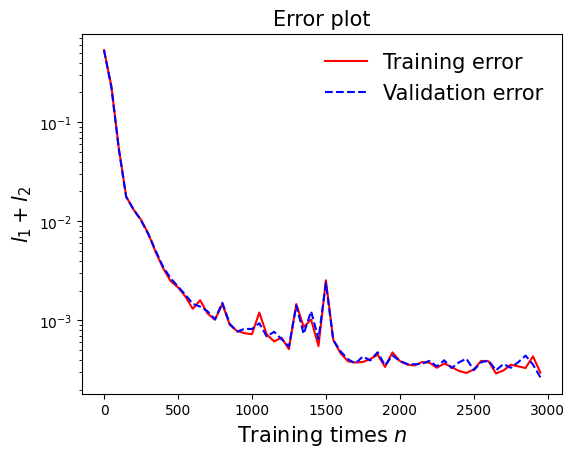

In [32]:
draw_loss(model)

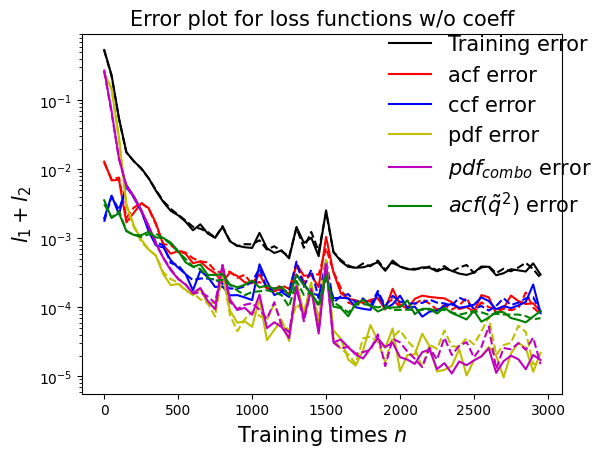

In [33]:
draw_errors(model)

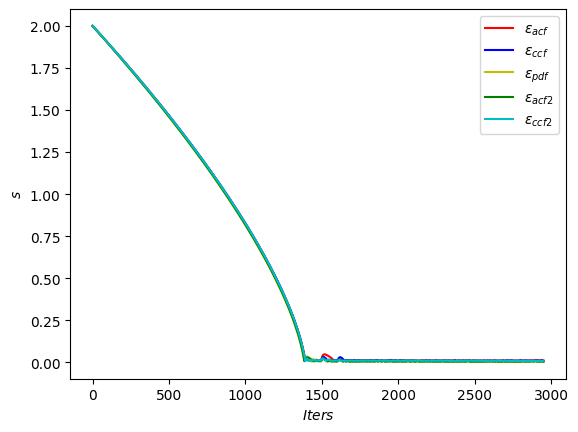

In [34]:
draw_adaptive_w(model)

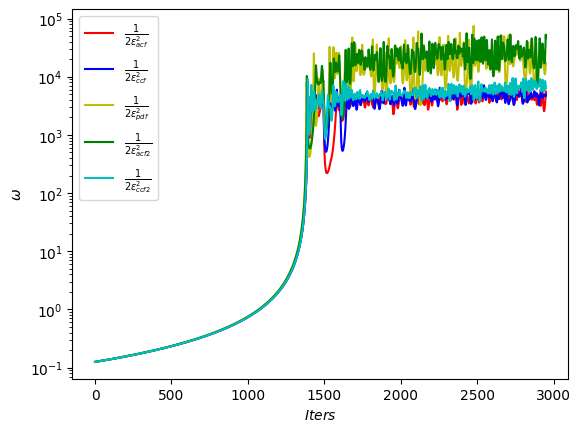

In [35]:
draw_epoch_w(model)

## Test 1: plot the sample path generated by SINN and the exact sample path 

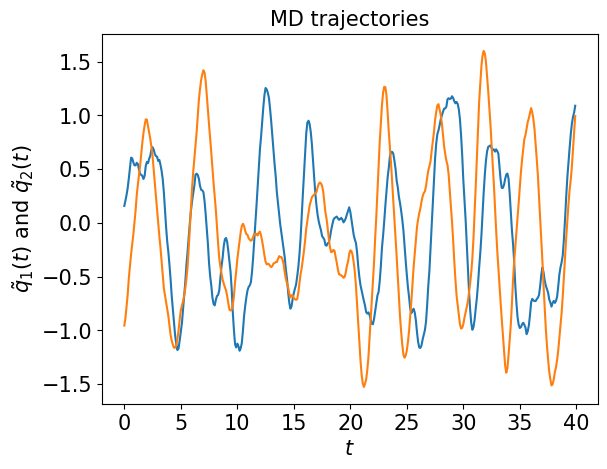

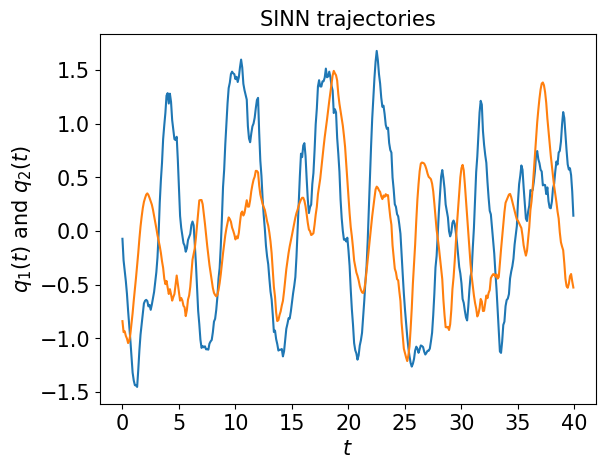

In [36]:
test1(model)

## Test 2: plot the CCF of the sample path generated by the SINN and the exact CCF

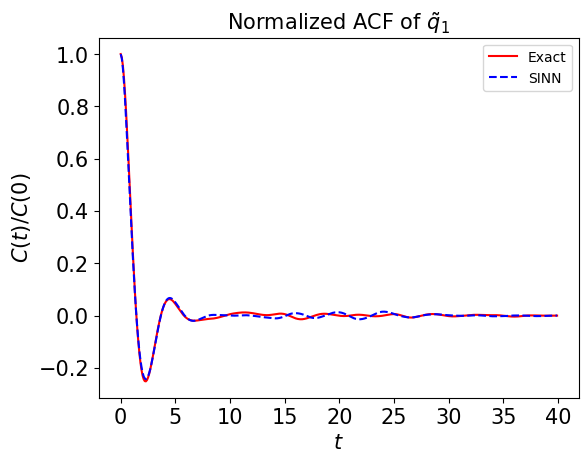

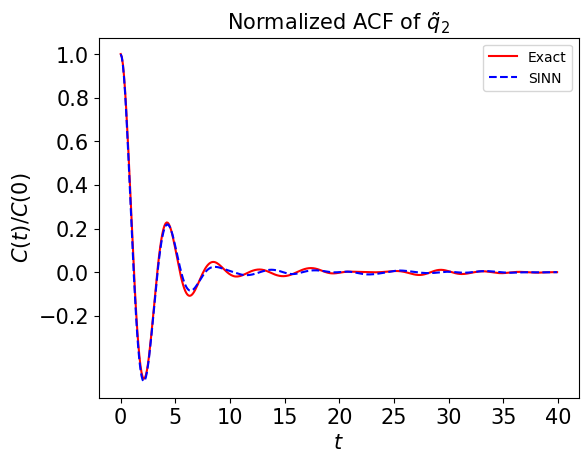

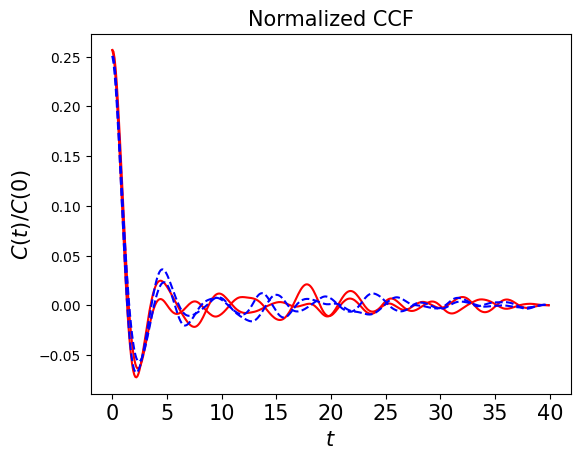

In [37]:
test2(model)

## Test 3: plot the PDF of the sample path generated by SINN and the exact PDF  

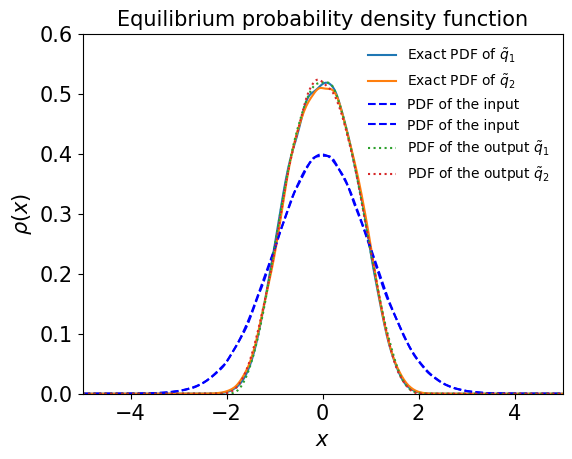

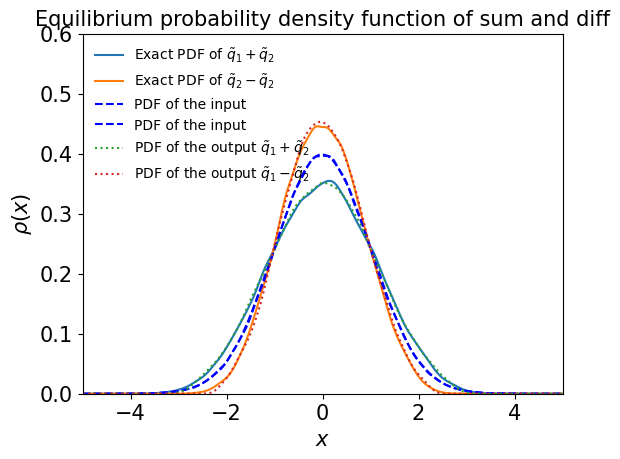

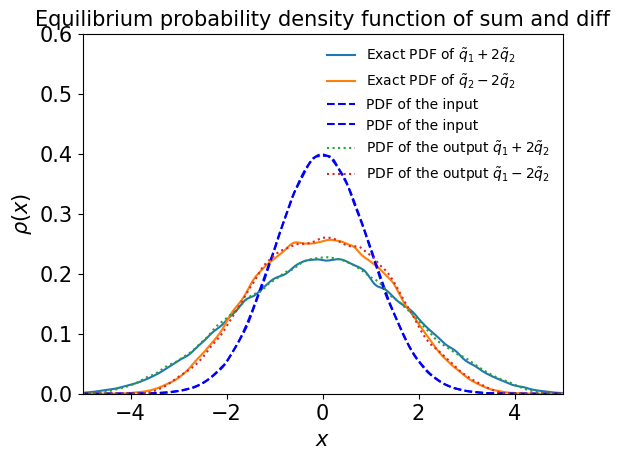

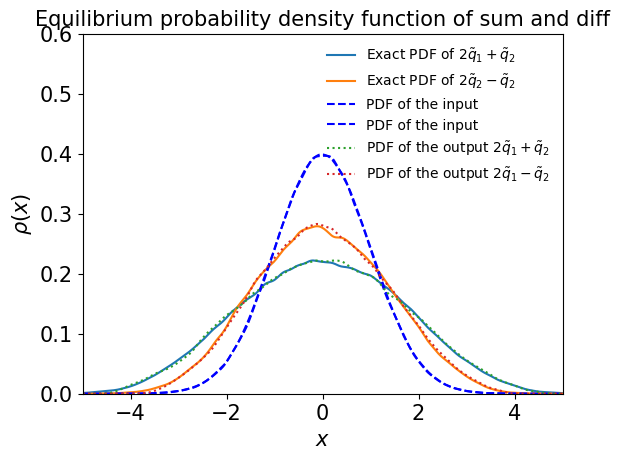

In [38]:
test3(model)

## Test 4: Comparing the higher-order ACF

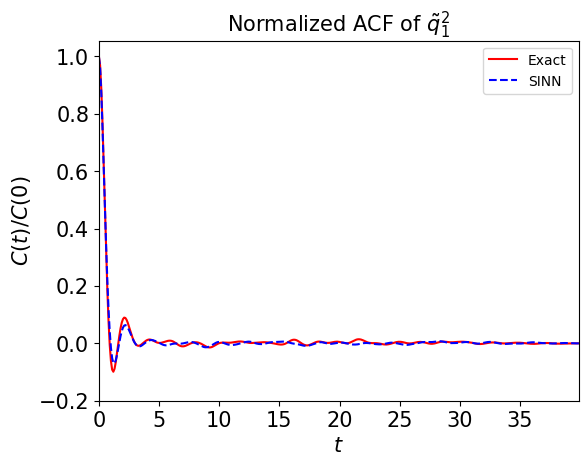

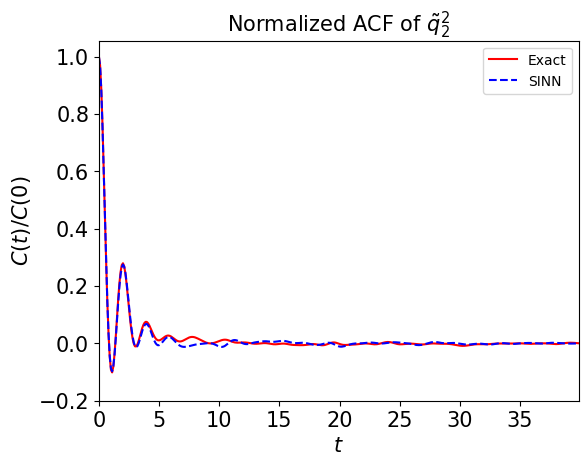

In [39]:
test4(model)

## Test 5: plot the expolation result, i.e. Prediction of the FPU-Langevin dynamics for longer time 

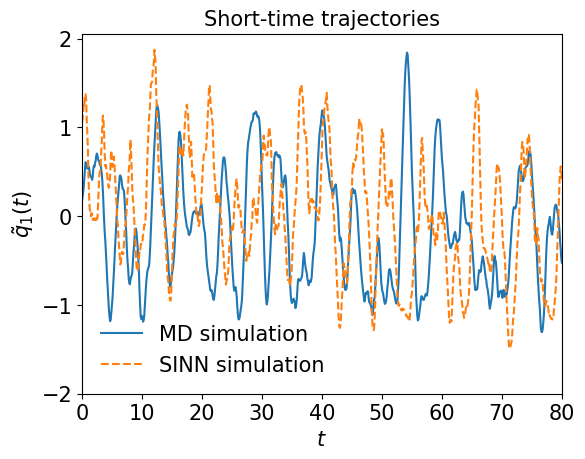

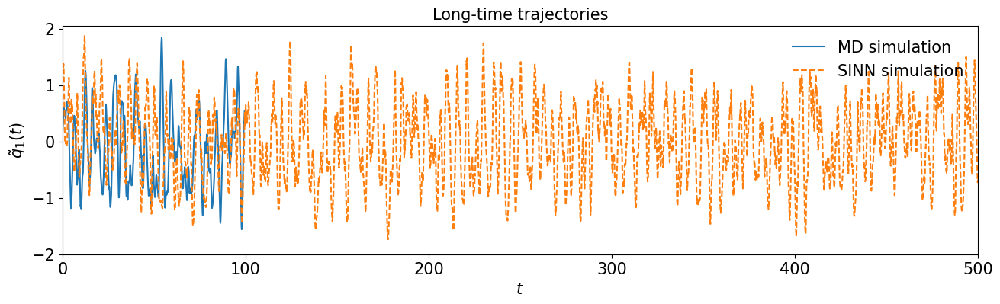

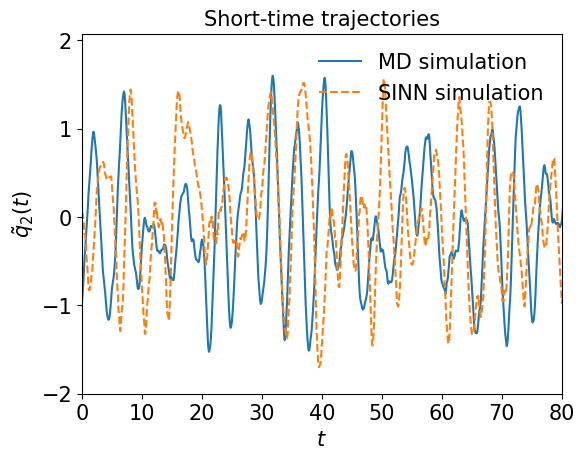

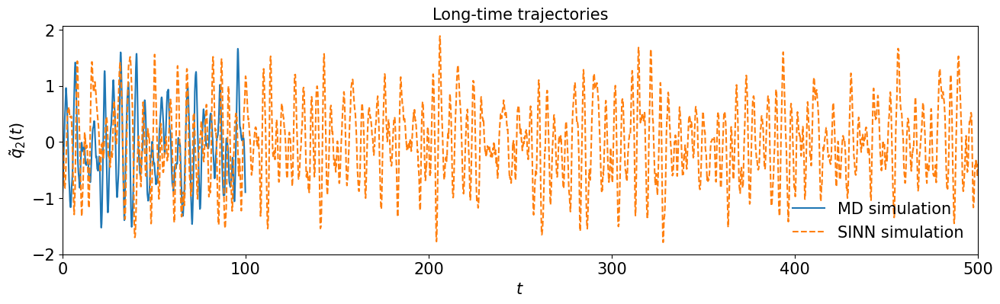

In [40]:
test5(model)

# Test 6: comparing scatter plots

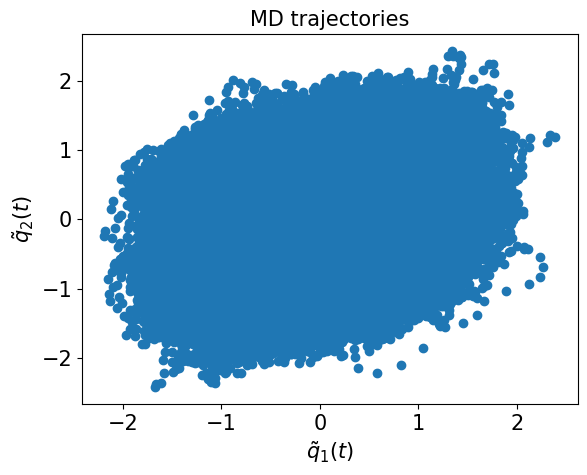

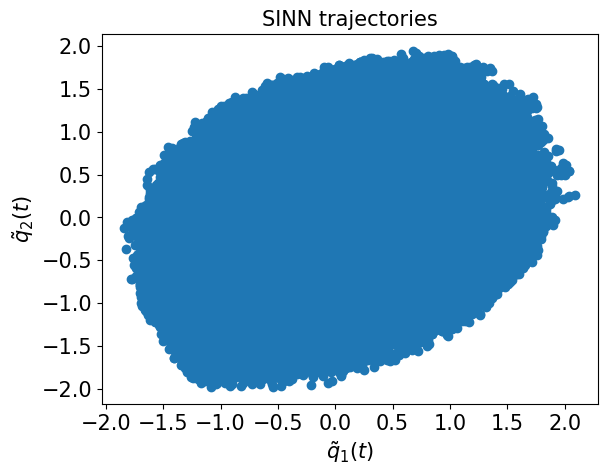

In [41]:
test6(model)

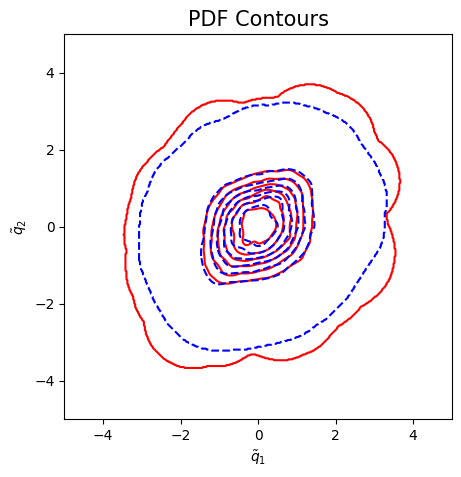

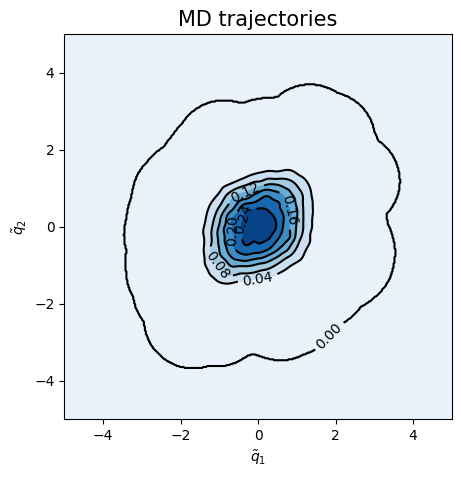

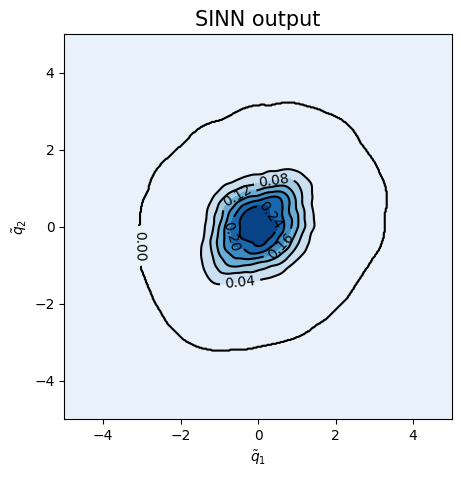

<Figure size 500x500 with 0 Axes>

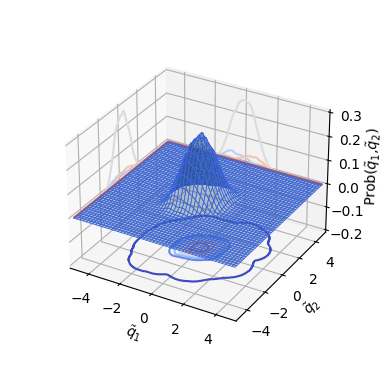

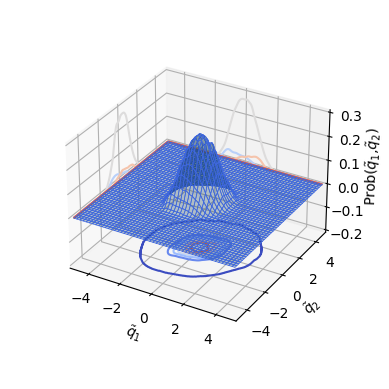

In [42]:
test7(model)

In [43]:
### Defining SINN model
net1 = SINN(2, 10, 2, 2).to(device)

In [44]:
model1 = Model(net=net1)

In [45]:
model1.train()

[0]-th step loss: 0.5255, 0.5243, acf: 0.00900, ccf: 0.00266, pdf: 0.24597, pdf2: 0.26523, acf2: 0.00146
[50]-th step loss: 0.1941, 0.1848, acf: 0.00631, ccf: 0.00652, pdf: 0.08042, pdf2: 0.09031, acf2: 0.00124
[100]-th step loss: 0.0579, 0.0574, acf: 0.00804, ccf: 0.01026, pdf: 0.00883, pdf2: 0.02899, acf2: 0.00125
[150]-th step loss: 0.0415, 0.0414, acf: 0.00593, ccf: 0.00757, pdf: 0.00438, pdf2: 0.02241, acf2: 0.00110
[200]-th step loss: 0.0315, 0.0317, acf: 0.00515, ccf: 0.00614, pdf: 0.00287, pdf2: 0.01634, acf2: 0.00118
[250]-th step loss: 0.0180, 0.0179, acf: 0.00309, ccf: 0.00606, pdf: 0.00205, pdf2: 0.00560, acf2: 0.00107
[300]-th step loss: 0.0128, 0.0126, acf: 0.00277, ccf: 0.00603, pdf: 0.00076, pdf2: 0.00213, acf2: 0.00095
[350]-th step loss: 0.0107, 0.0109, acf: 0.00269, ccf: 0.00577, pdf: 0.00040, pdf2: 0.00122, acf2: 0.00086
[400]-th step loss: 0.0092, 0.0093, acf: 0.00262, ccf: 0.00463, pdf: 0.00032, pdf2: 0.00083, acf2: 0.00093
[450]-th step loss: 0.0069, 0.0071, acf:

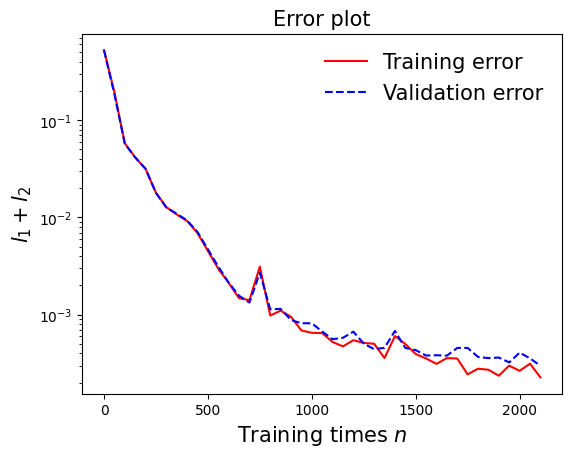

In [46]:
draw_loss(model1)

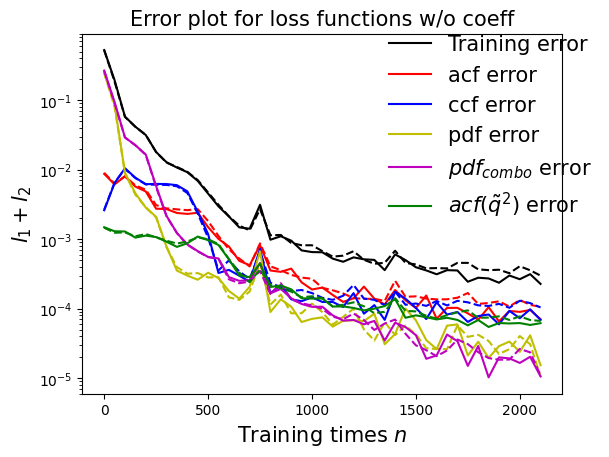

In [47]:
draw_errors(model1)

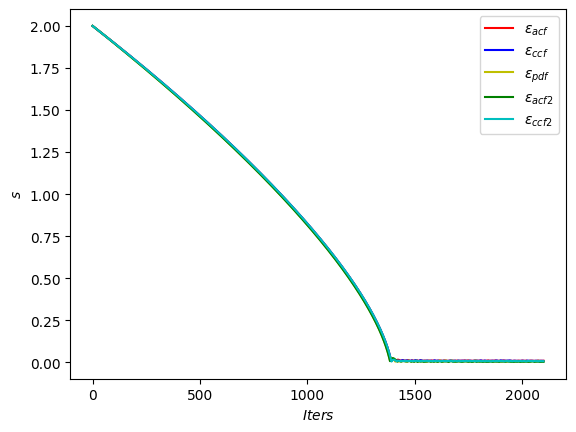

In [48]:
draw_adaptive_w(model1)

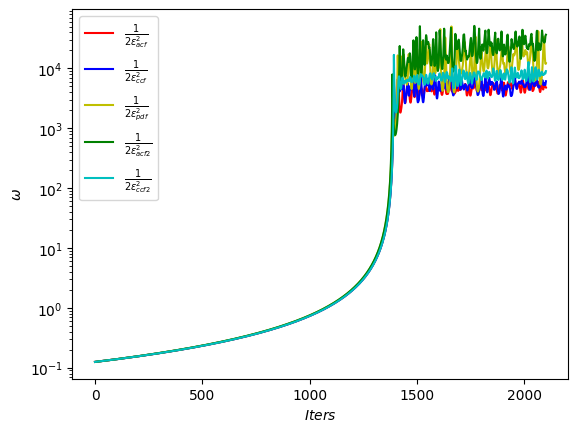

In [49]:
draw_epoch_w(model1)

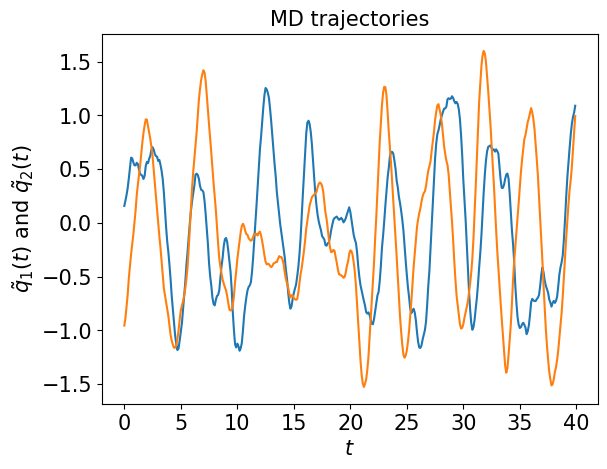

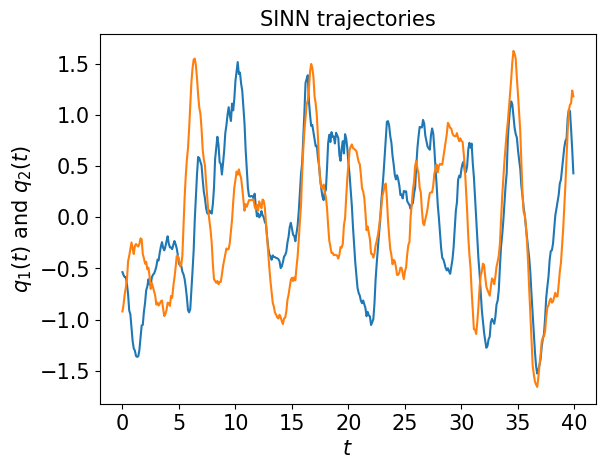

In [50]:
test1(model1)

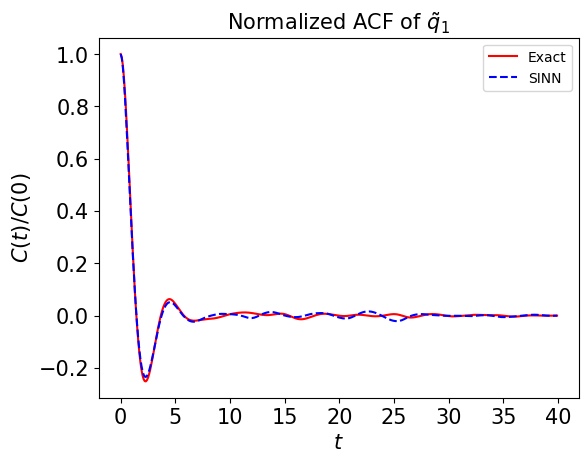

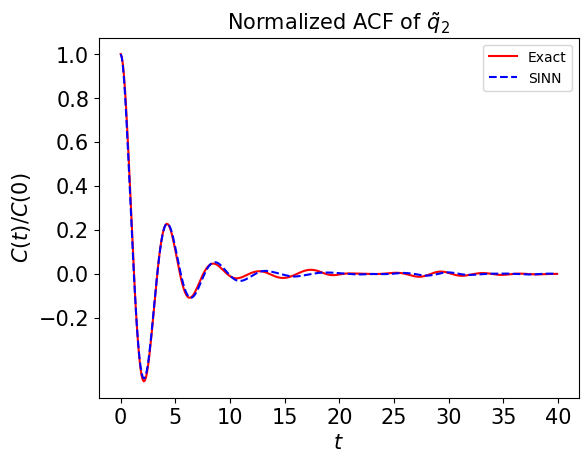

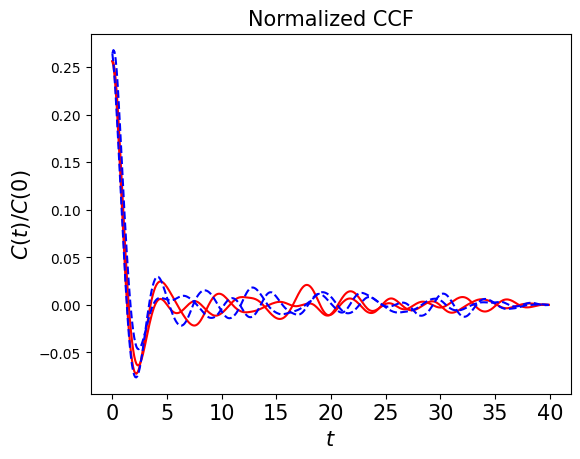

In [51]:
test2(model1)

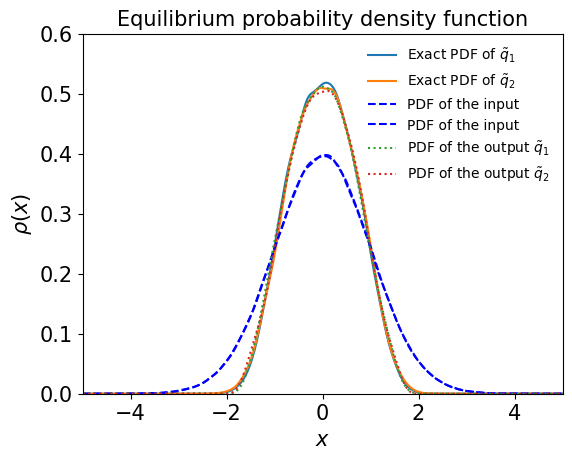

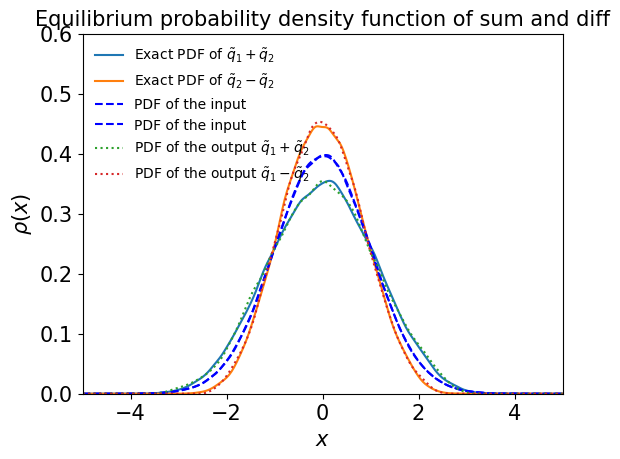

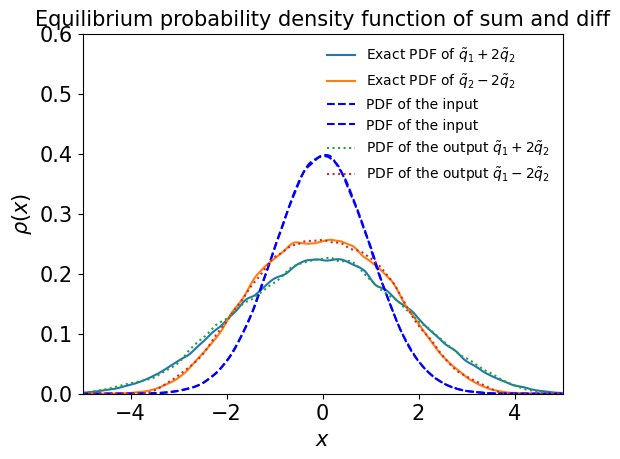

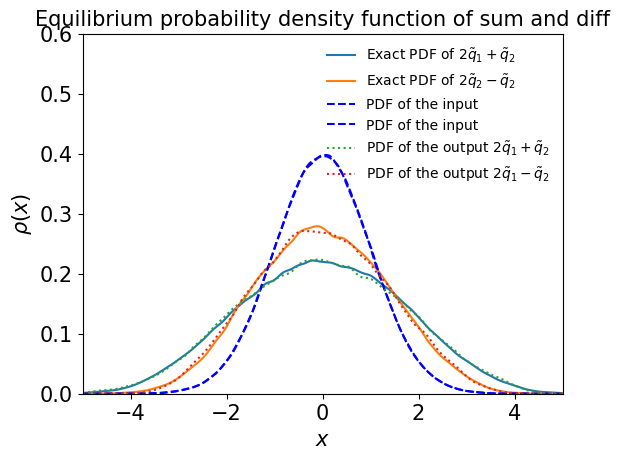

In [52]:
test3(model1)

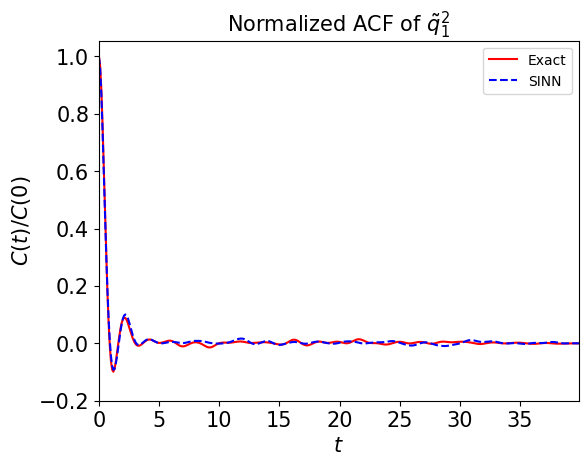

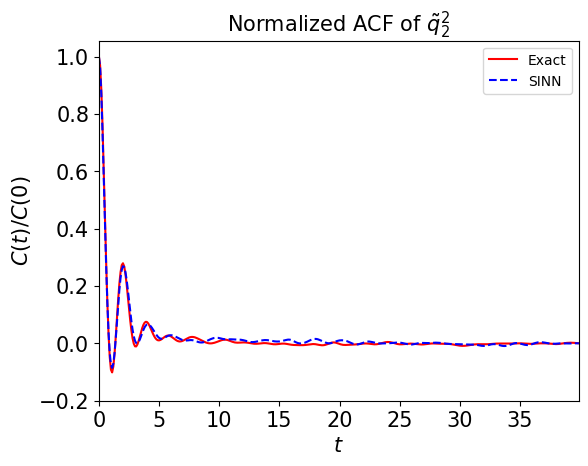

In [53]:
test4(model1)

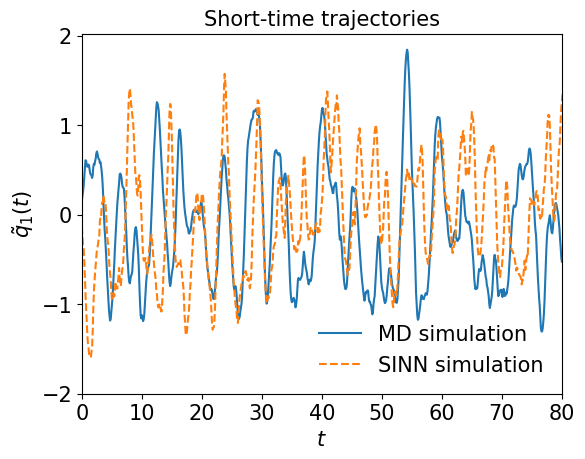

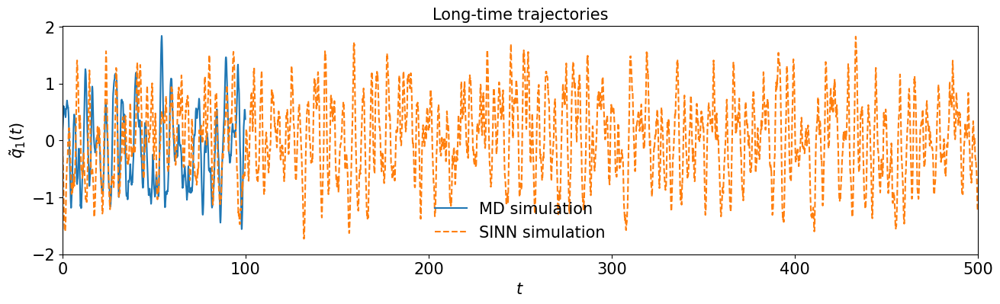

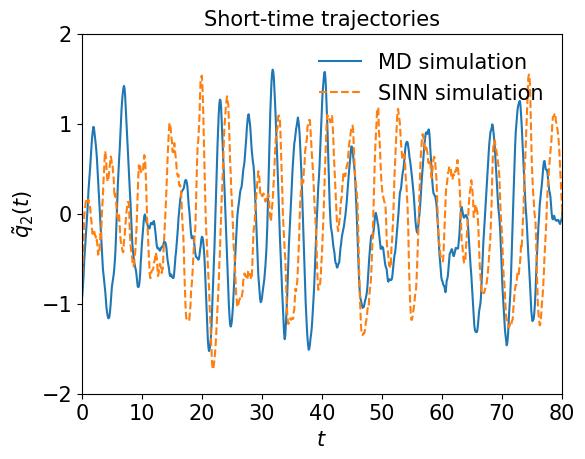

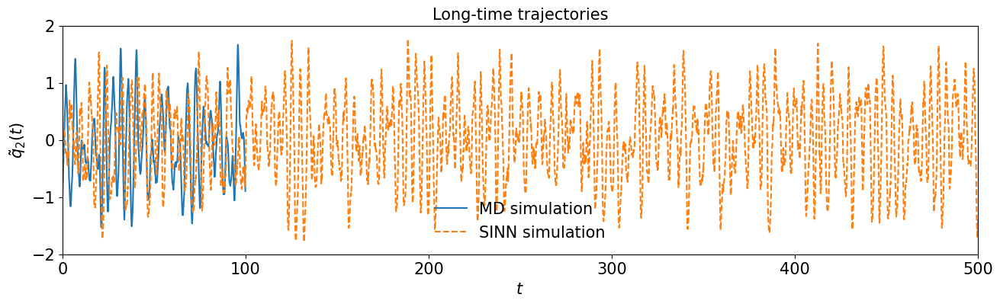

In [54]:
test5(model1)

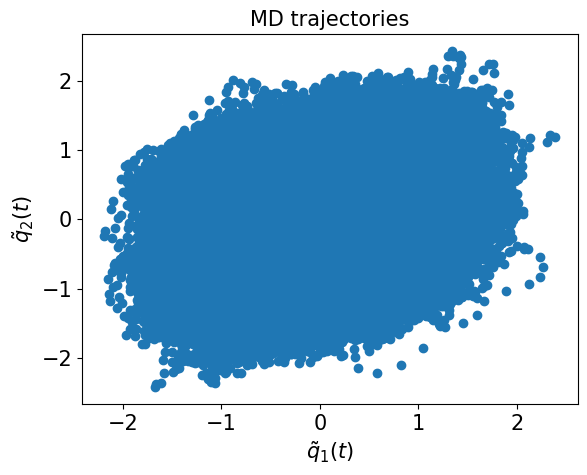

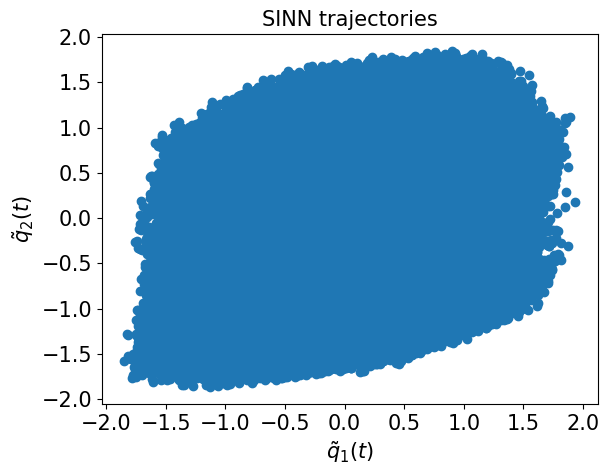

In [55]:
test6(model1)

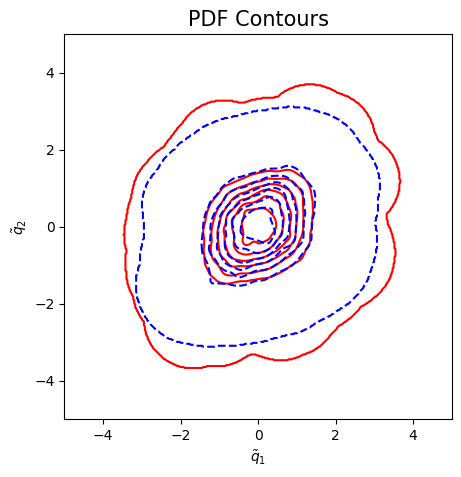

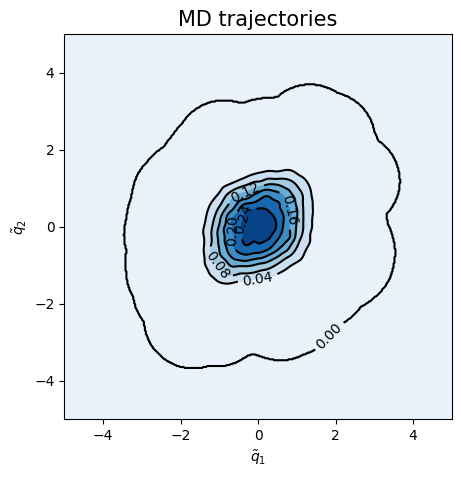

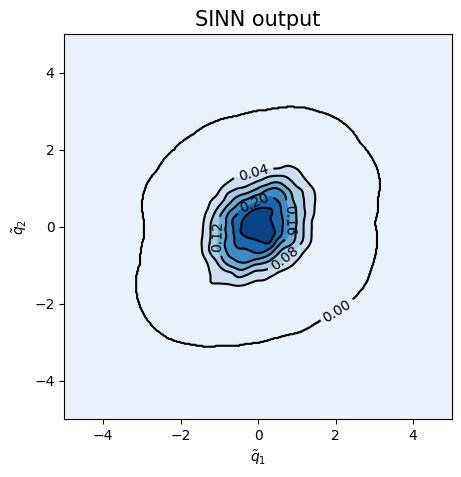

<Figure size 500x500 with 0 Axes>

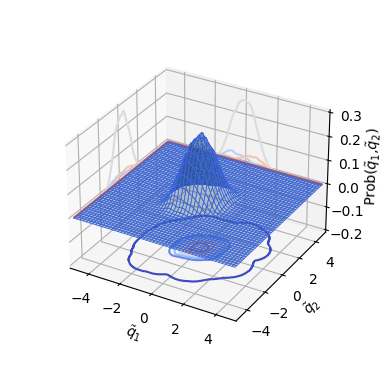

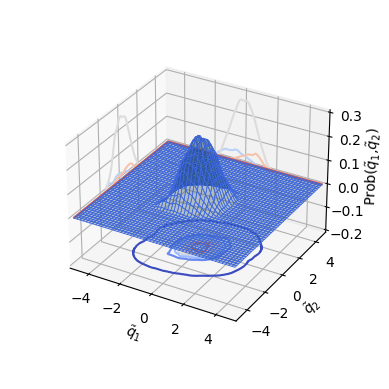

In [56]:
test7(model1)

In [57]:
### Defining SINN model
net2 = SINN(2, 10, 2, 2).to(device)

In [58]:
model2 = Model(net=net2)

In [59]:
model2.train()

[0]-th step loss: 0.5369, 0.5363, acf: 0.01142, ccf: 0.00766, pdf: 0.24591, pdf2: 0.26865, acf2: 0.00269
[50]-th step loss: 0.2802, 0.2683, acf: 0.00654, ccf: 0.01839, pdf: 0.13802, pdf2: 0.10366, acf2: 0.00166
[100]-th step loss: 0.0603, 0.0594, acf: 0.00651, ccf: 0.01861, pdf: 0.01564, pdf2: 0.01728, acf2: 0.00138
[150]-th step loss: 0.0282, 0.0279, acf: 0.00674, ccf: 0.00948, pdf: 0.00483, pdf2: 0.00546, acf2: 0.00139
[200]-th step loss: 0.0172, 0.0175, acf: 0.00597, ccf: 0.00519, pdf: 0.00254, pdf2: 0.00252, acf2: 0.00128
[250]-th step loss: 0.0130, 0.0129, acf: 0.00505, ccf: 0.00363, pdf: 0.00116, pdf2: 0.00174, acf2: 0.00130
[300]-th step loss: 0.0097, 0.0096, acf: 0.00236, ccf: 0.00216, pdf: 0.00145, pdf2: 0.00212, acf2: 0.00153
[350]-th step loss: 0.0059, 0.0060, acf: 0.00139, ccf: 0.00154, pdf: 0.00085, pdf2: 0.00149, acf2: 0.00073
[400]-th step loss: 0.0077, 0.0078, acf: 0.00195, ccf: 0.00048, pdf: 0.00219, pdf2: 0.00230, acf2: 0.00093
[450]-th step loss: 0.0032, 0.0035, acf:

[3850]-th step loss: 0.0003, 0.0003, acf: 0.00012, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00011
[3900]-th step loss: 0.0004, 0.0004, acf: 0.00014, ccf: 0.00010, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00011
[3950]-th step loss: 0.0004, 0.0004, acf: 0.00013, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00014
[4000]-th step loss: 0.0132, 0.0129, acf: 0.00278, ccf: 0.00544, pdf: 0.00281, pdf2: 0.00140, acf2: 0.00051
[4050]-th step loss: 0.0085, 0.0082, acf: 0.00166, ccf: 0.00469, pdf: 0.00096, pdf2: 0.00034, acf2: 0.00055
[4100]-th step loss: 0.0069, 0.0070, acf: 0.00132, ccf: 0.00425, pdf: 0.00066, pdf2: 0.00028, acf2: 0.00044
[4150]-th step loss: 0.0051, 0.0055, acf: 0.00099, ccf: 0.00356, pdf: 0.00039, pdf2: 0.00016, acf2: 0.00040
[4200]-th step loss: 0.0046, 0.0046, acf: 0.00087, ccf: 0.00311, pdf: 0.00021, pdf2: 0.00010, acf2: 0.00035
[4250]-th step loss: 0.0035, 0.0036, acf: 0.00064, ccf: 0.00251, pdf: 0.00012, pdf2: 0.00007, acf2: 0.00029
[4300]-th step loss: 0.0029,

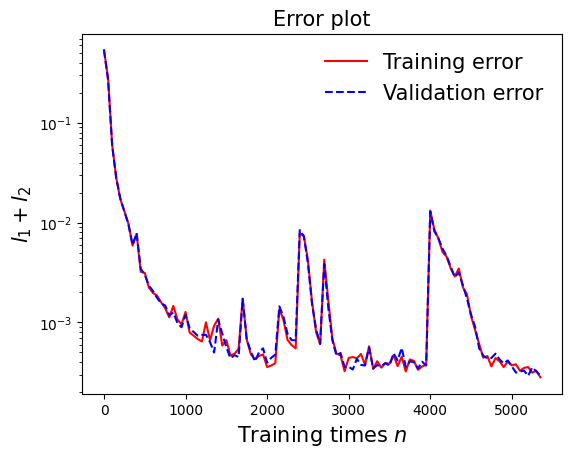

In [60]:
draw_loss(model2)

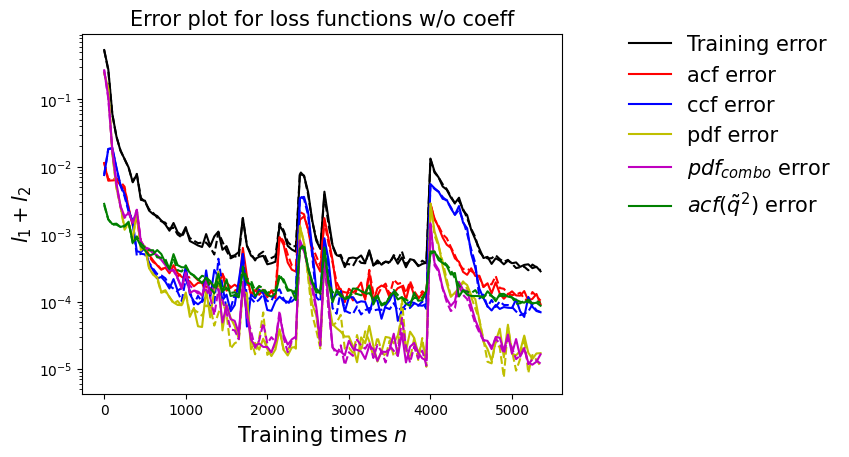

In [61]:
draw_errors(model2)

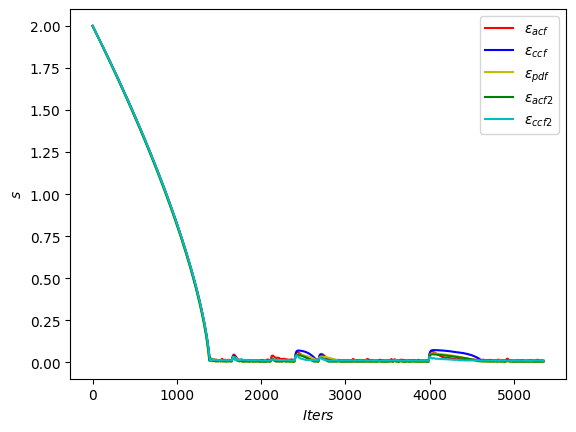

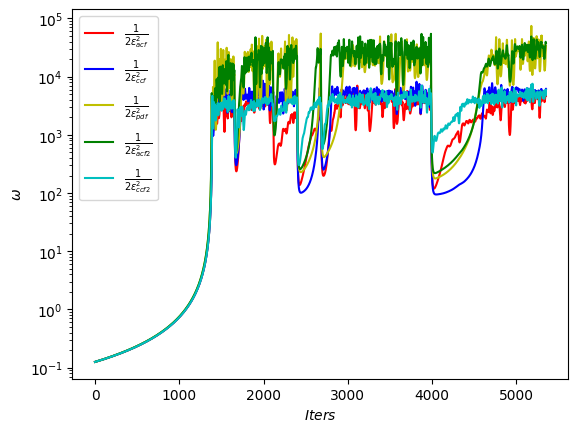

In [62]:
draw_adaptive_w(model2)
draw_epoch_w(model2)

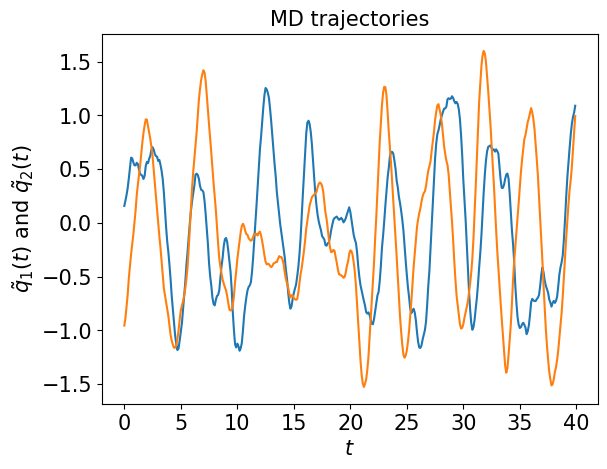

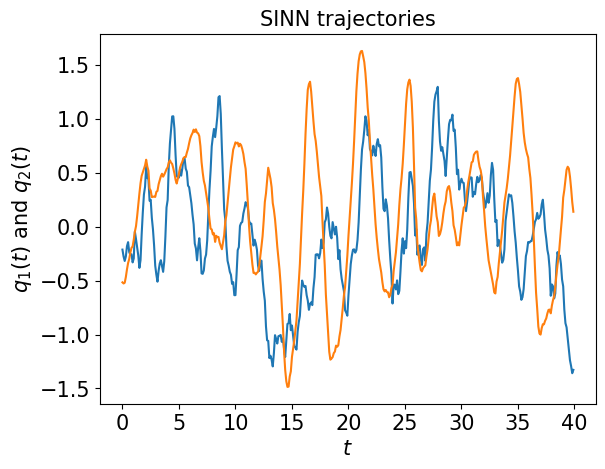

In [63]:
test1(model2)

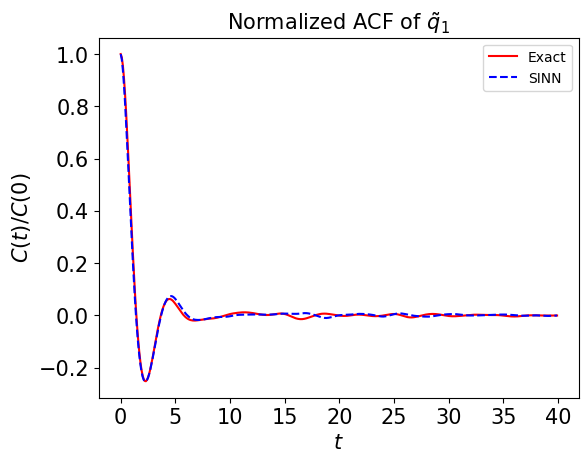

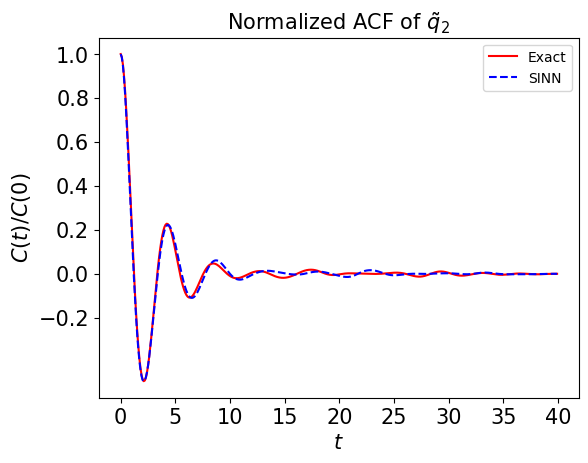

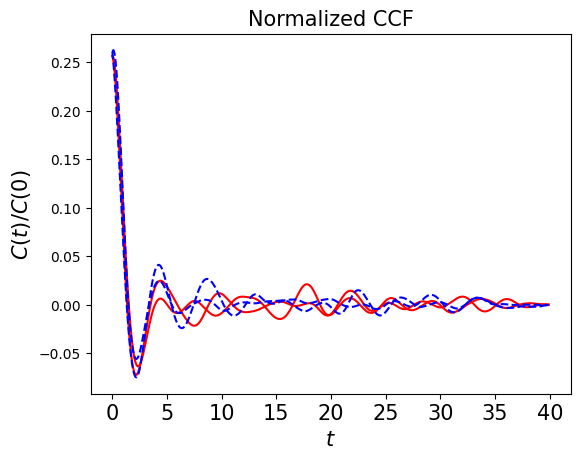

In [64]:
test2(model2)

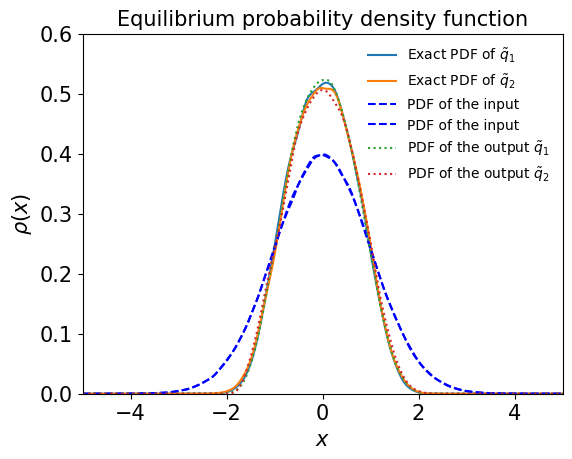

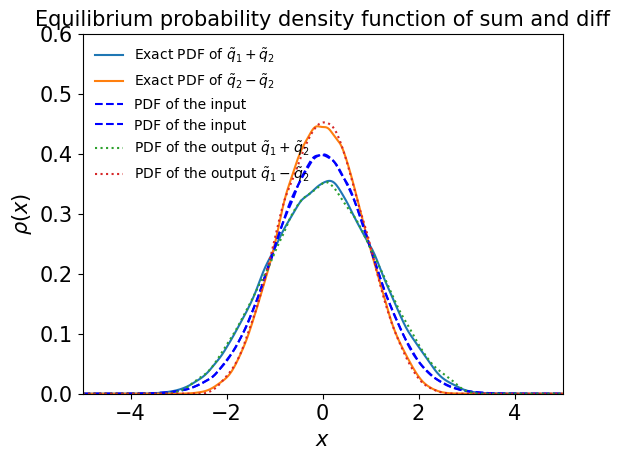

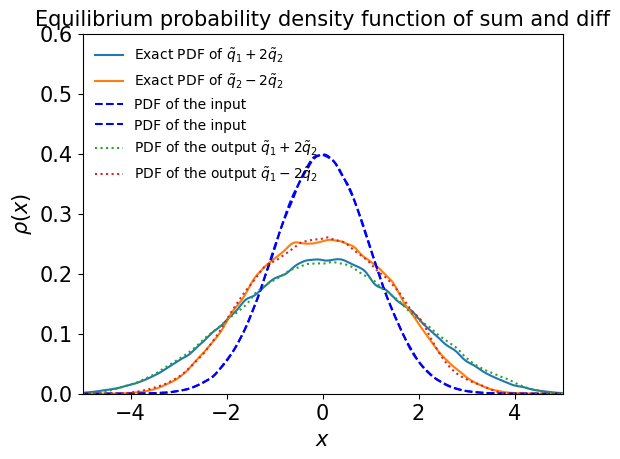

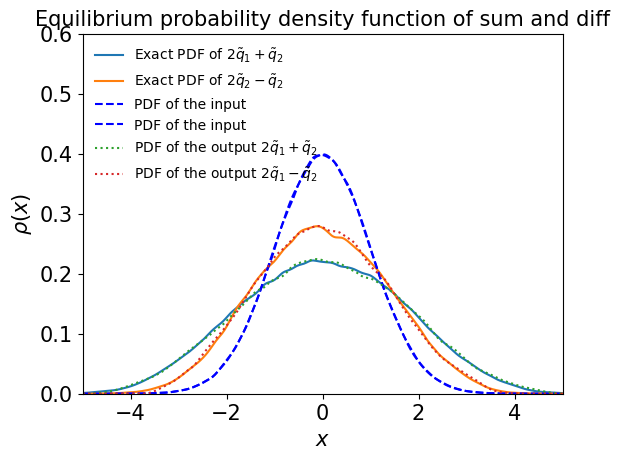

In [65]:
test3(model2)

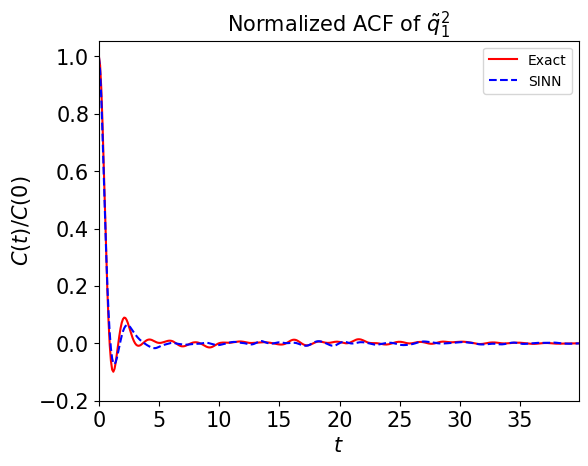

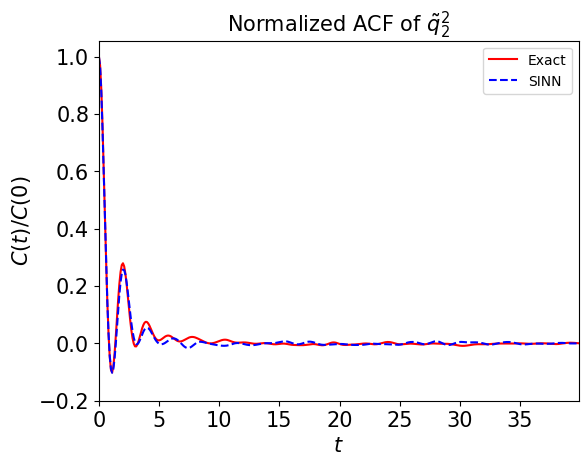

In [66]:
test4(model2)

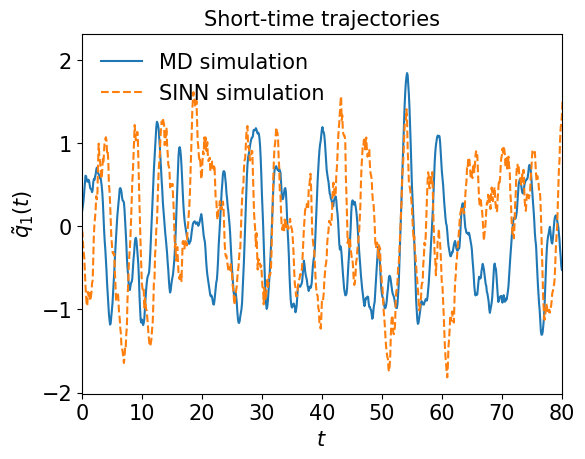

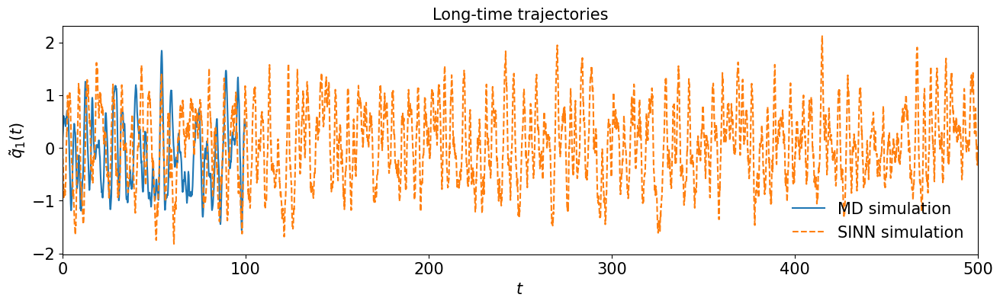

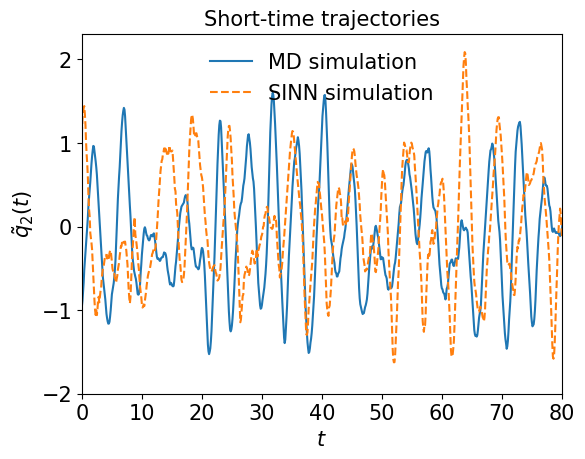

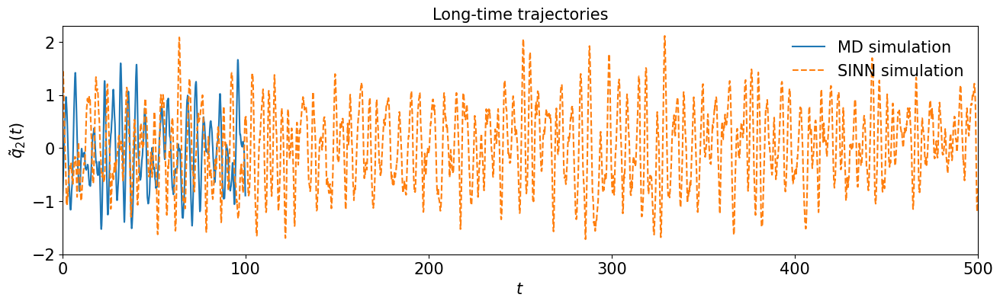

In [67]:
test5(model2)

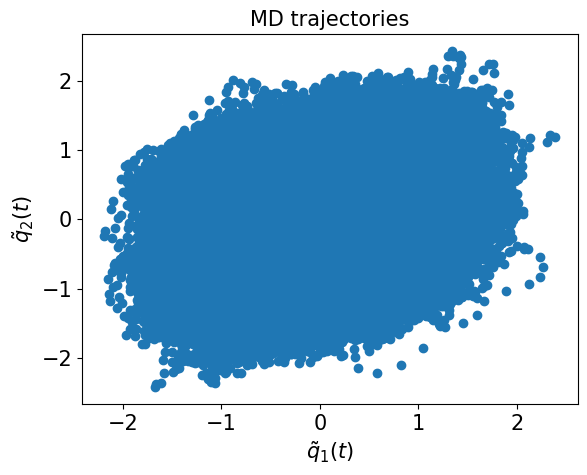

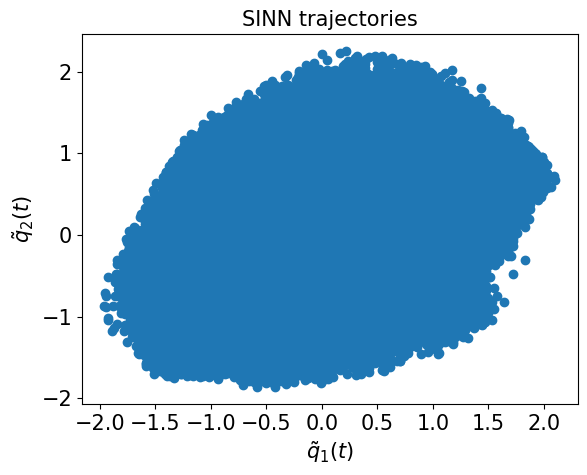

In [68]:
test6(model2)

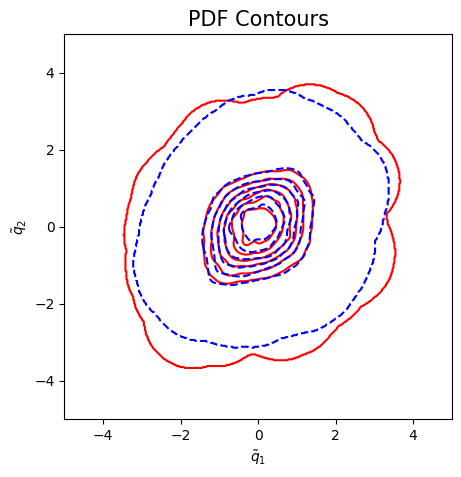

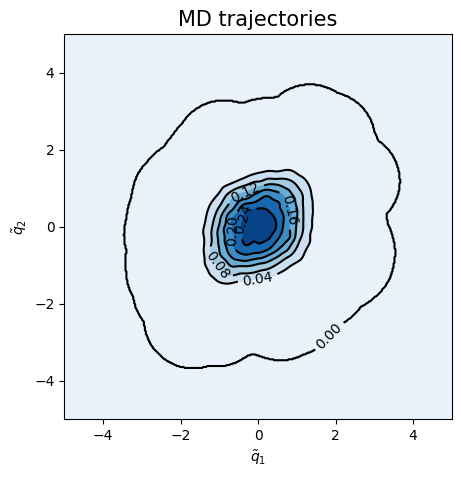

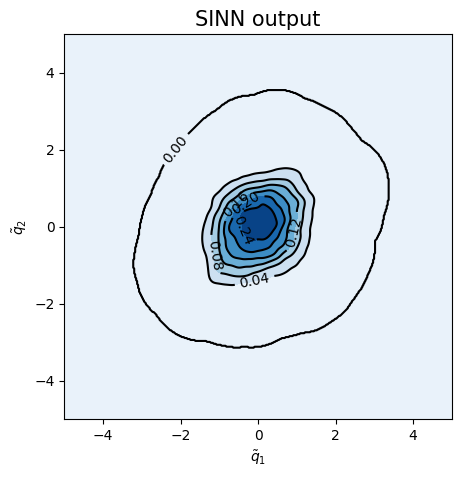

<Figure size 500x500 with 0 Axes>

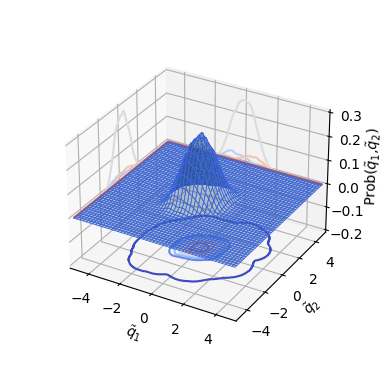

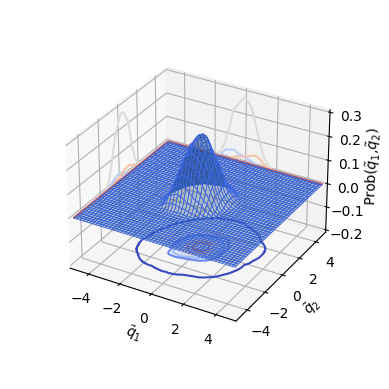

In [69]:
test7(model2)

In [70]:
### Defining SINN model
net3 = SINN(2, 10, 2, 2).to(device)

In [71]:
model3 = Model(net=net3)

In [72]:
model3.train()

[0]-th step loss: 0.5299, 0.5291, acf: 0.01176, ccf: 0.00088, pdf: 0.24636, pdf2: 0.26726, acf2: 0.00281
[50]-th step loss: 0.2512, 0.2430, acf: 0.00857, ccf: 0.00112, pdf: 0.14590, pdf2: 0.08536, acf2: 0.00203
[100]-th step loss: 0.0464, 0.0449, acf: 0.00970, ccf: 0.00303, pdf: 0.02161, pdf2: 0.00835, acf2: 0.00219
[150]-th step loss: 0.0151, 0.0151, acf: 0.00841, ccf: 0.00078, pdf: 0.00213, pdf2: 0.00262, acf2: 0.00118
[200]-th step loss: 0.0114, 0.0116, acf: 0.00661, ccf: 0.00083, pdf: 0.00121, pdf2: 0.00193, acf2: 0.00102
[250]-th step loss: 0.0094, 0.0096, acf: 0.00558, ccf: 0.00068, pdf: 0.00084, pdf2: 0.00153, acf2: 0.00100
[300]-th step loss: 0.0068, 0.0070, acf: 0.00352, ccf: 0.00065, pdf: 0.00066, pdf2: 0.00121, acf2: 0.00092
[350]-th step loss: 0.0036, 0.0038, acf: 0.00172, ccf: 0.00045, pdf: 0.00037, pdf2: 0.00067, acf2: 0.00060
[400]-th step loss: 0.0027, 0.0027, acf: 0.00129, ccf: 0.00024, pdf: 0.00022, pdf2: 0.00040, acf2: 0.00050
[450]-th step loss: 0.0020, 0.0019, acf:

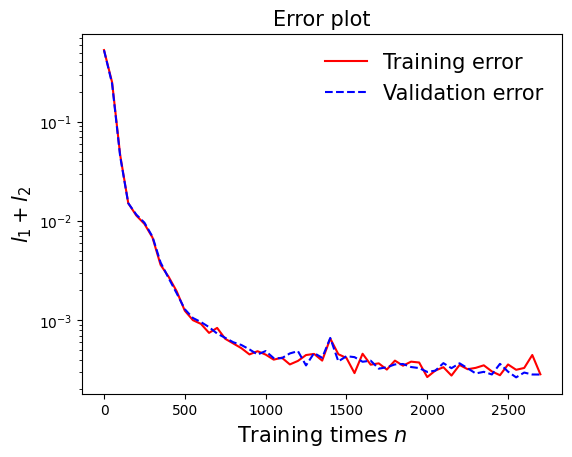

In [73]:
draw_loss(model3)

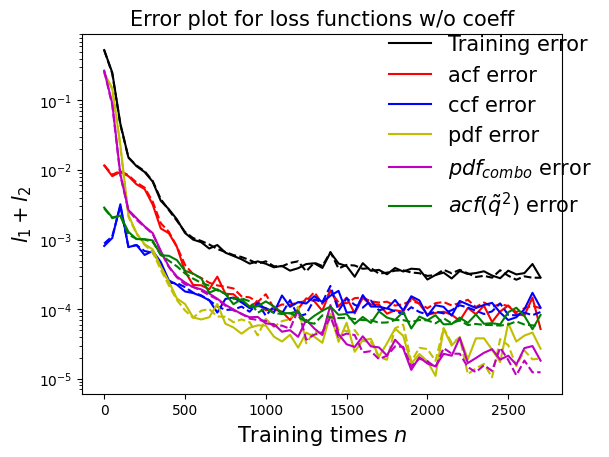

In [74]:
draw_errors(model3)

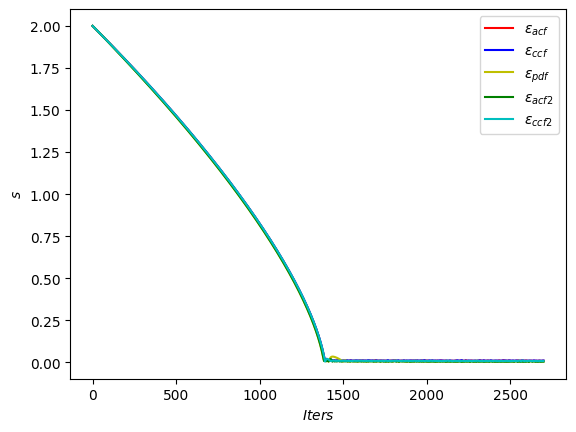

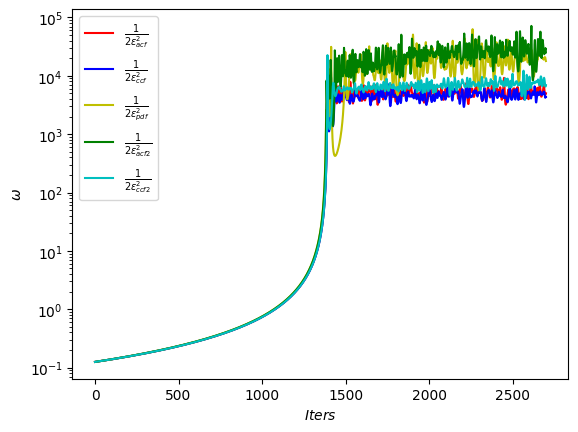

In [75]:
draw_adaptive_w(model3)
draw_epoch_w(model3)

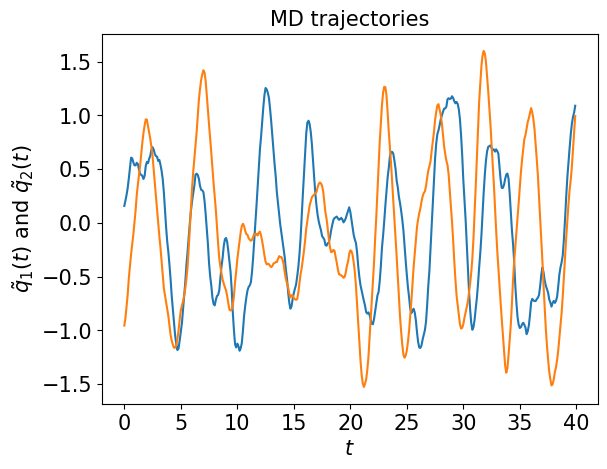

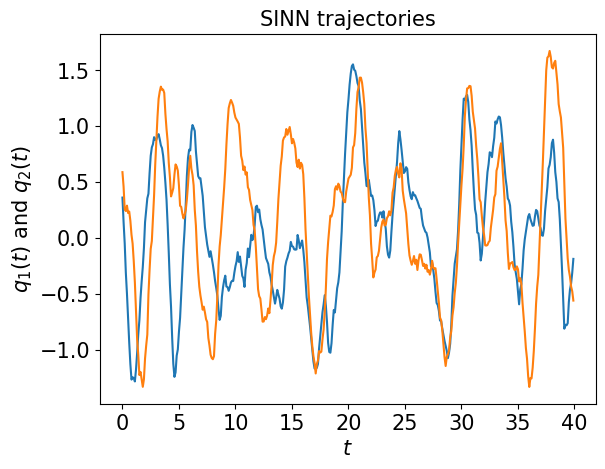

In [76]:
test1(model3)

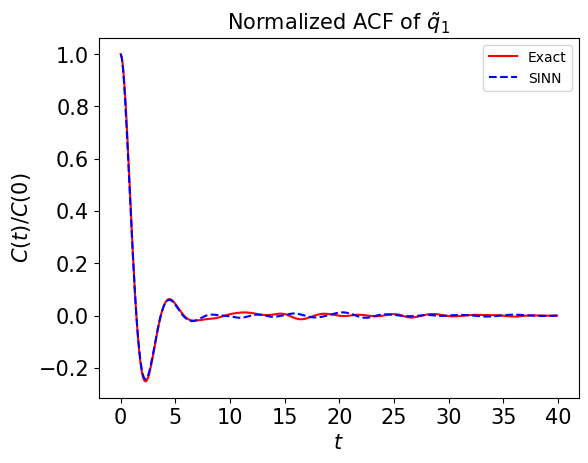

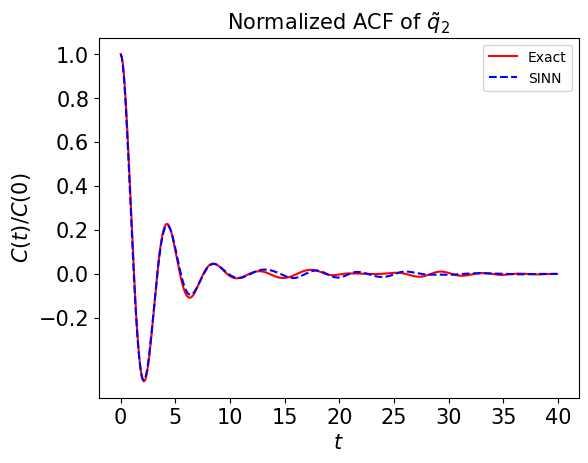

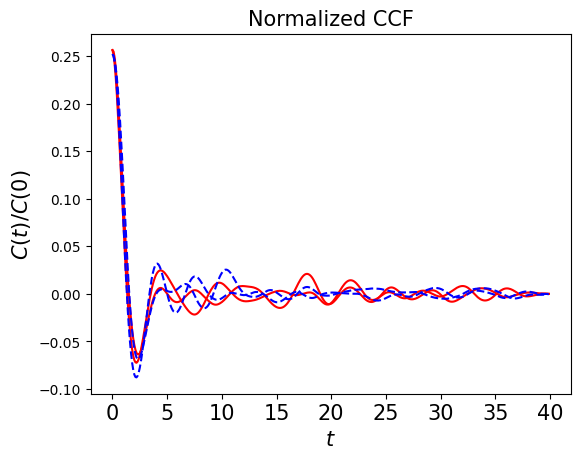

In [77]:
test2(model3)

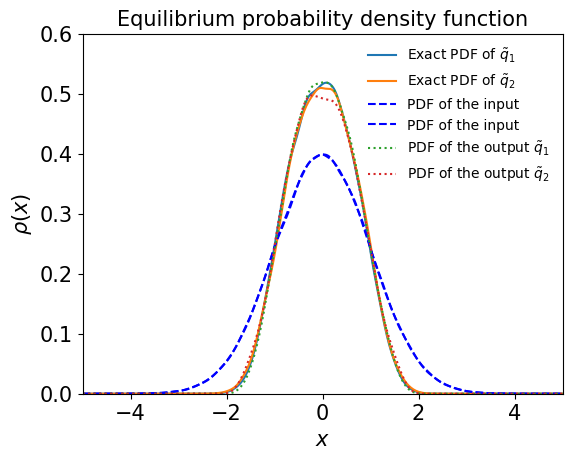

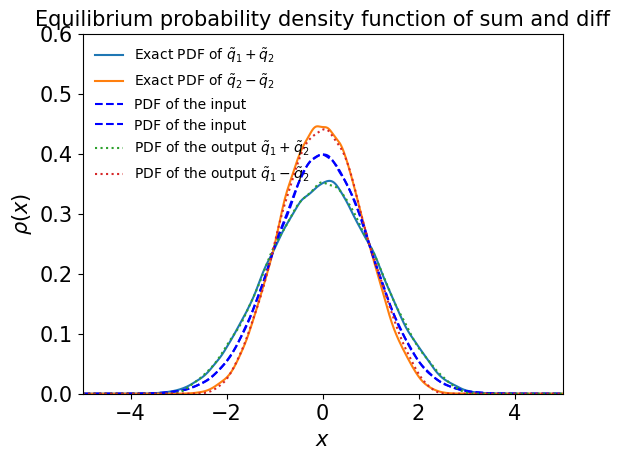

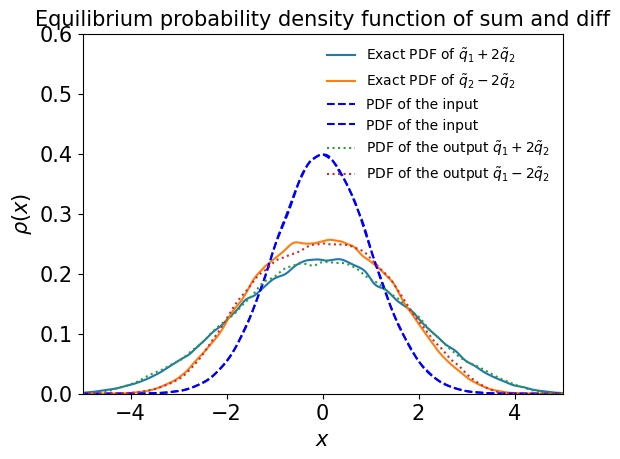

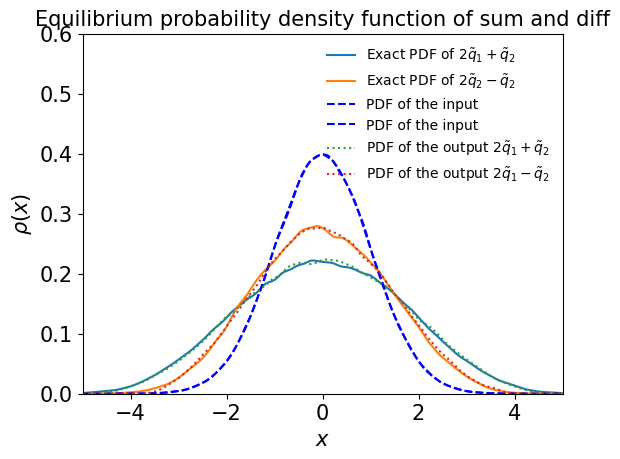

In [78]:
test3(model3)

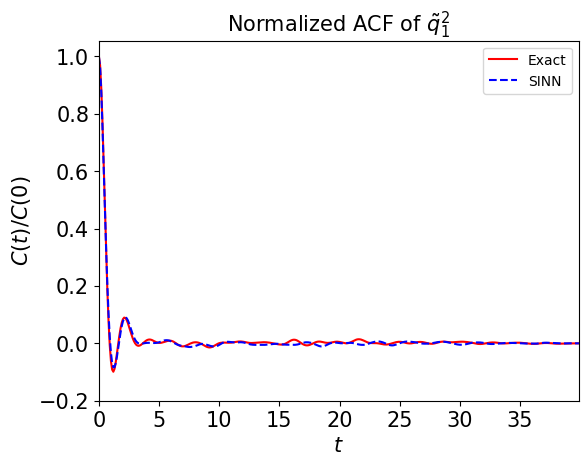

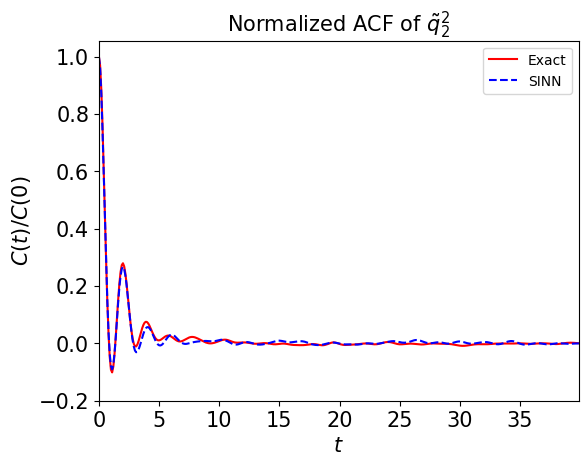

In [79]:
test4(model3)

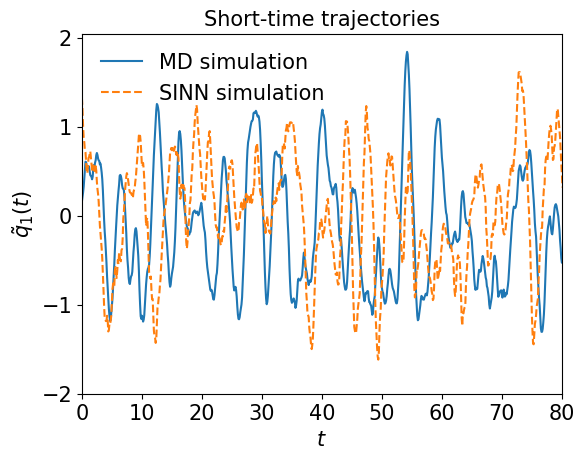

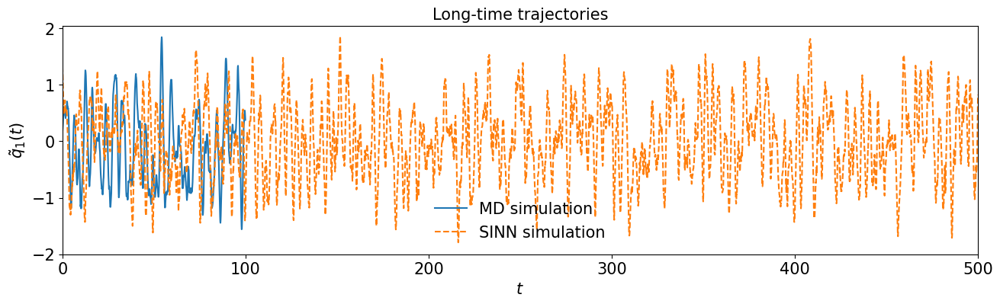

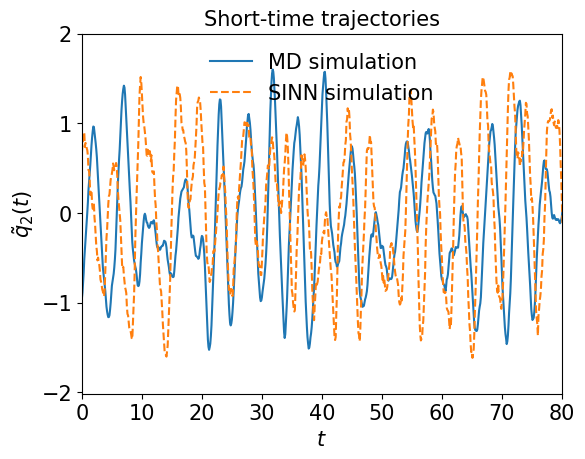

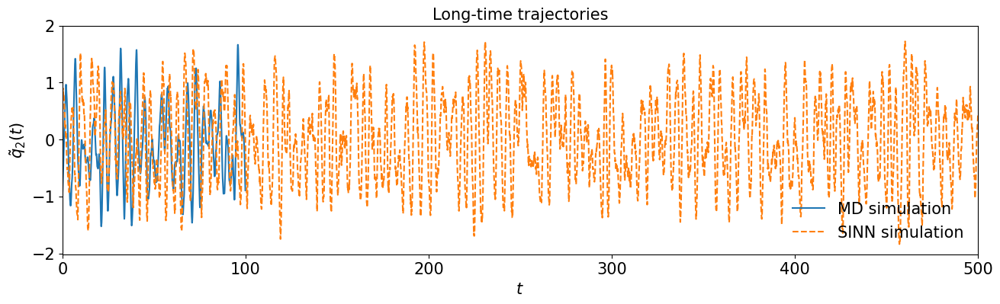

In [80]:
test5(model3)

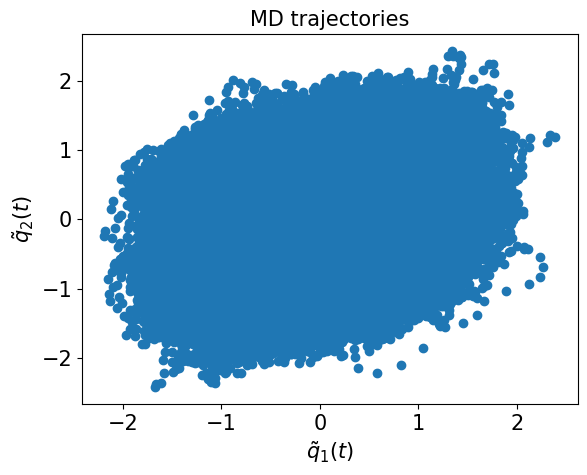

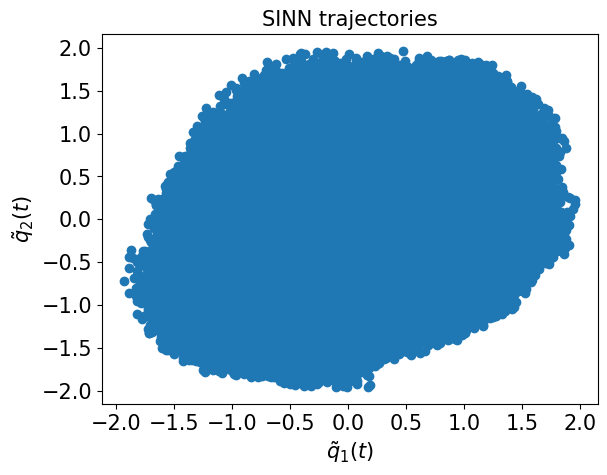

In [81]:
test6(model3)

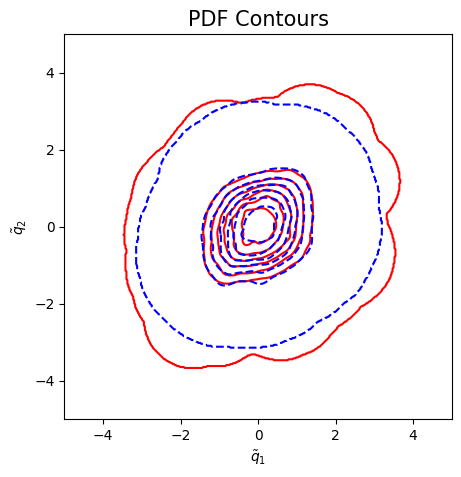

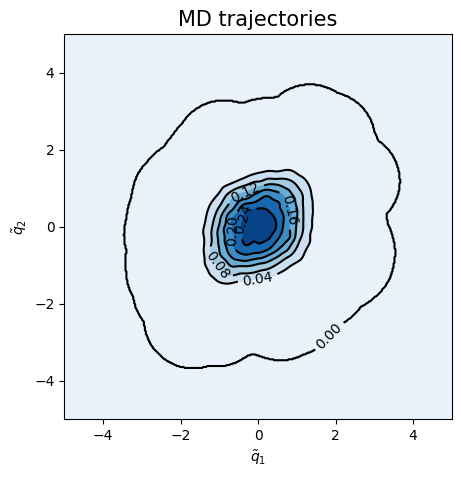

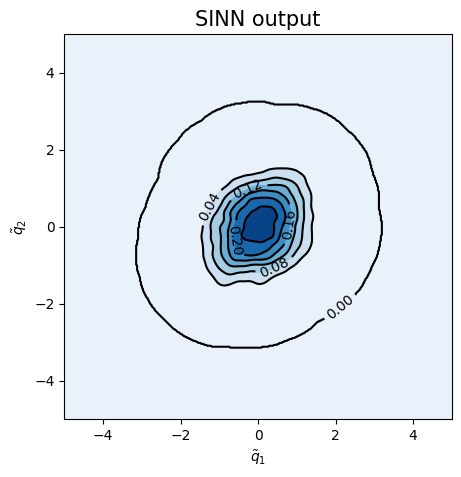

<Figure size 500x500 with 0 Axes>

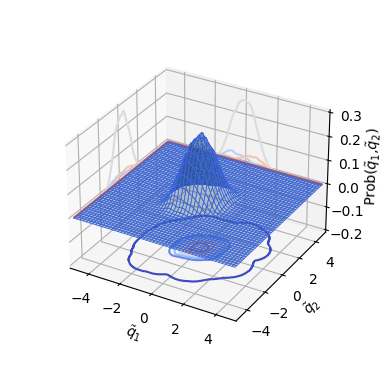

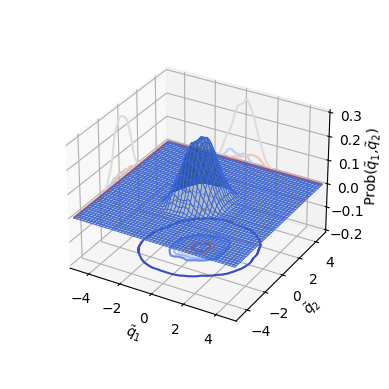

In [82]:
test7(model3)

In [83]:
### Defining SINN model
net4 = SINN(2, 10, 2, 2).to(device)

In [84]:
model4 = Model(net=net4)

In [85]:
model4.train()

[0]-th step loss: 0.5277, 0.5270, acf: 0.01050, ccf: 0.00166, pdf: 0.24505, pdf2: 0.26756, acf2: 0.00227
[50]-th step loss: 0.2841, 0.2742, acf: 0.00644, ccf: 0.00116, pdf: 0.15894, pdf2: 0.10575, acf2: 0.00193
[100]-th step loss: 0.0310, 0.0305, acf: 0.00308, ccf: 0.00618, pdf: 0.01091, pdf2: 0.00813, acf2: 0.00220
[150]-th step loss: 0.0178, 0.0179, acf: 0.00318, ccf: 0.00499, pdf: 0.00424, pdf2: 0.00388, acf2: 0.00159
[200]-th step loss: 0.0134, 0.0133, acf: 0.00480, ccf: 0.00261, pdf: 0.00215, pdf2: 0.00278, acf2: 0.00099
[250]-th step loss: 0.0108, 0.0111, acf: 0.00497, ccf: 0.00156, pdf: 0.00143, pdf2: 0.00216, acf2: 0.00095
[300]-th step loss: 0.0091, 0.0091, acf: 0.00447, ccf: 0.00095, pdf: 0.00107, pdf2: 0.00162, acf2: 0.00098
[350]-th step loss: 0.0073, 0.0076, acf: 0.00413, ccf: 0.00049, pdf: 0.00079, pdf2: 0.00117, acf2: 0.00099
[400]-th step loss: 0.0063, 0.0065, acf: 0.00380, ccf: 0.00032, pdf: 0.00058, pdf2: 0.00083, acf2: 0.00097
[450]-th step loss: 0.0056, 0.0057, acf:

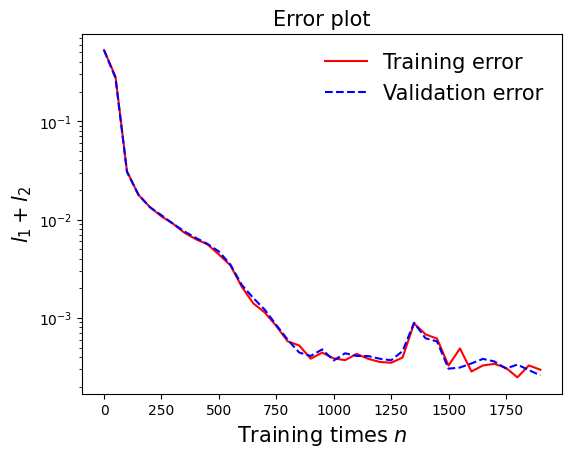

In [86]:
draw_loss(model4)

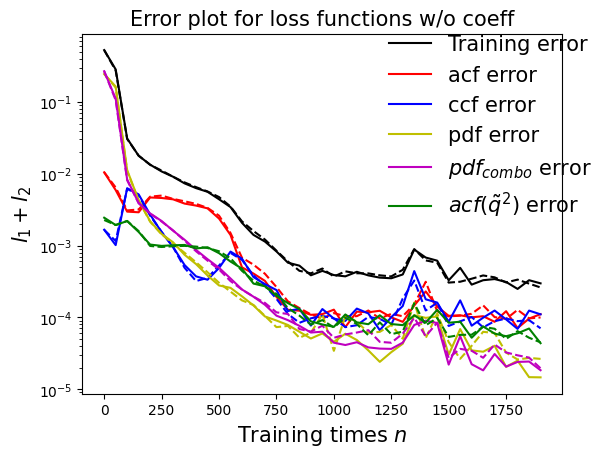

In [87]:
draw_errors(model4)

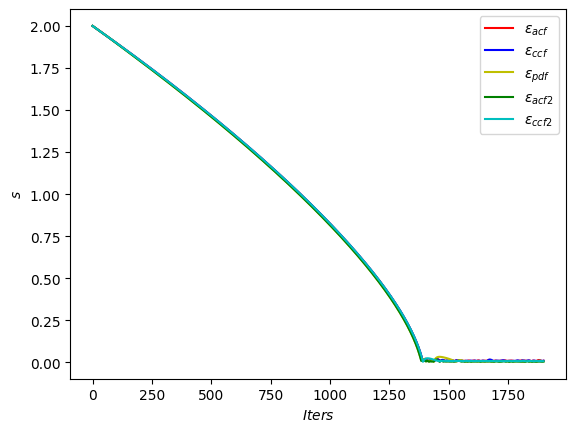

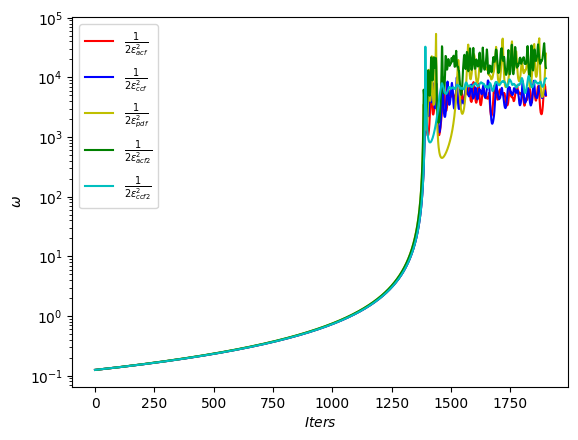

In [88]:
draw_adaptive_w(model4)
draw_epoch_w(model4)

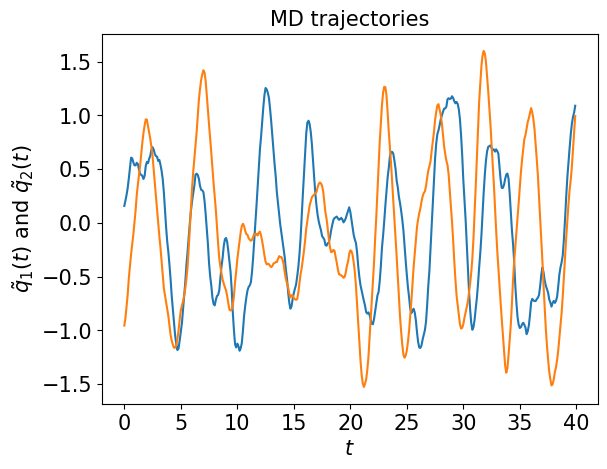

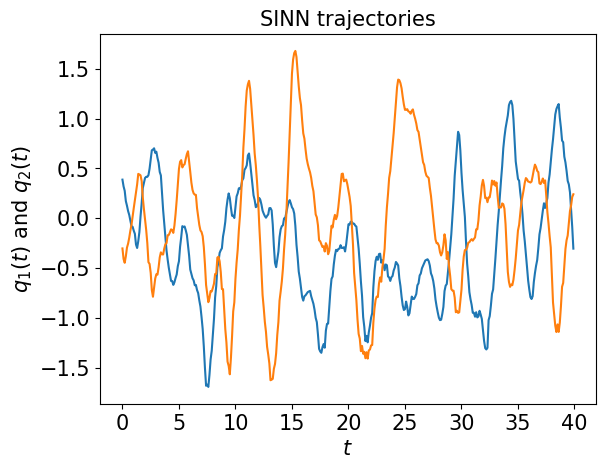

In [89]:
test1(model4)

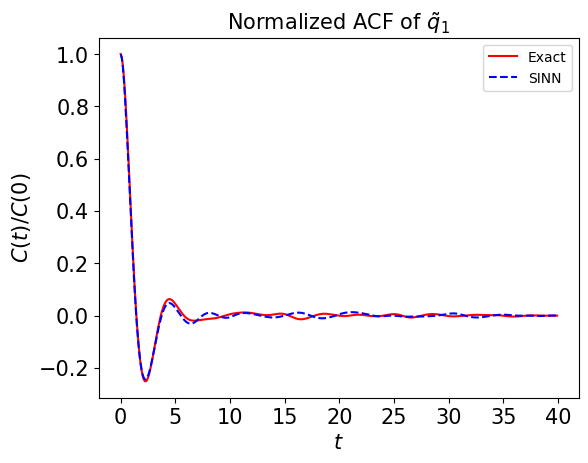

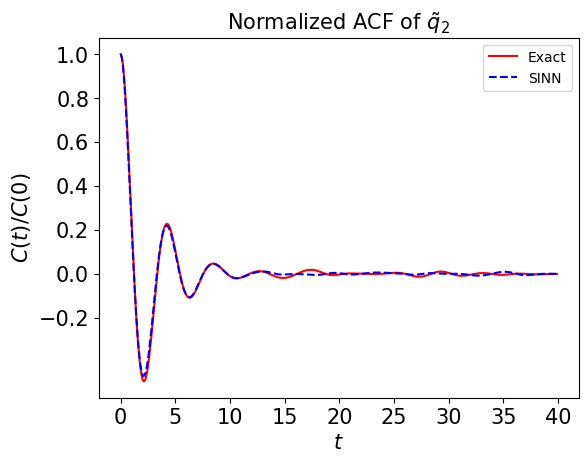

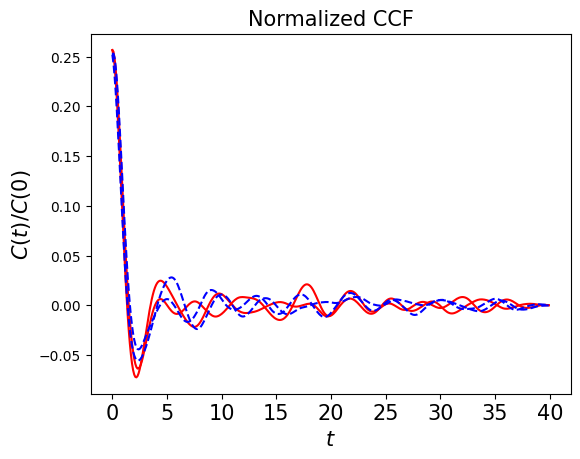

In [90]:
test2(model4)

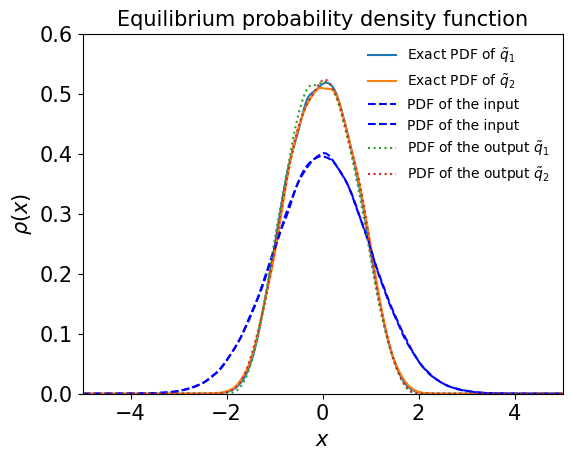

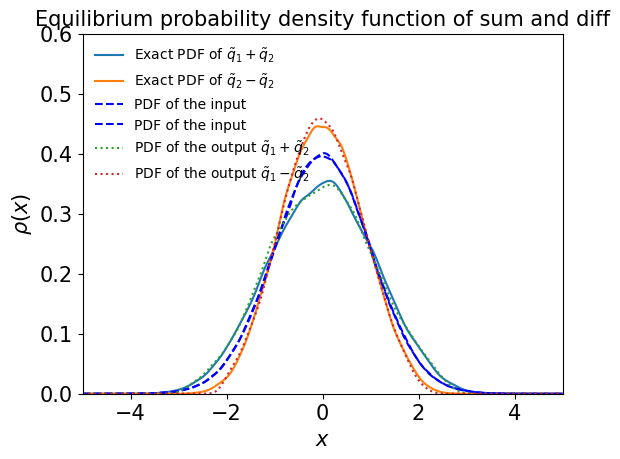

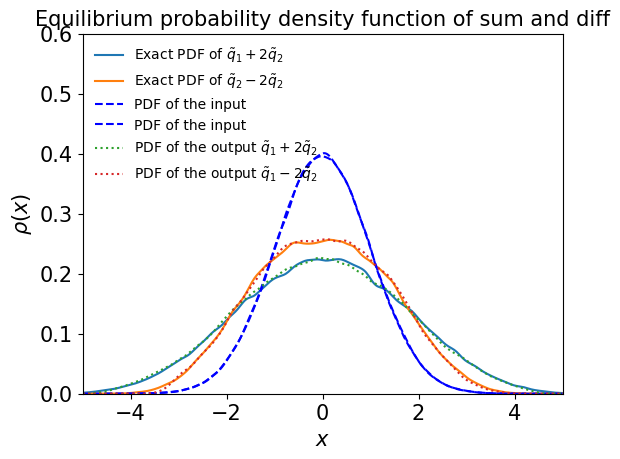

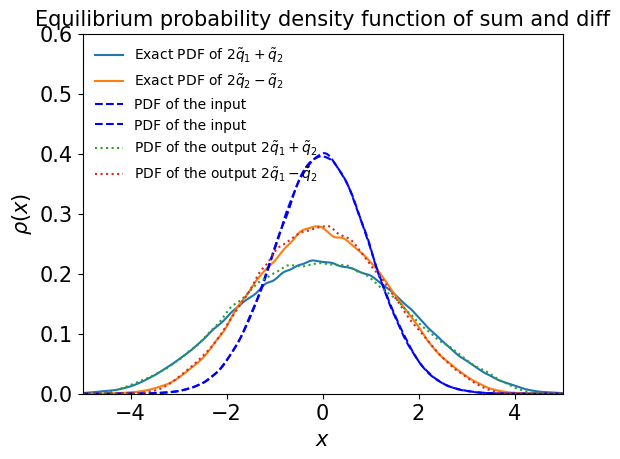

In [91]:
test3(model4)

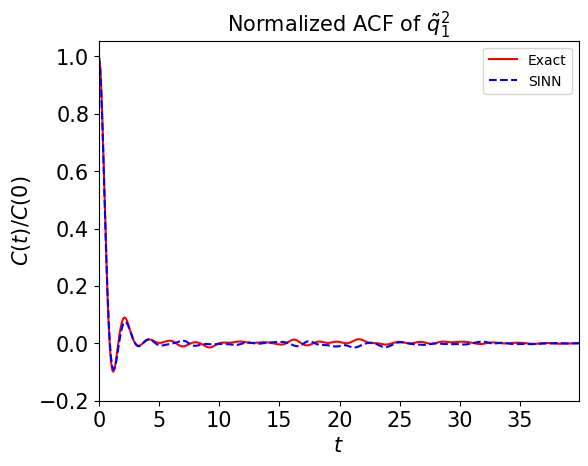

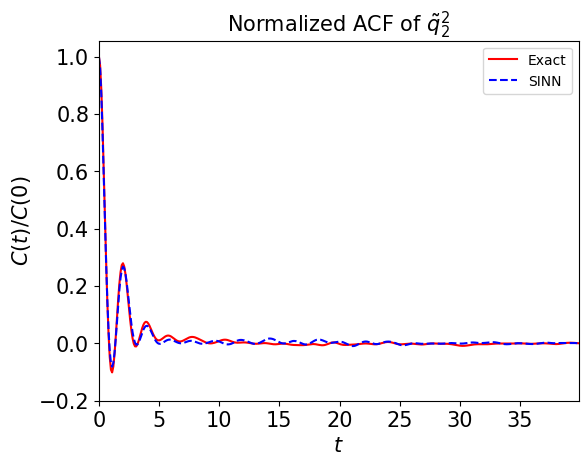

In [92]:
test4(model4)

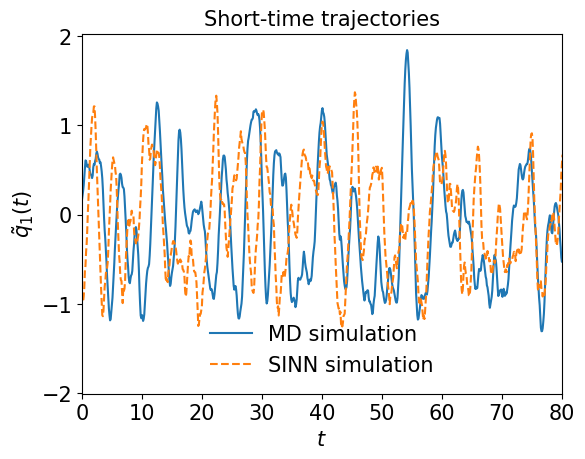

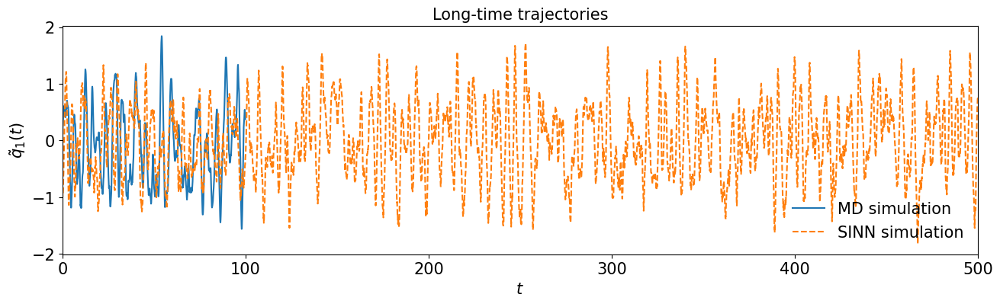

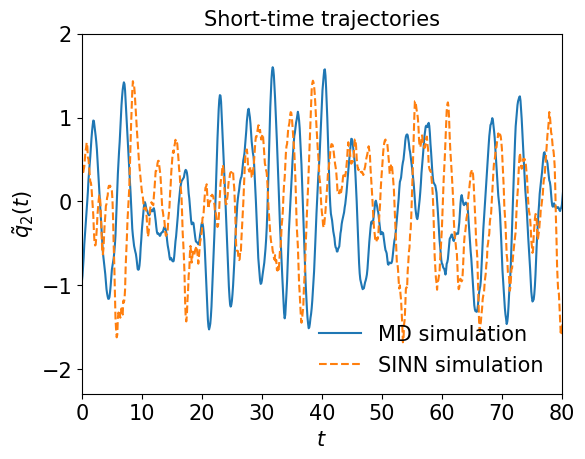

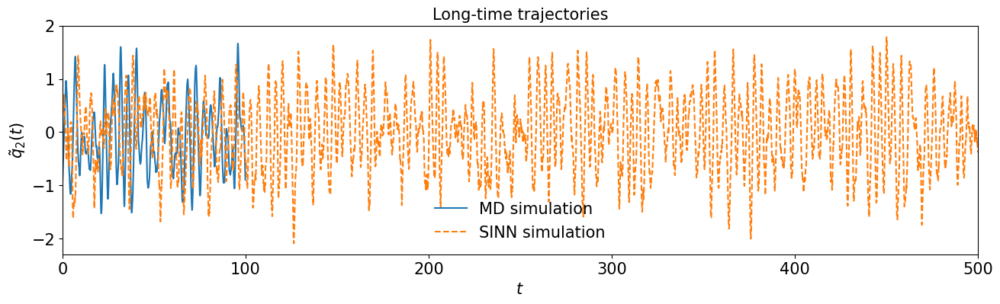

In [93]:
test5(model4)

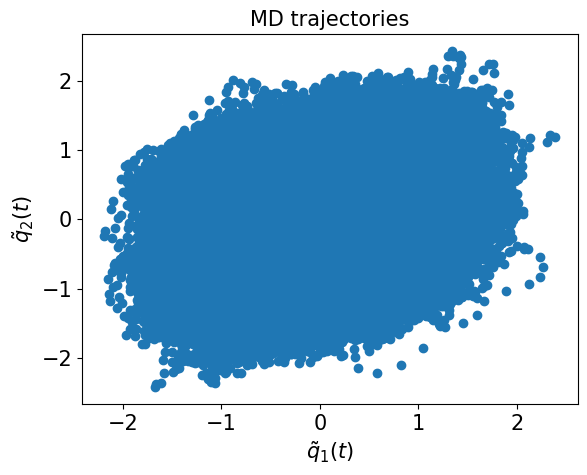

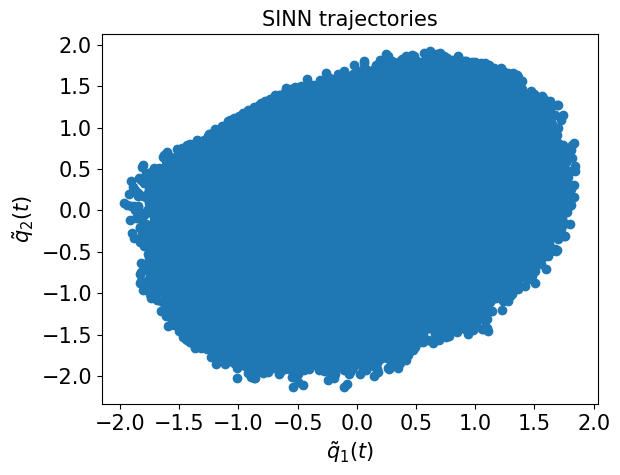

In [94]:
test6(model4)

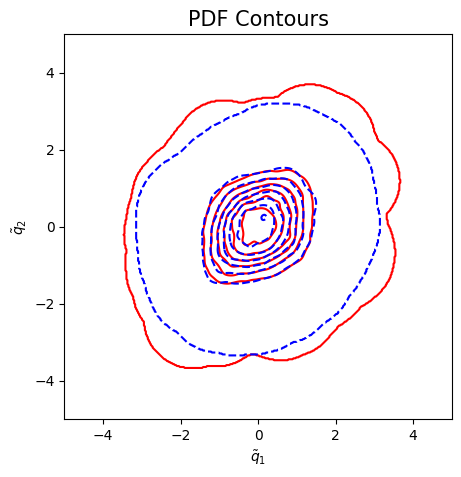

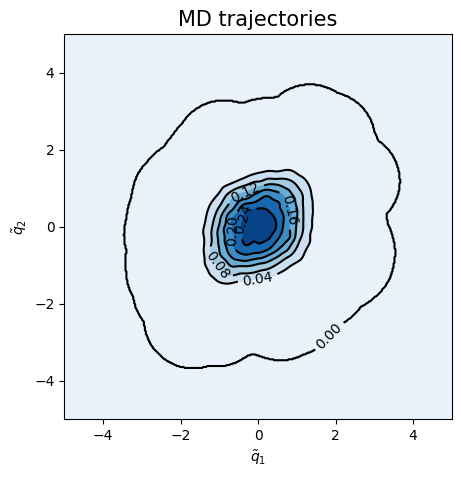

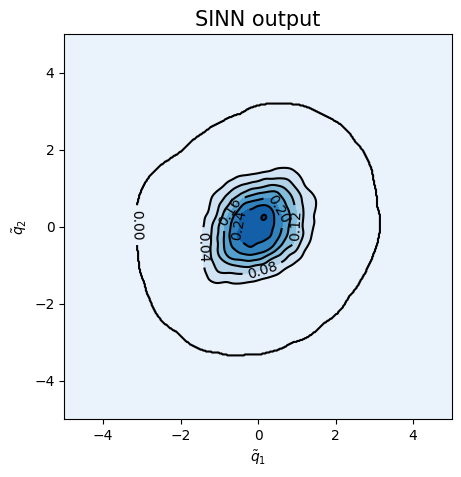

<Figure size 500x500 with 0 Axes>

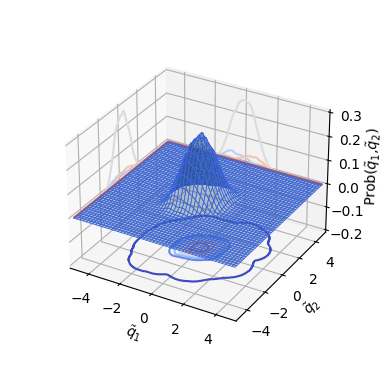

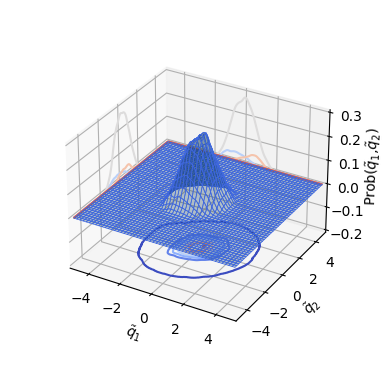

In [95]:
test7(model4)

In [96]:
### Defining SINN model
net5 = SINN(2, 10, 2, 2).to(device)

In [97]:
model5 = Model(net=net5)

In [98]:
model5.train()

[0]-th step loss: 0.5431, 0.5412, acf: 0.01341, ccf: 0.00436, pdf: 0.24703, pdf2: 0.27231, acf2: 0.00410
[50]-th step loss: 0.4069, 0.3998, acf: 0.00935, ccf: 0.00068, pdf: 0.21080, pdf2: 0.17668, acf2: 0.00230
[100]-th step loss: 0.0876, 0.0849, acf: 0.01002, ccf: 0.01105, pdf: 0.04554, pdf2: 0.01496, acf2: 0.00338
[150]-th step loss: 0.0258, 0.0253, acf: 0.00469, ccf: 0.00403, pdf: 0.00896, pdf2: 0.00635, acf2: 0.00124
[200]-th step loss: 0.0134, 0.0137, acf: 0.00445, ccf: 0.00346, pdf: 0.00256, pdf2: 0.00217, acf2: 0.00109
[250]-th step loss: 0.0108, 0.0112, acf: 0.00499, ccf: 0.00220, pdf: 0.00158, pdf2: 0.00143, acf2: 0.00104
[300]-th step loss: 0.0091, 0.0095, acf: 0.00509, ccf: 0.00142, pdf: 0.00103, pdf2: 0.00094, acf2: 0.00104
[350]-th step loss: 0.0075, 0.0078, acf: 0.00465, ccf: 0.00089, pdf: 0.00065, pdf2: 0.00056, acf2: 0.00103
[400]-th step loss: 0.0055, 0.0058, acf: 0.00338, ccf: 0.00070, pdf: 0.00034, pdf2: 0.00038, acf2: 0.00104
[450]-th step loss: 0.0040, 0.0040, acf:

[3850]-th step loss: 0.0003, 0.0003, acf: 0.00011, ccf: 0.00012, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00006
[3900]-th step loss: 0.0003, 0.0003, acf: 0.00013, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00006
[3950]-th step loss: 0.0004, 0.0003, acf: 0.00012, ccf: 0.00009, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00007
[4000]-th step loss: 0.0003, 0.0003, acf: 0.00013, ccf: 0.00012, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00006
[4050]-th step loss: 0.0004, 0.0004, acf: 0.00011, ccf: 0.00015, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00006
[4100]-th step loss: 0.0003, 0.0003, acf: 0.00011, ccf: 0.00009, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00006
Training finished
Training time: 302.83
Training time per iteration: 0.07
Number of Iterations:4101


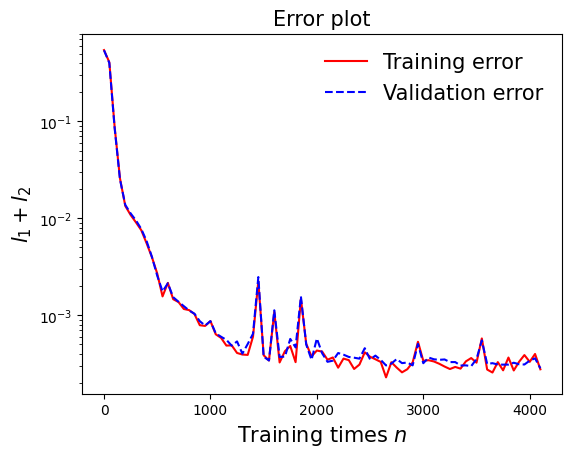

In [99]:
draw_loss(model5)

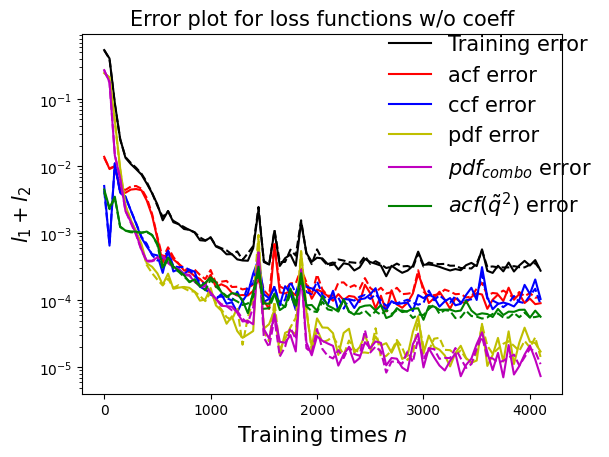

In [100]:
draw_errors(model5)

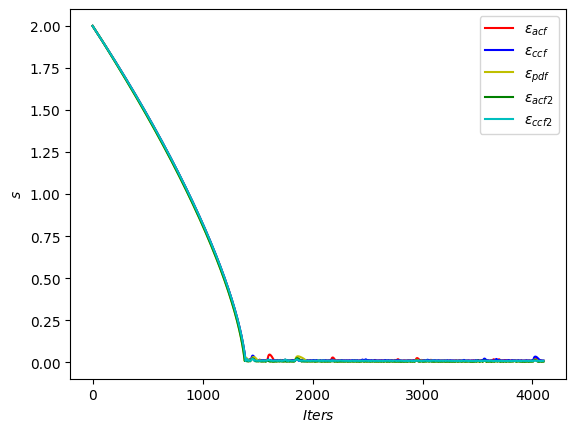

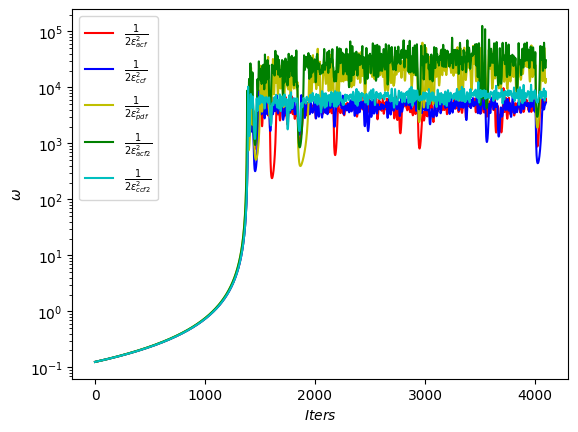

In [101]:
draw_adaptive_w(model5)
draw_epoch_w(model5)

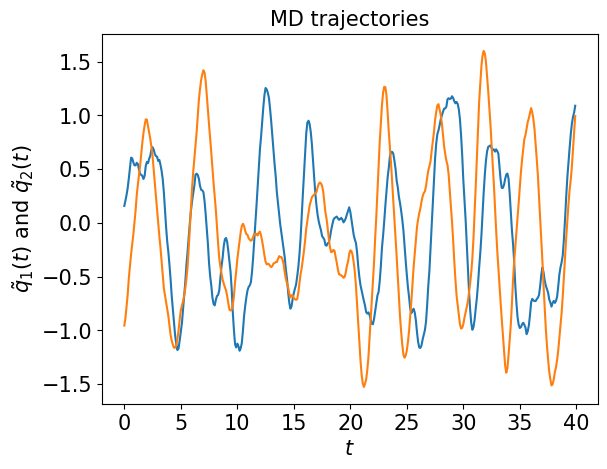

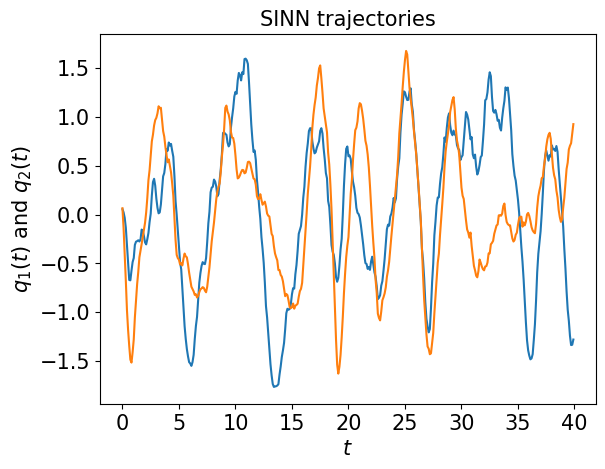

In [102]:
test1(model5)

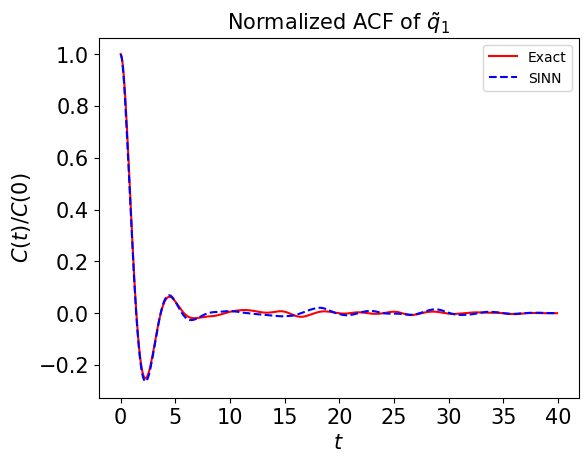

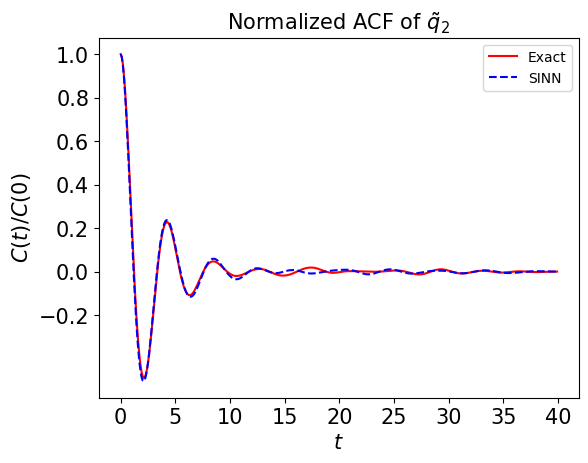

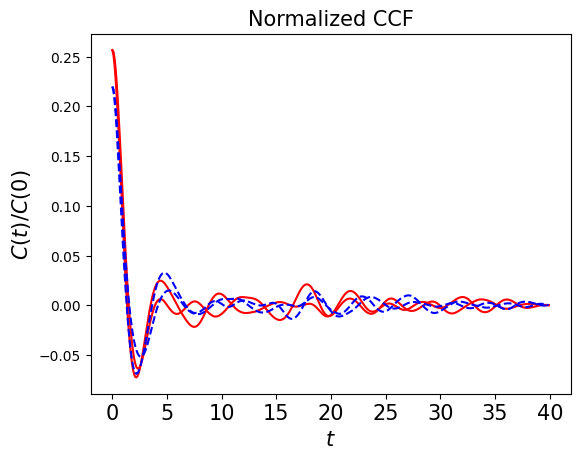

In [103]:
test2(model5)

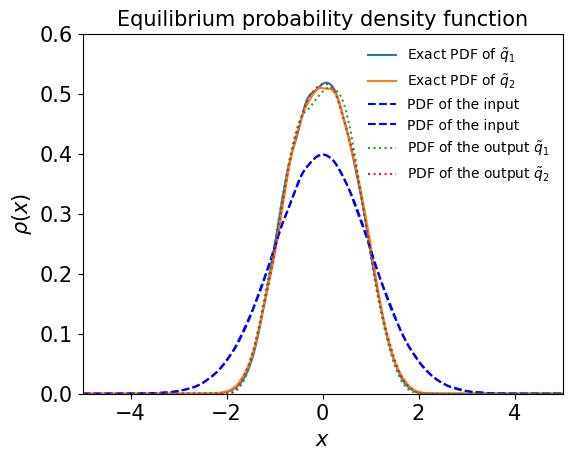

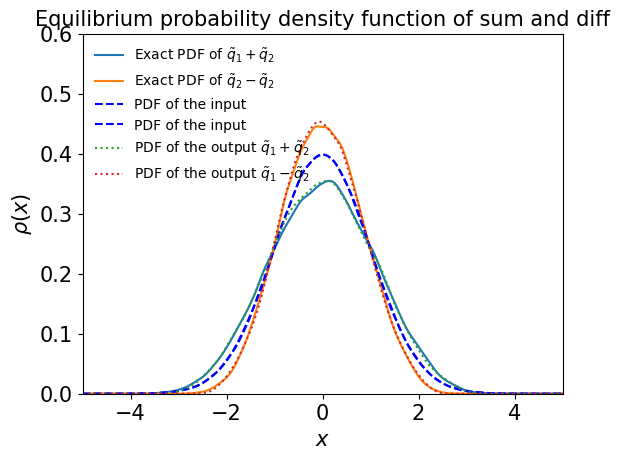

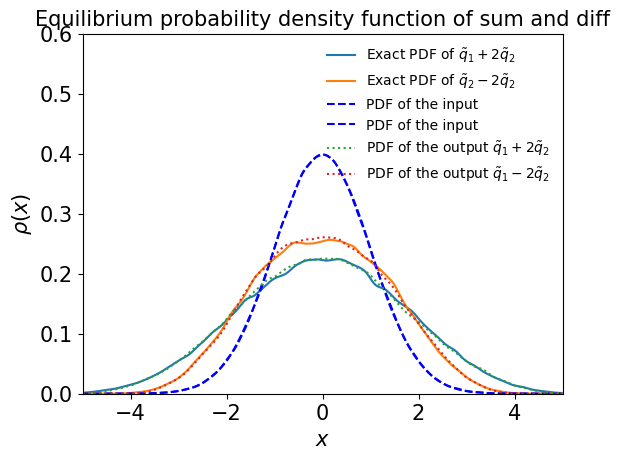

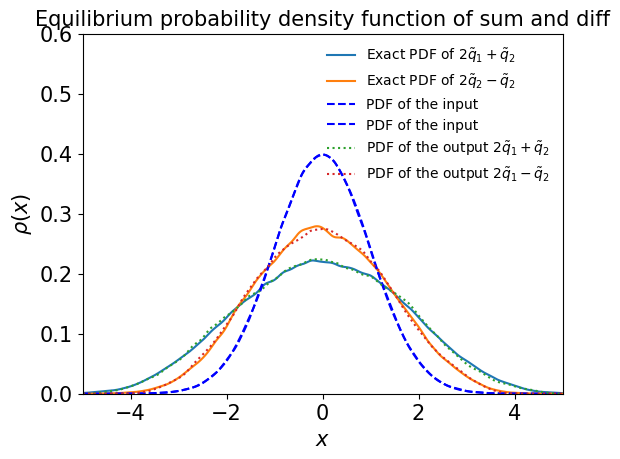

In [104]:
test3(model5)

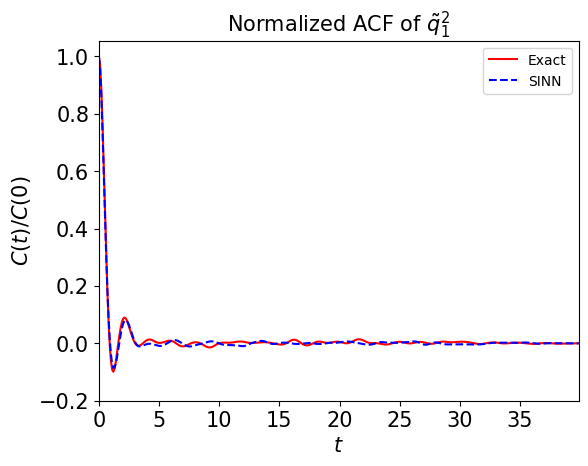

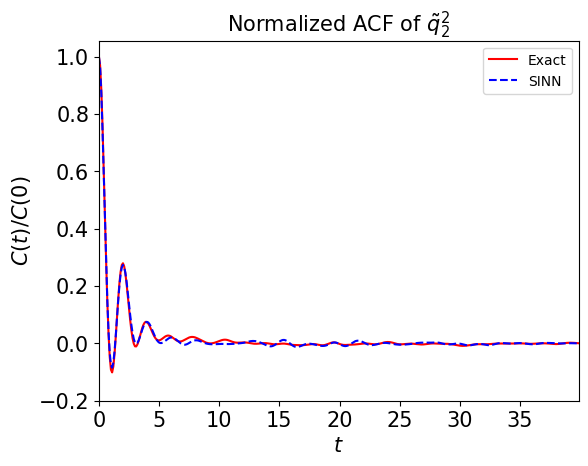

In [105]:
test4(model5)

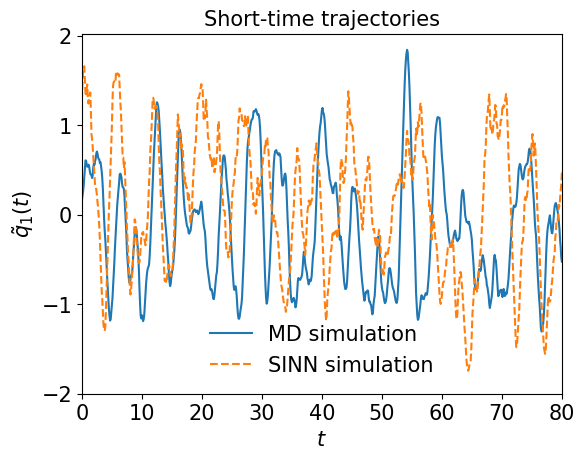

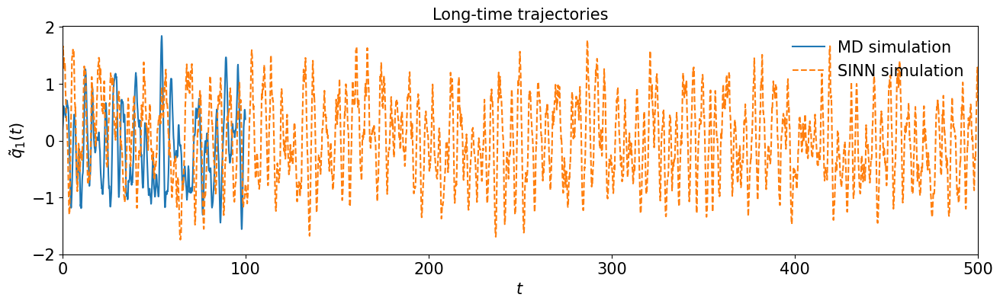

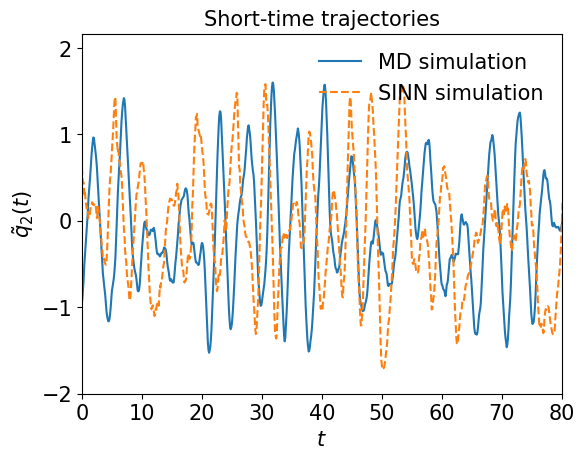

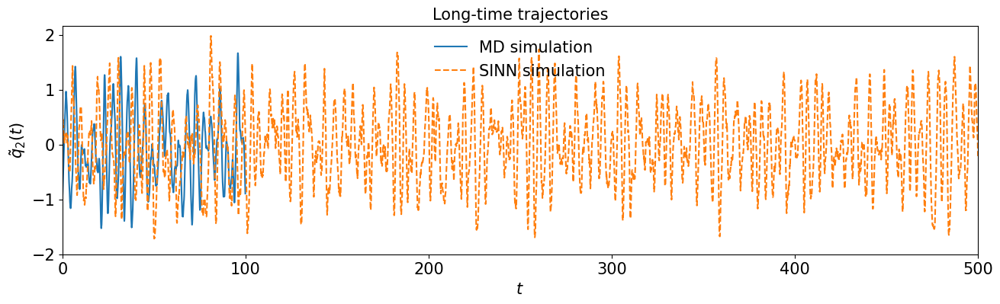

In [106]:
test5(model5)

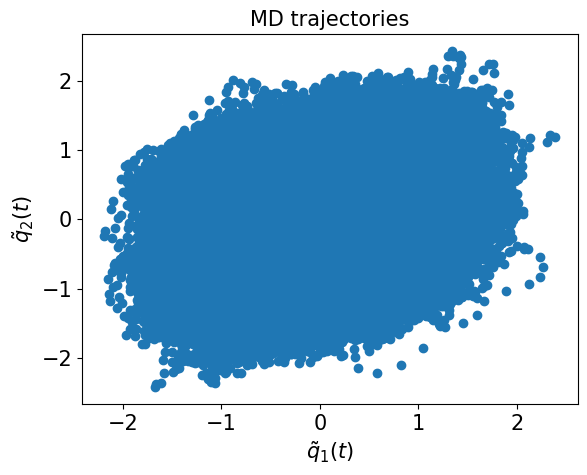

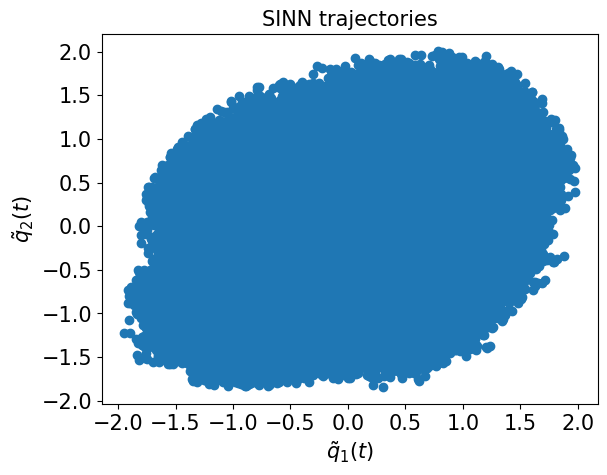

In [107]:
test6(model5)

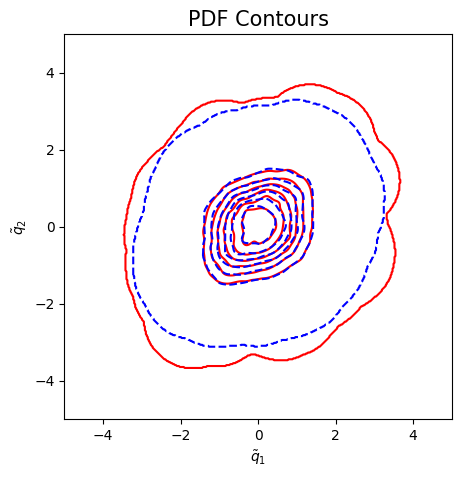

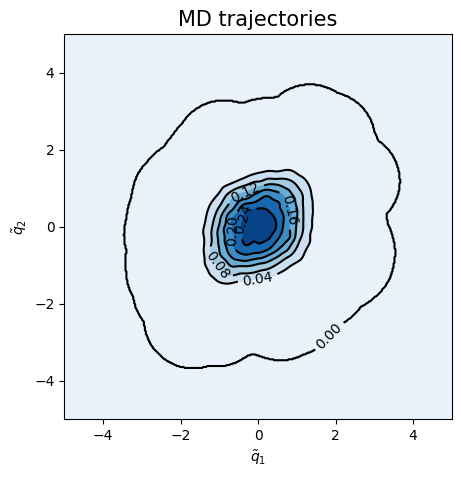

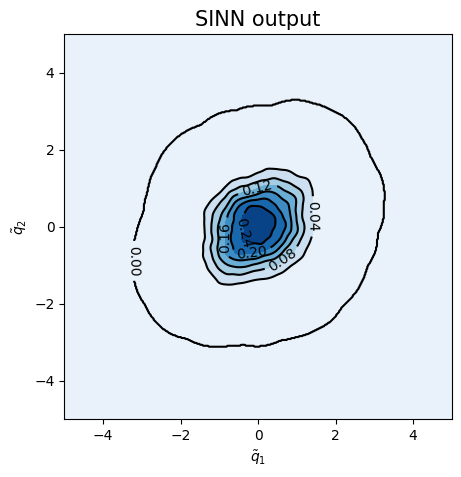

<Figure size 500x500 with 0 Axes>

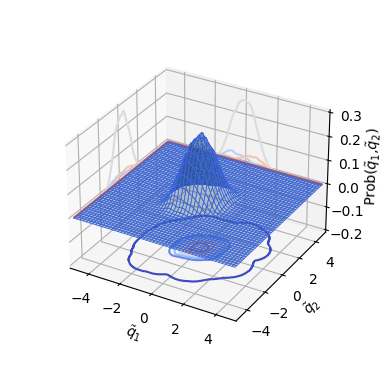

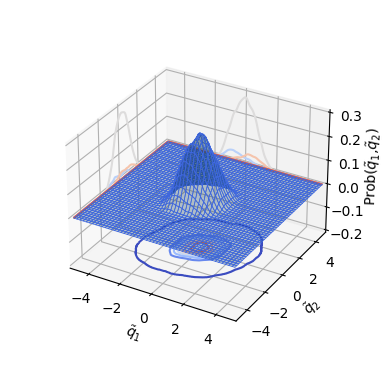

In [108]:
test7(model5)

In [109]:
### Defining SINN model
net6 = SINN(2, 10, 2, 2).to(device)

In [110]:
model6 = Model(net=net6)

In [111]:
model6.train()

[0]-th step loss: 0.5388, 0.5380, acf: 0.00999, ccf: 0.00932, pdf: 0.24716, pdf2: 0.26945, acf2: 0.00208
[50]-th step loss: 0.3143, 0.3026, acf: 0.00679, ccf: 0.00946, pdf: 0.16596, pdf2: 0.11893, acf2: 0.00146
[100]-th step loss: 0.0493, 0.0478, acf: 0.00626, ccf: 0.01141, pdf: 0.01603, pdf2: 0.01198, acf2: 0.00208
[150]-th step loss: 0.0163, 0.0165, acf: 0.00499, ccf: 0.00398, pdf: 0.00252, pdf2: 0.00377, acf2: 0.00128
[200]-th step loss: 0.0124, 0.0126, acf: 0.00523, ccf: 0.00227, pdf: 0.00143, pdf2: 0.00258, acf2: 0.00108
[250]-th step loss: 0.0100, 0.0102, acf: 0.00536, ccf: 0.00109, pdf: 0.00091, pdf2: 0.00182, acf2: 0.00105
[300]-th step loss: 0.0084, 0.0084, acf: 0.00500, ccf: 0.00043, pdf: 0.00061, pdf2: 0.00129, acf2: 0.00103
[350]-th step loss: 0.0055, 0.0058, acf: 0.00321, ccf: 0.00041, pdf: 0.00035, pdf2: 0.00087, acf2: 0.00091
[400]-th step loss: 0.0037, 0.0036, acf: 0.00134, ccf: 0.00084, pdf: 0.00024, pdf2: 0.00042, acf2: 0.00072
[450]-th step loss: 0.0024, 0.0026, acf:

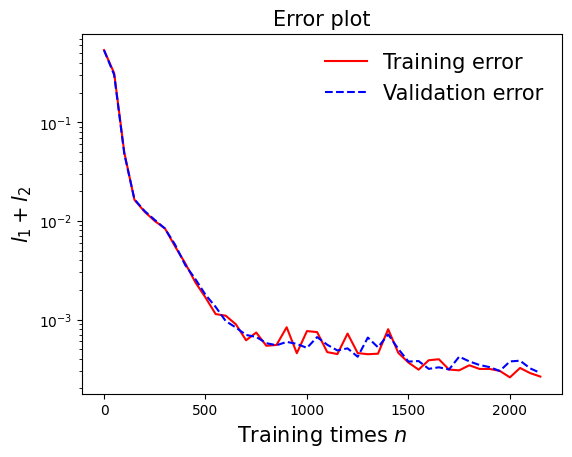

In [112]:
draw_loss(model6)

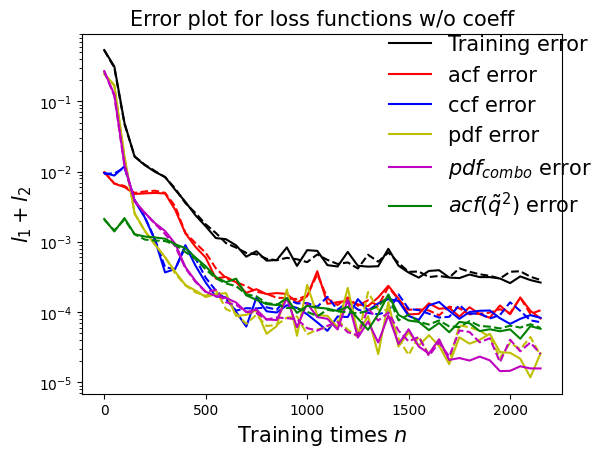

In [113]:
draw_errors(model6)

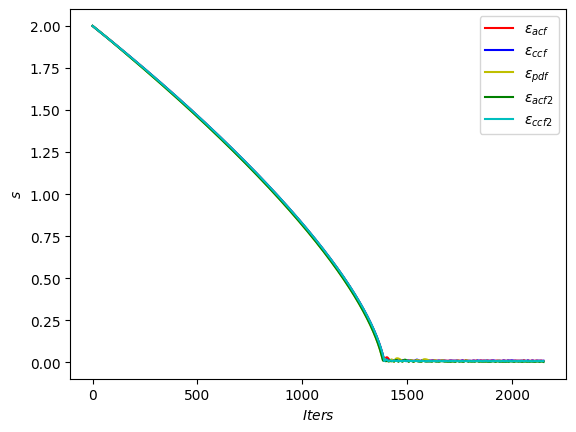

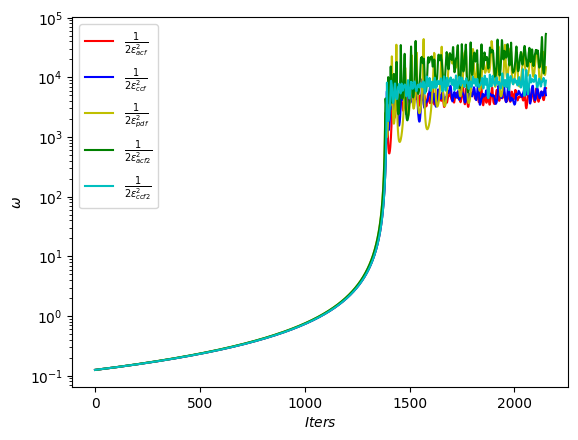

In [114]:
draw_adaptive_w(model6)
draw_epoch_w(model6)

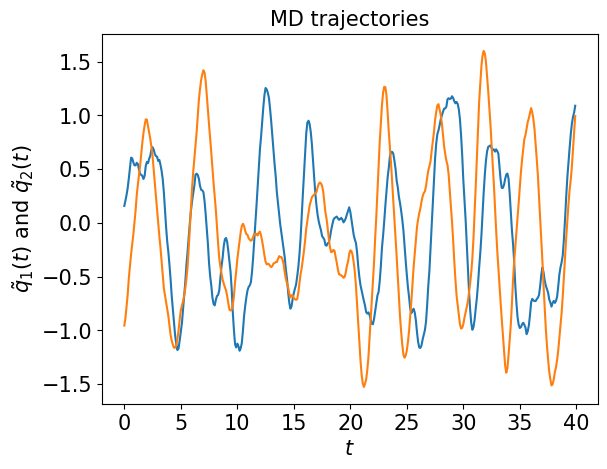

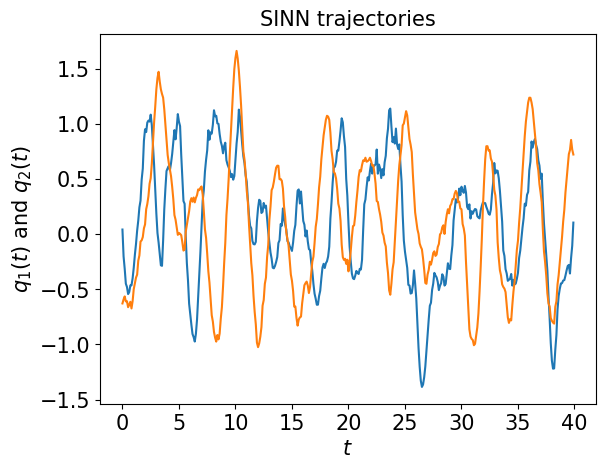

In [115]:
test1(model6)

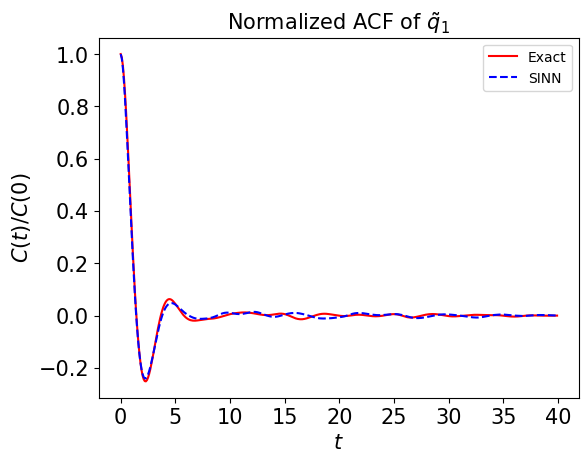

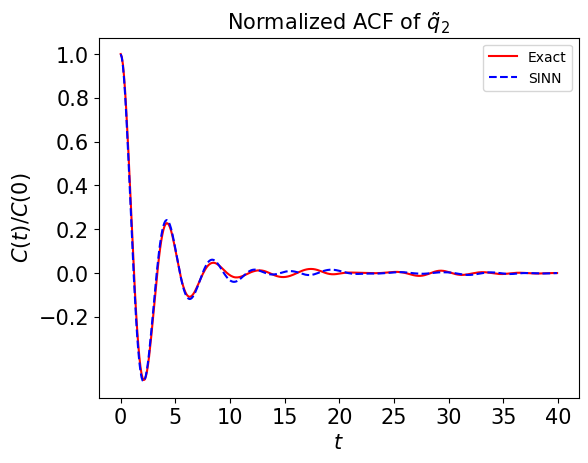

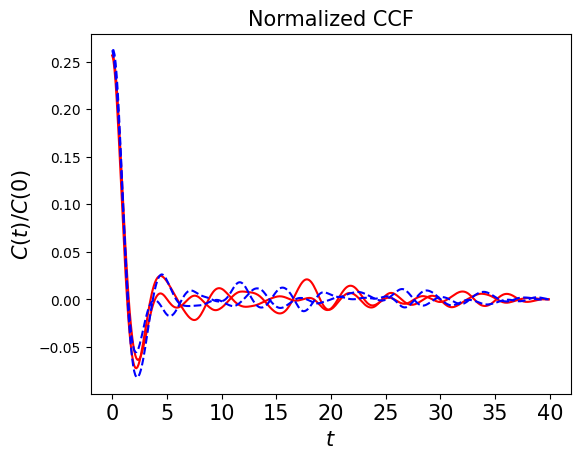

In [116]:
test2(model6)

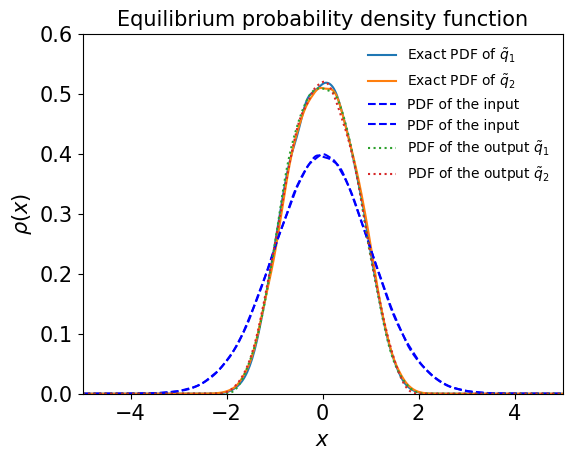

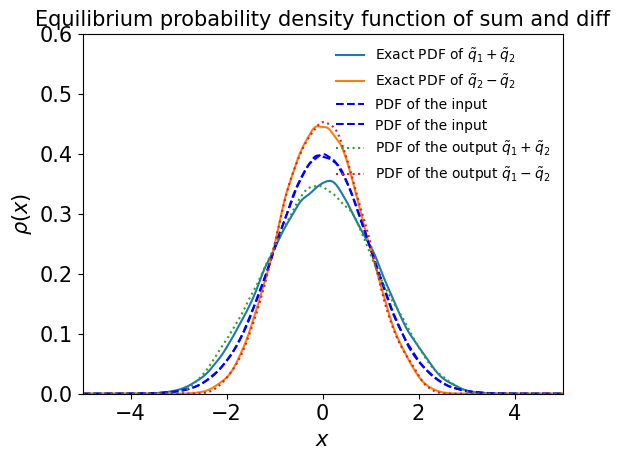

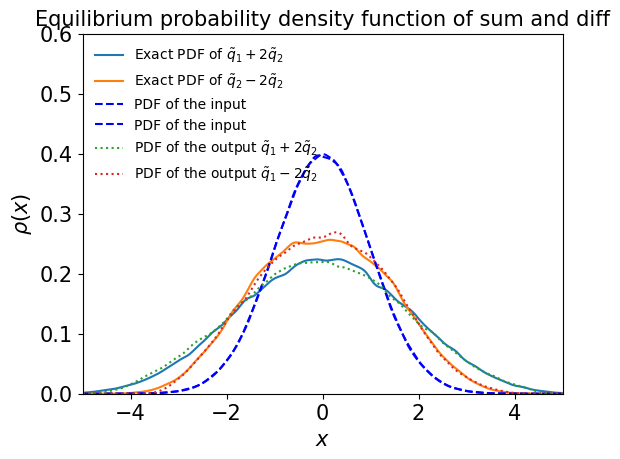

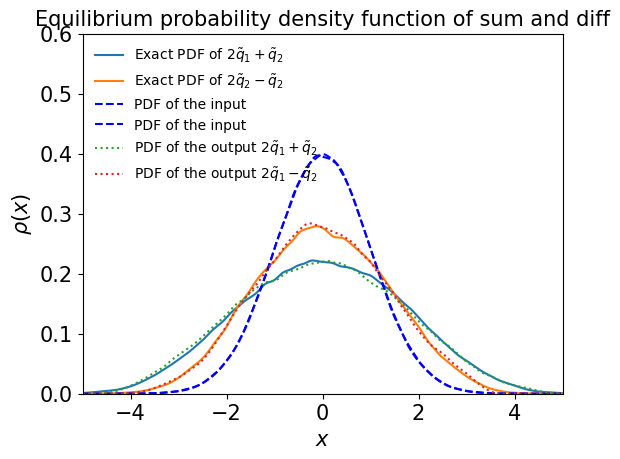

In [117]:
test3(model6)

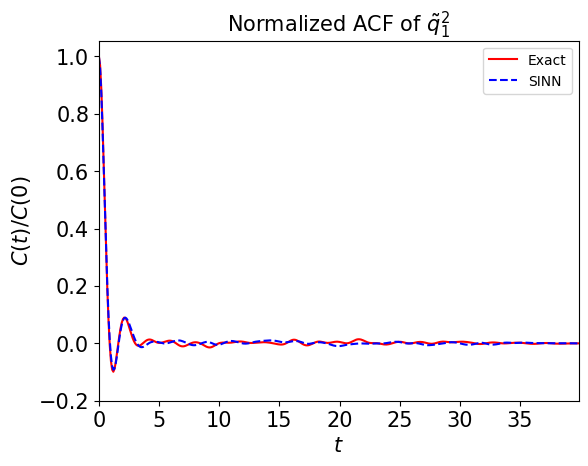

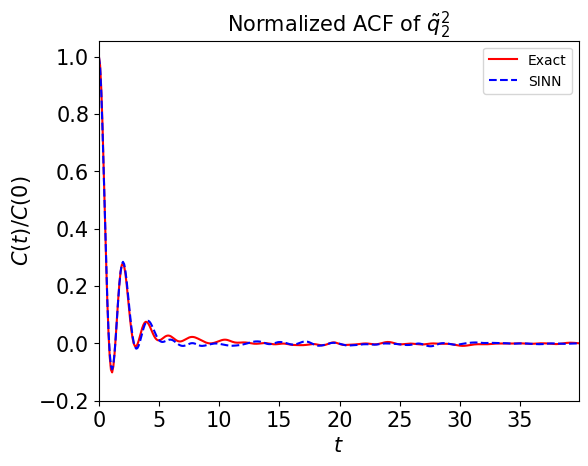

In [118]:
test4(model6)

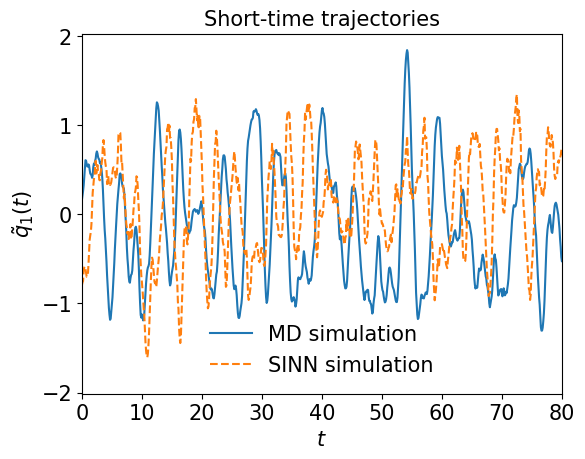

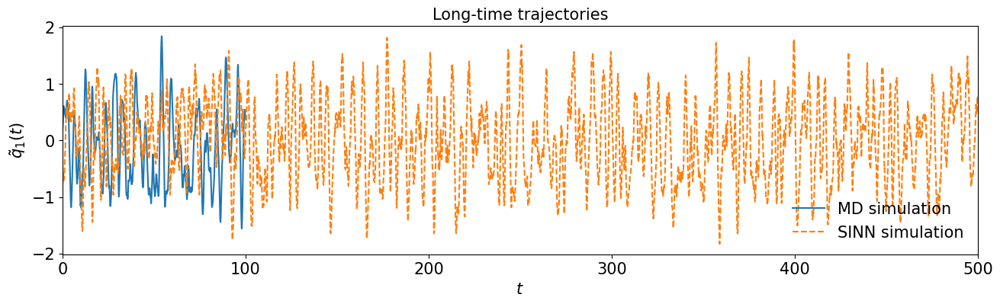

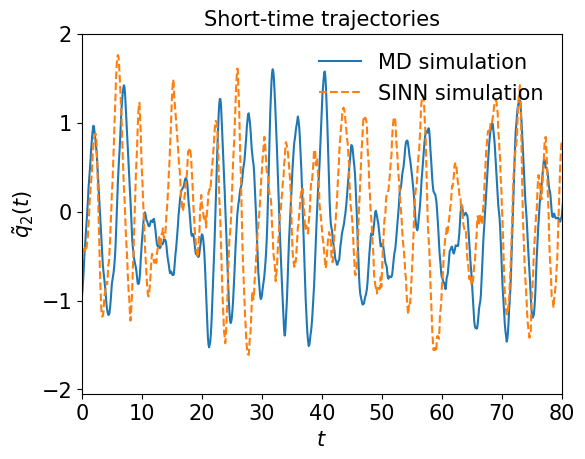

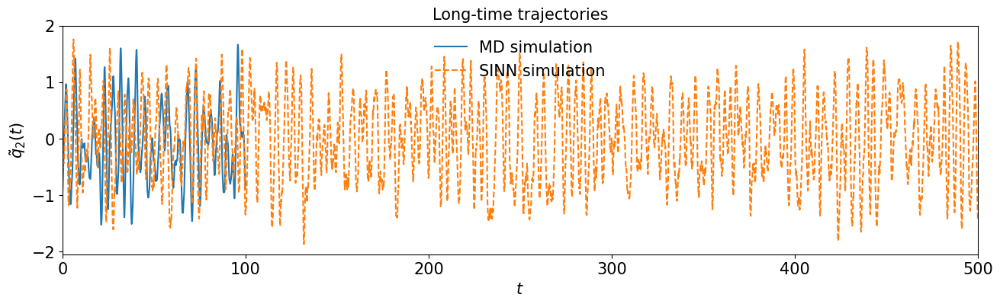

In [119]:
test5(model6)

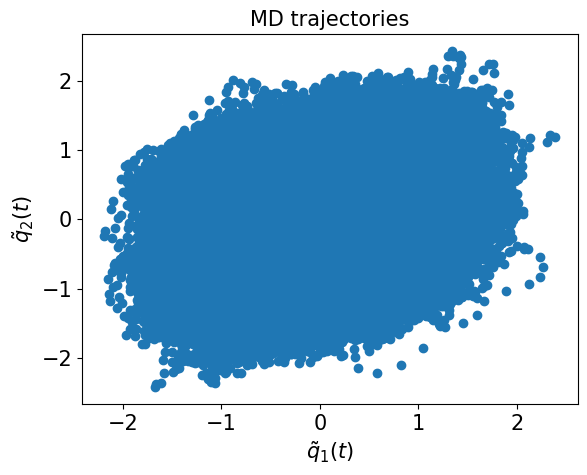

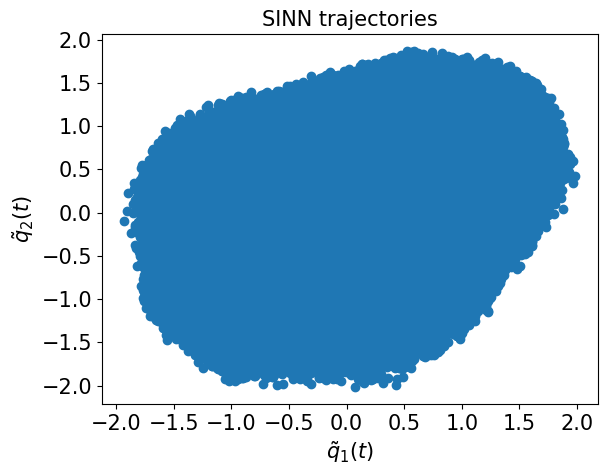

In [120]:
test6(model6)

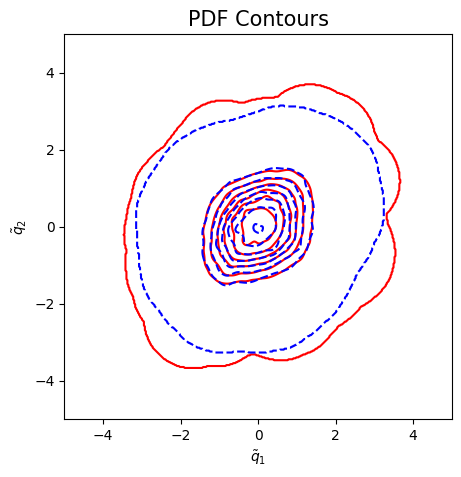

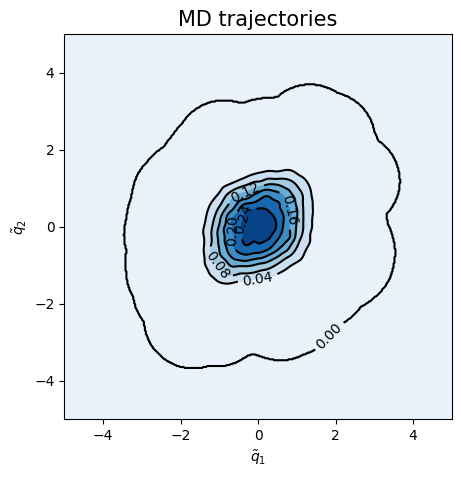

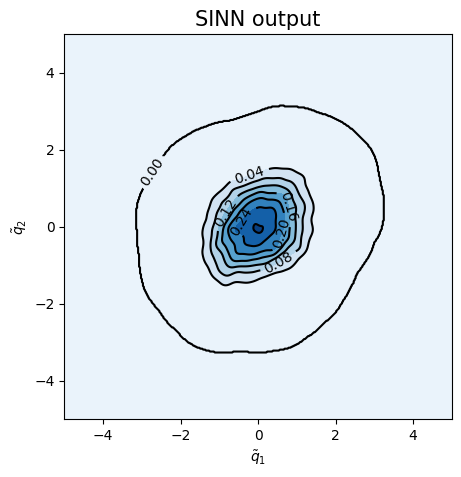

<Figure size 500x500 with 0 Axes>

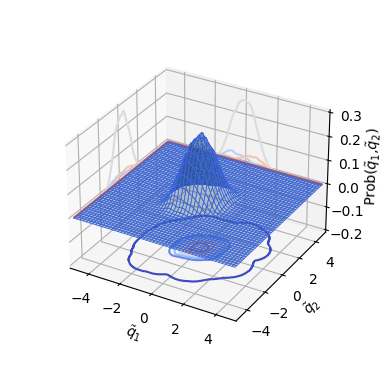

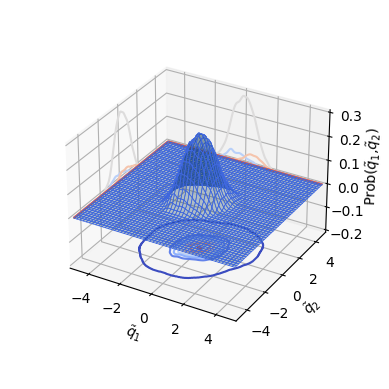

In [121]:
test7(model6)

In [122]:
### Defining SINN model
net7 = SINN(2, 10, 2, 2).to(device)

In [123]:
model7 = Model(net=net7)

In [124]:
model7.train()

[0]-th step loss: 0.5370, 0.5351, acf: 0.01019, ccf: 0.00472, pdf: 0.24773, pdf2: 0.27023, acf2: 0.00222
[50]-th step loss: 0.2554, 0.2463, acf: 0.00631, ccf: 0.00398, pdf: 0.15333, pdf2: 0.08065, acf2: 0.00201
[100]-th step loss: 0.0750, 0.0740, acf: 0.00756, ccf: 0.00975, pdf: 0.02949, pdf2: 0.02368, acf2: 0.00357
[150]-th step loss: 0.0309, 0.0307, acf: 0.00415, ccf: 0.00498, pdf: 0.01054, pdf2: 0.00965, acf2: 0.00141
[200]-th step loss: 0.0138, 0.0135, acf: 0.00224, ccf: 0.00513, pdf: 0.00148, pdf2: 0.00360, acf2: 0.00107
[250]-th step loss: 0.0096, 0.0097, acf: 0.00276, ccf: 0.00317, pdf: 0.00081, pdf2: 0.00188, acf2: 0.00103
[300]-th step loss: 0.0061, 0.0061, acf: 0.00174, ccf: 0.00184, pdf: 0.00053, pdf2: 0.00099, acf2: 0.00097
[350]-th step loss: 0.0032, 0.0032, acf: 0.00094, ccf: 0.00057, pdf: 0.00049, pdf2: 0.00058, acf2: 0.00066
[400]-th step loss: 0.0024, 0.0026, acf: 0.00103, ccf: 0.00047, pdf: 0.00035, pdf2: 0.00038, acf2: 0.00040
[450]-th step loss: 0.0017, 0.0018, acf:

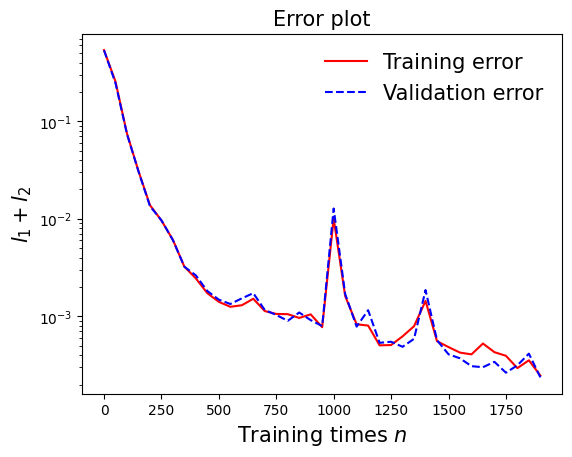

In [125]:
draw_loss(model7)

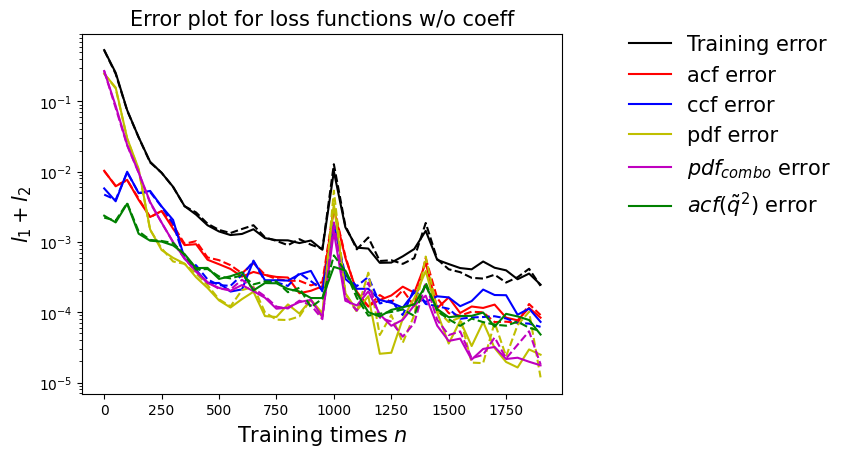

In [126]:
draw_errors(model7)

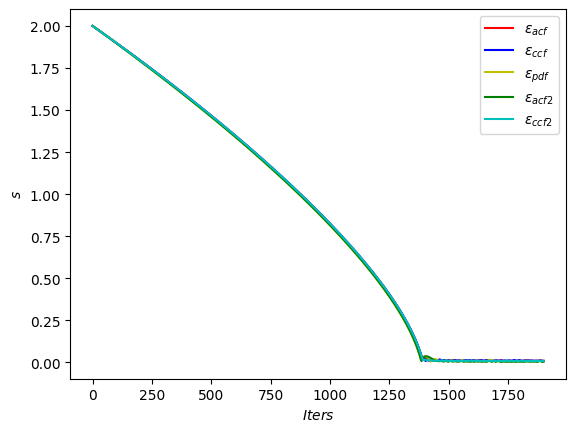

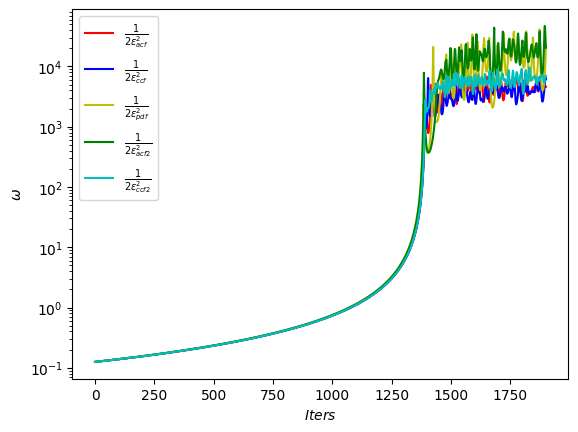

In [127]:
draw_adaptive_w(model7)
draw_epoch_w(model7)

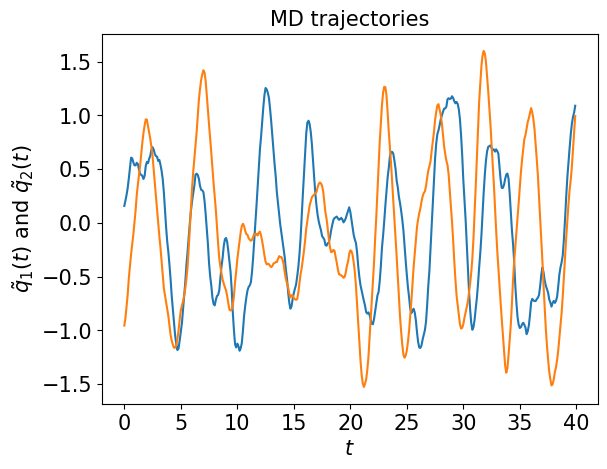

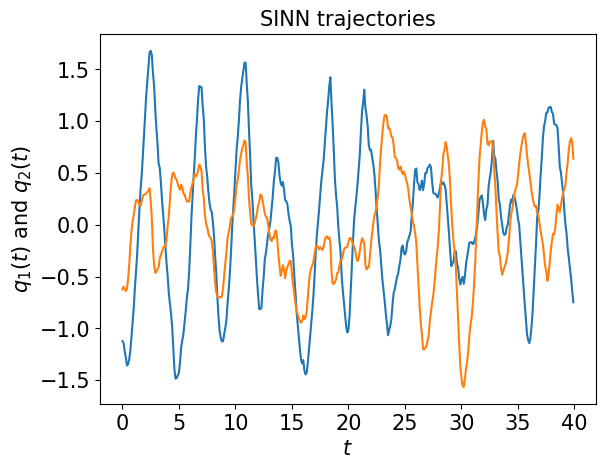

In [128]:
test1(model7)

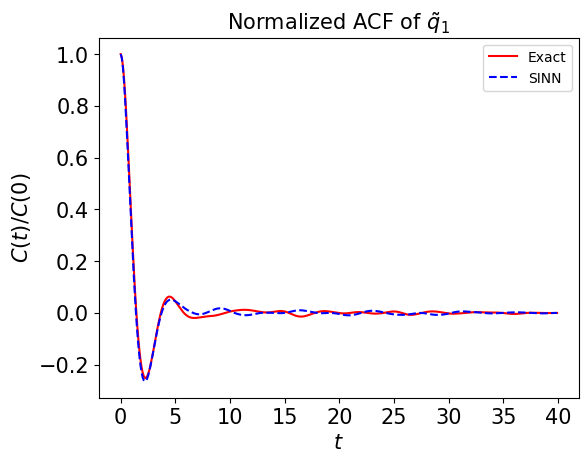

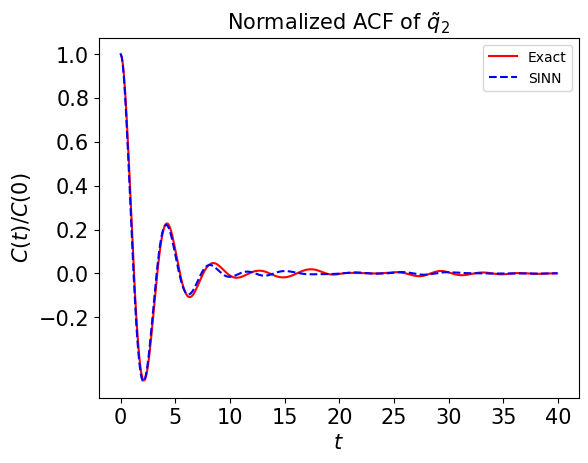

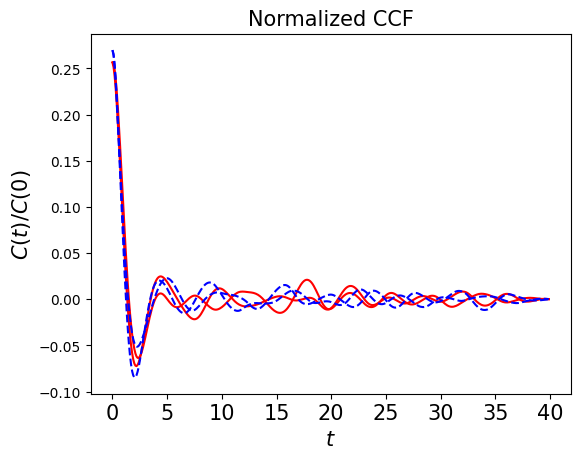

In [129]:
test2(model7)

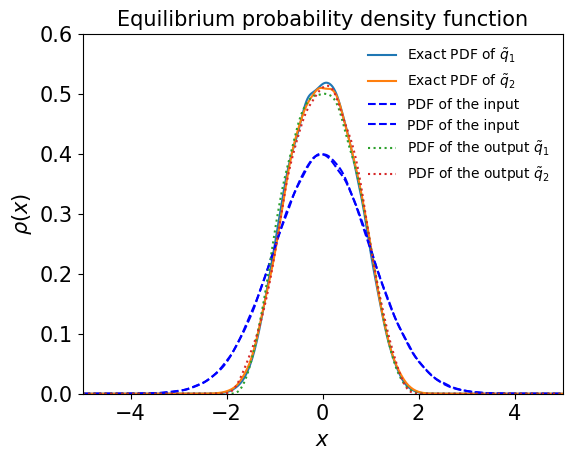

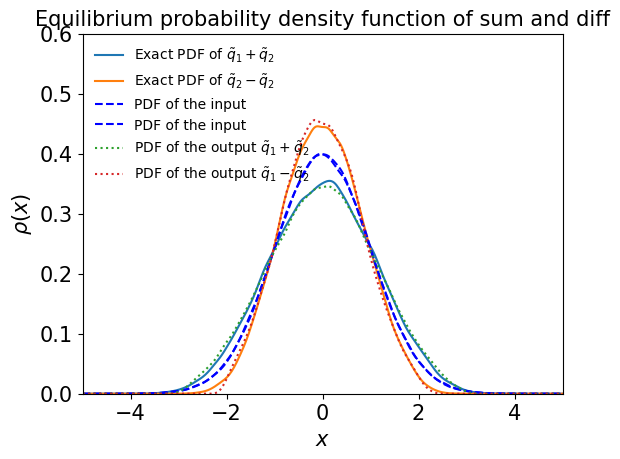

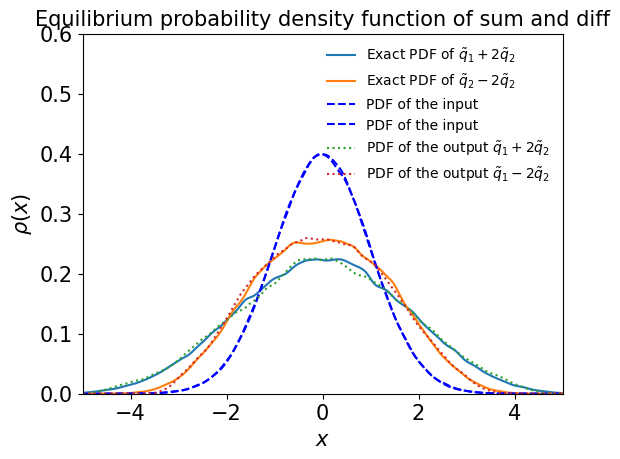

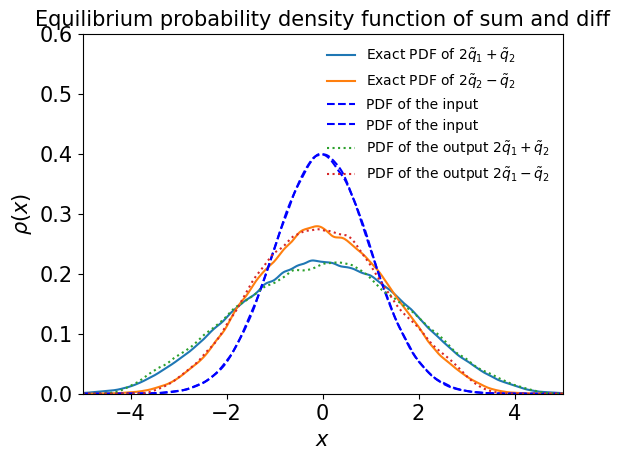

In [130]:
test3(model7)

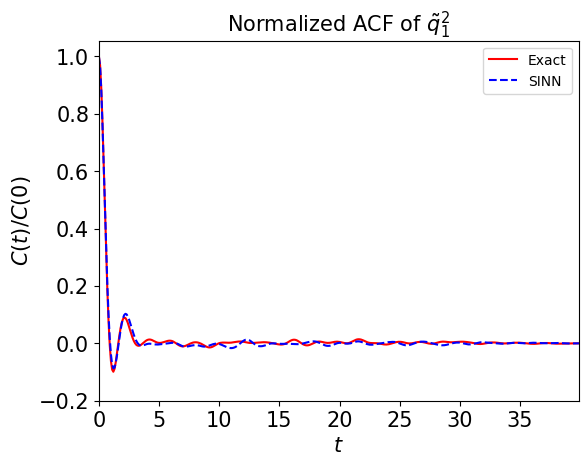

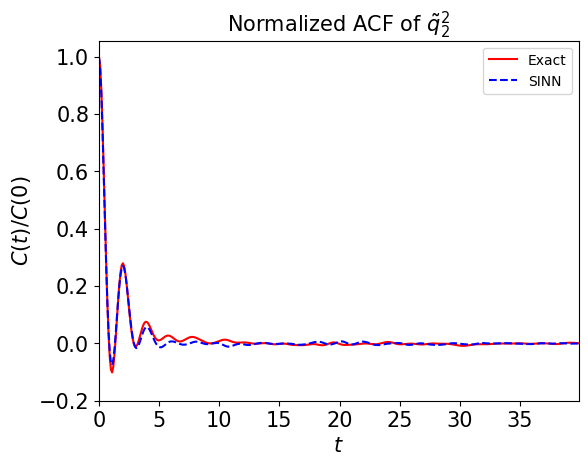

In [131]:
test4(model7)

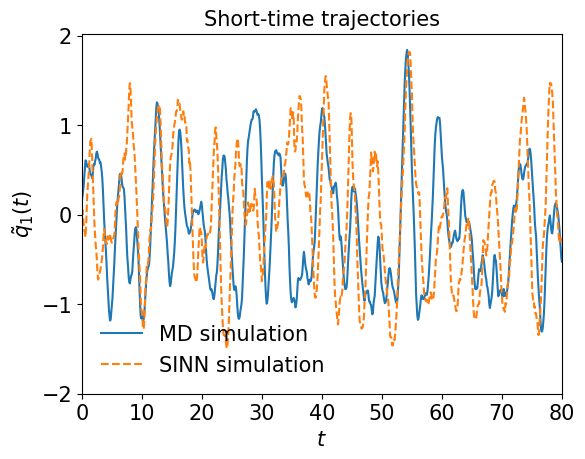

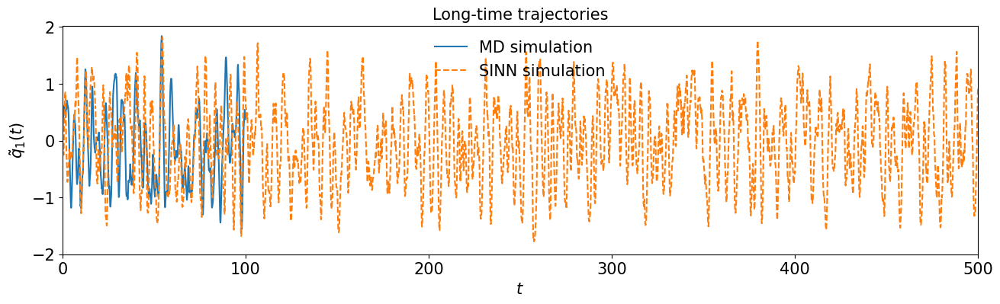

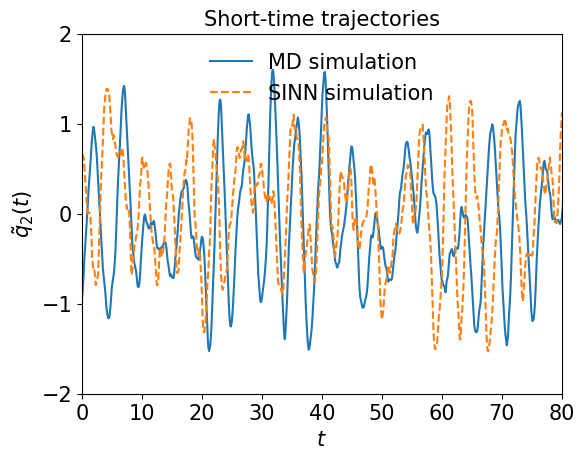

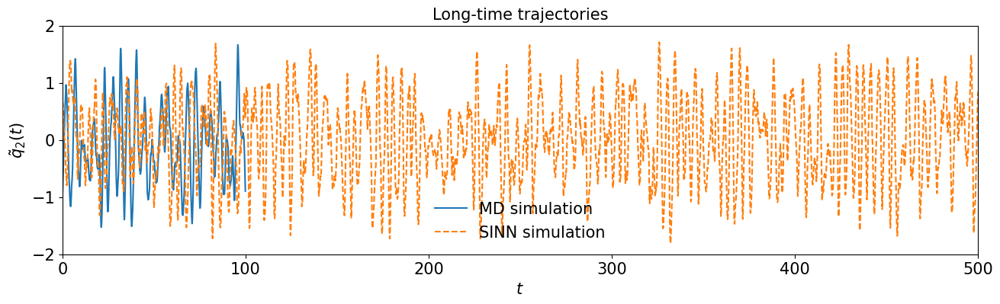

In [132]:
test5(model7)

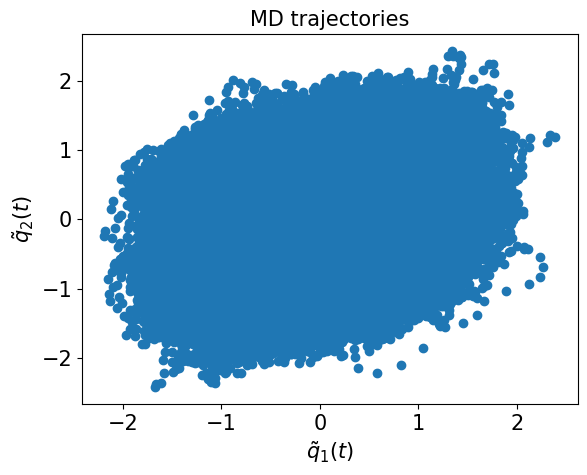

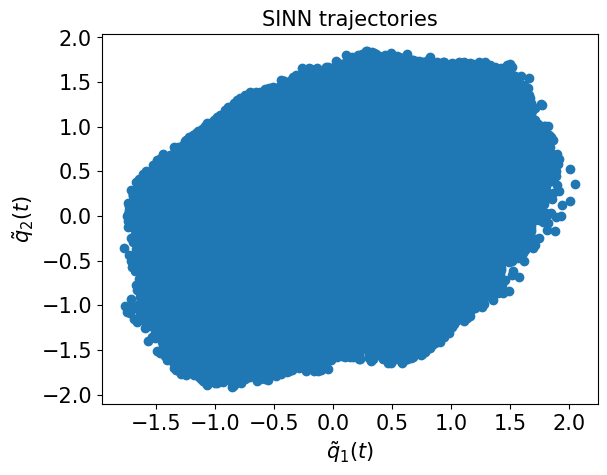

In [133]:
test6(model7)

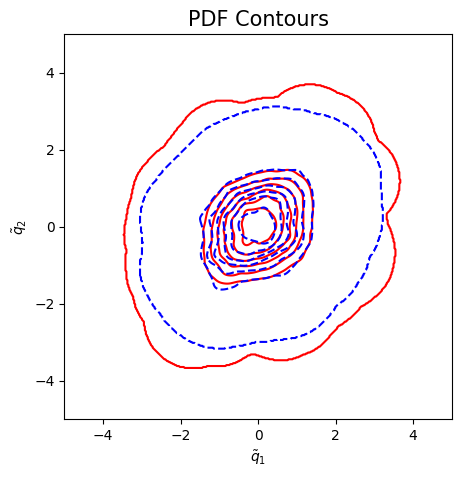

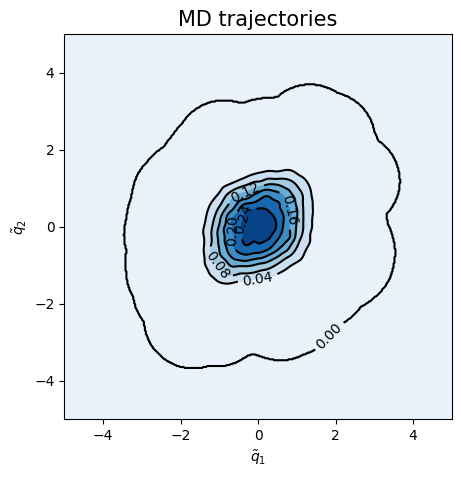

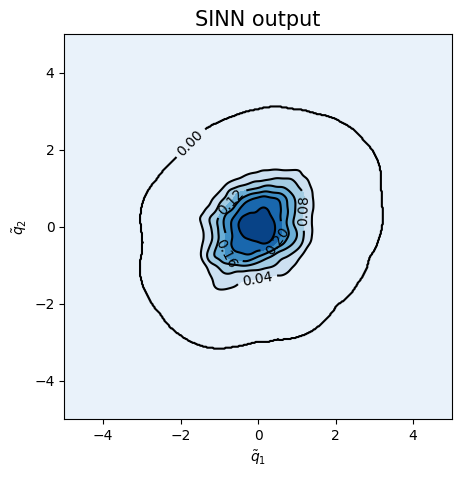

<Figure size 500x500 with 0 Axes>

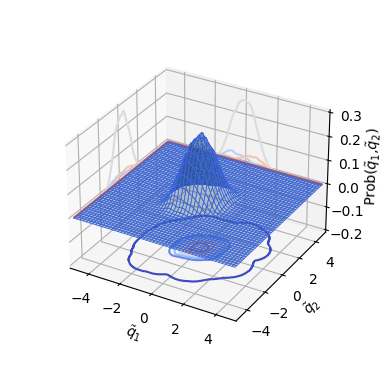

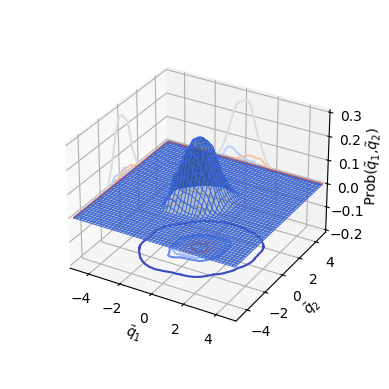

In [134]:
test7(model7)

In [135]:
### Defining SINN model
net8 = SINN(2, 10, 2, 2).to(device)

In [136]:
model8 = Model(net=net8)

In [137]:
model8.train()

[0]-th step loss: 0.5414, 0.5402, acf: 0.01507, ccf: 0.00143, pdf: 0.24699, pdf2: 0.27142, acf2: 0.00525
[50]-th step loss: 0.3845, 0.3732, acf: 0.00726, ccf: 0.00110, pdf: 0.19999, pdf2: 0.16351, acf2: 0.00136
[100]-th step loss: 0.0386, 0.0380, acf: 0.00398, ccf: 0.00642, pdf: 0.01512, pdf2: 0.00887, acf2: 0.00359
[150]-th step loss: 0.0206, 0.0201, acf: 0.00228, ccf: 0.00595, pdf: 0.00626, pdf2: 0.00397, acf2: 0.00164
[200]-th step loss: 0.0151, 0.0150, acf: 0.00309, ccf: 0.00424, pdf: 0.00373, pdf2: 0.00270, acf2: 0.00122
[250]-th step loss: 0.0109, 0.0106, acf: 0.00294, ccf: 0.00283, pdf: 0.00209, pdf2: 0.00181, acf2: 0.00095
[300]-th step loss: 0.0056, 0.0055, acf: 0.00136, ccf: 0.00088, pdf: 0.00116, pdf2: 0.00116, acf2: 0.00090
[350]-th step loss: 0.0033, 0.0032, acf: 0.00064, ccf: 0.00040, pdf: 0.00065, pdf2: 0.00095, acf2: 0.00058
[400]-th step loss: 0.0022, 0.0022, acf: 0.00040, ccf: 0.00029, pdf: 0.00037, pdf2: 0.00068, acf2: 0.00049
[450]-th step loss: 0.0017, 0.0017, acf:

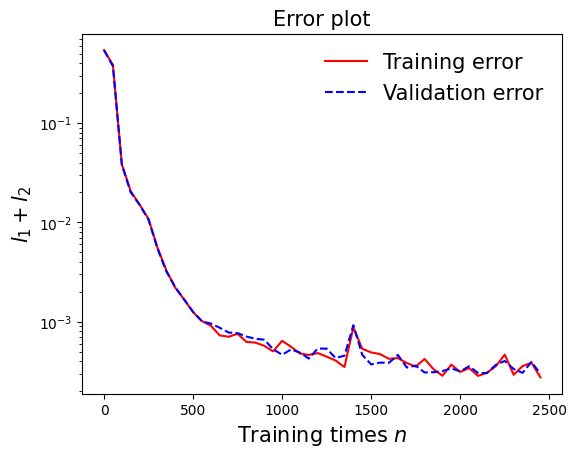

In [138]:
draw_loss(model8)

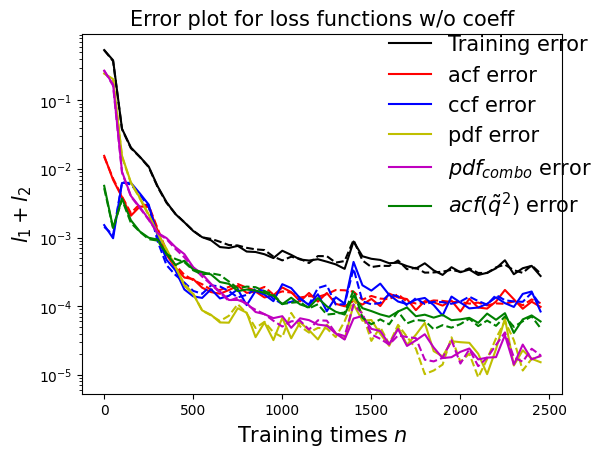

In [139]:
draw_errors(model8)

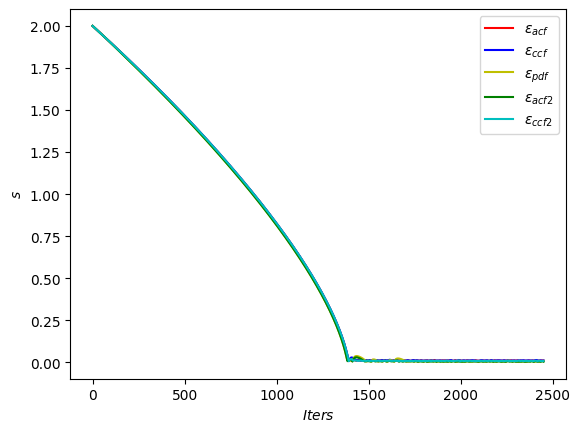

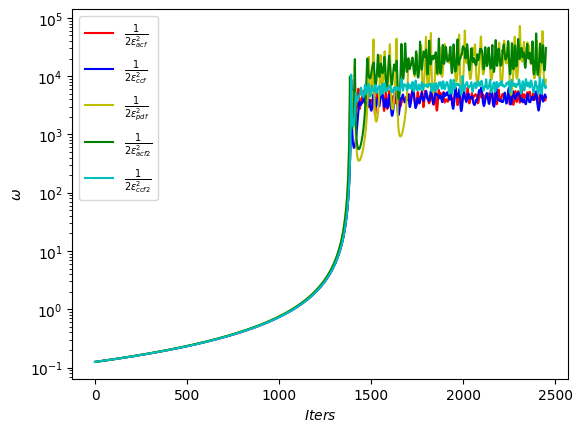

In [140]:
draw_adaptive_w(model8)
draw_epoch_w(model8)

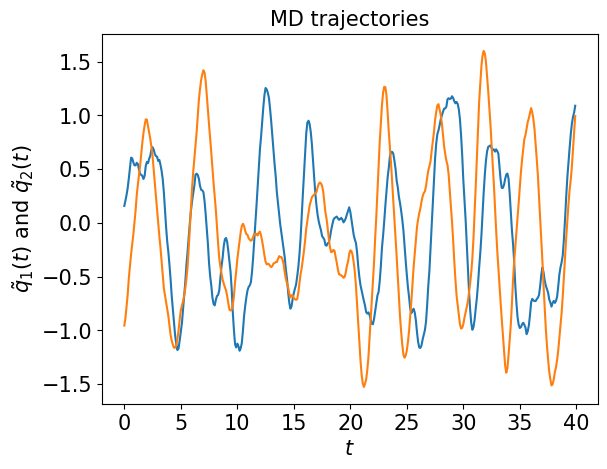

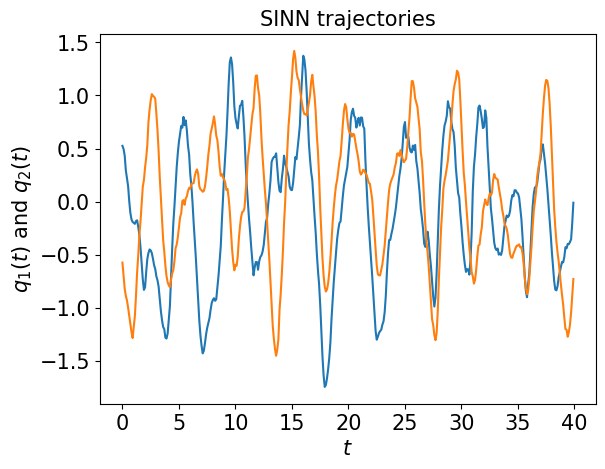

In [141]:
test1(model8)

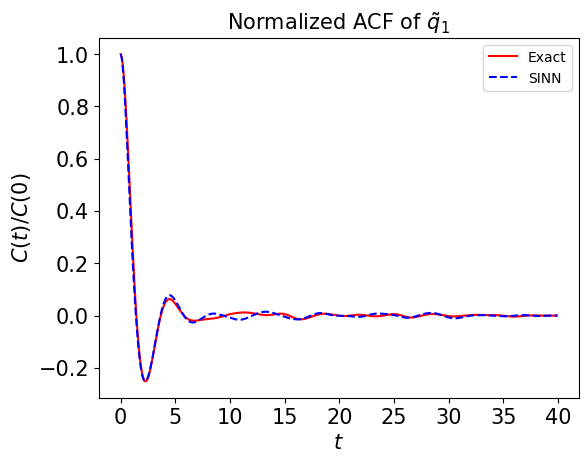

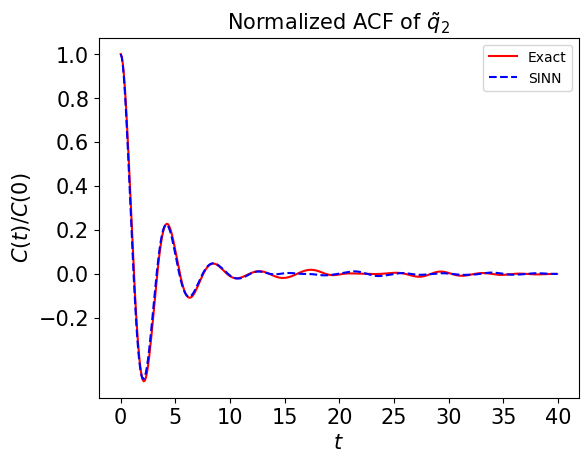

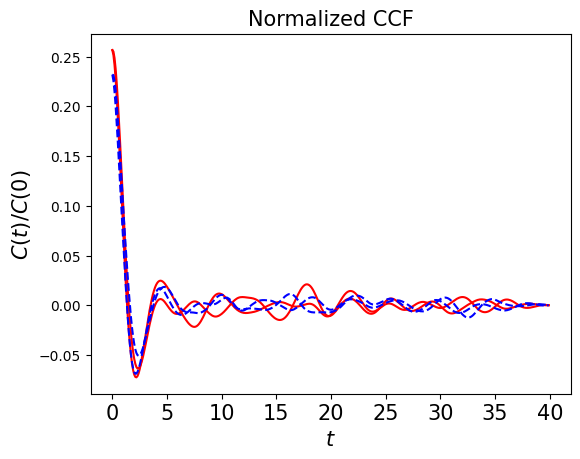

In [142]:
test2(model8)

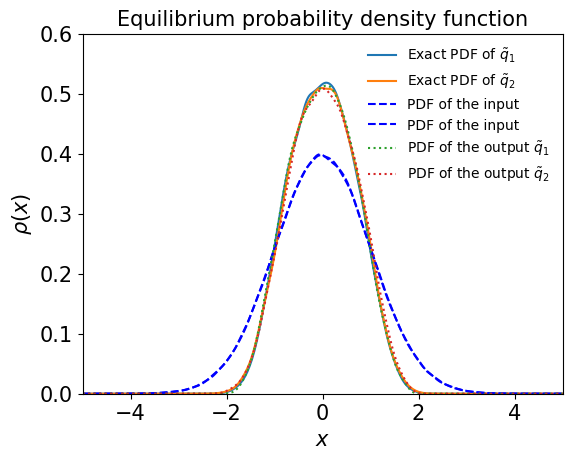

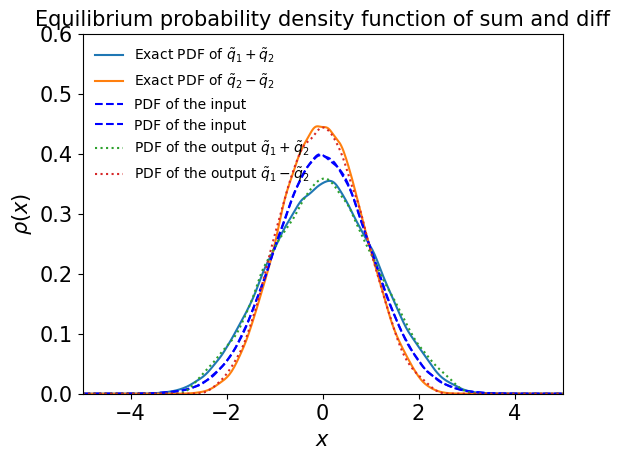

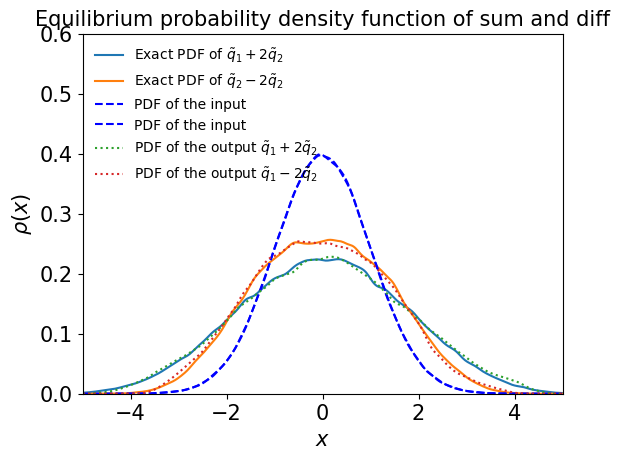

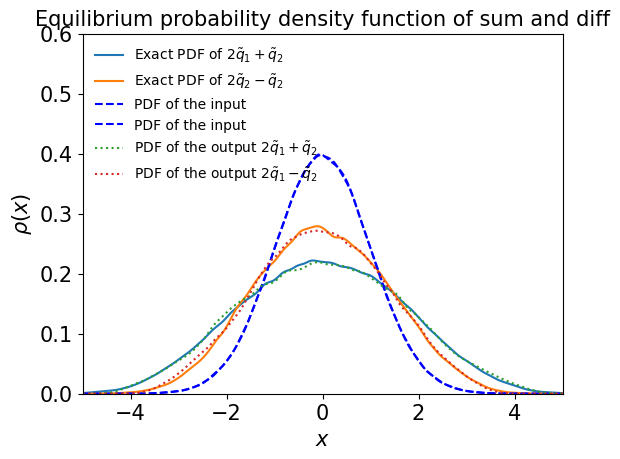

In [143]:
test3(model8)

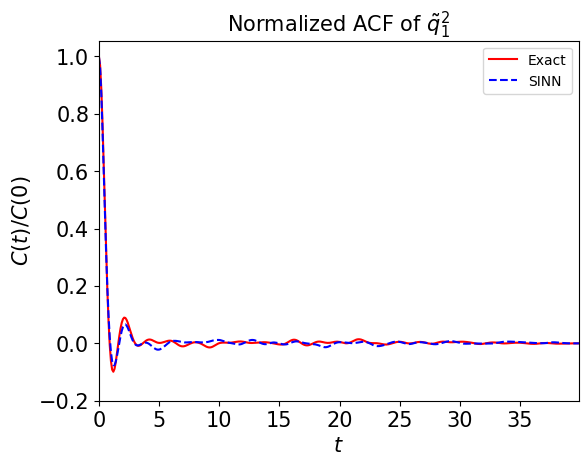

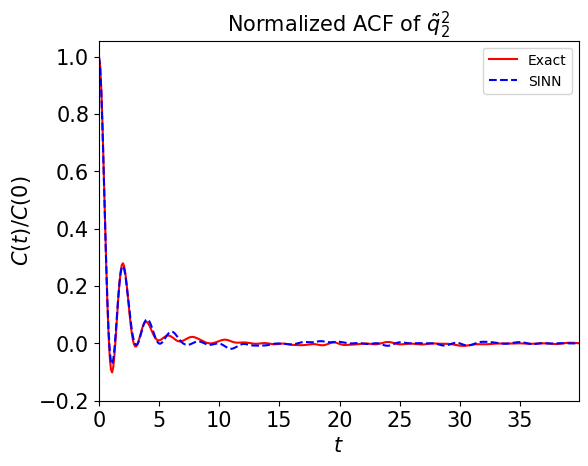

In [144]:
test4(model8)

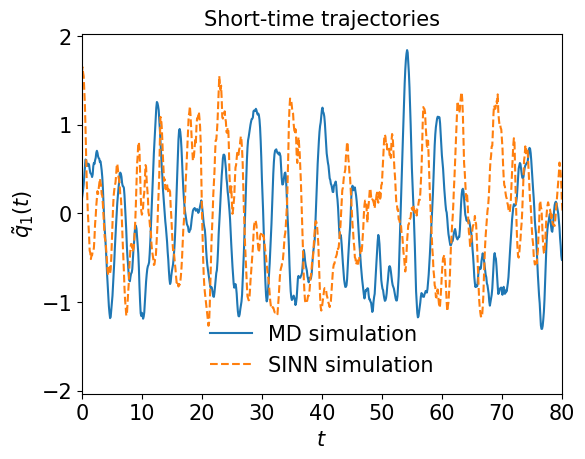

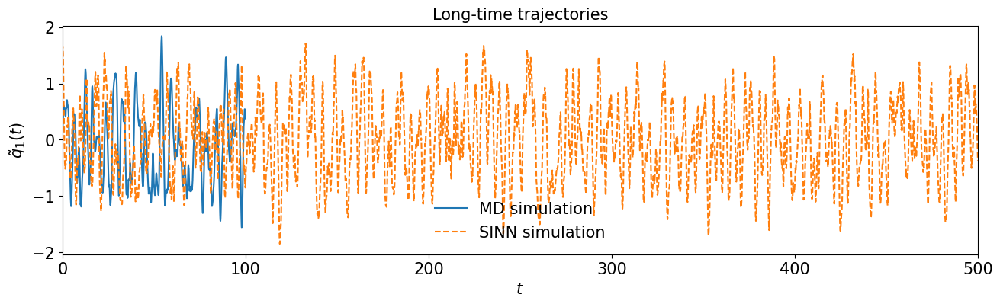

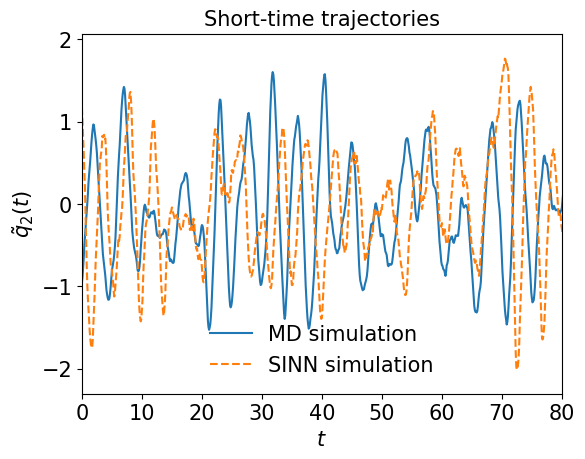

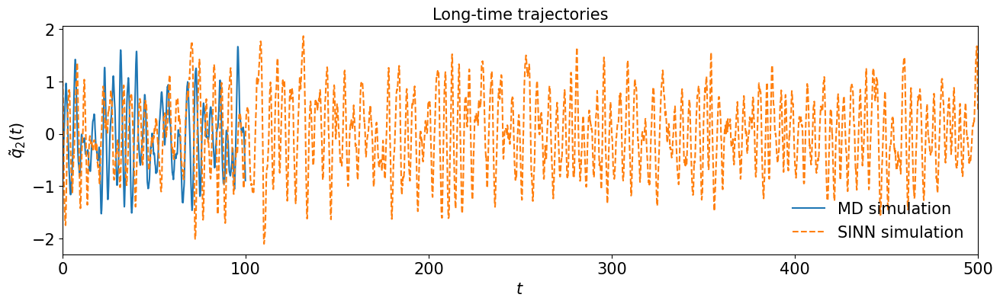

In [145]:
test5(model8)

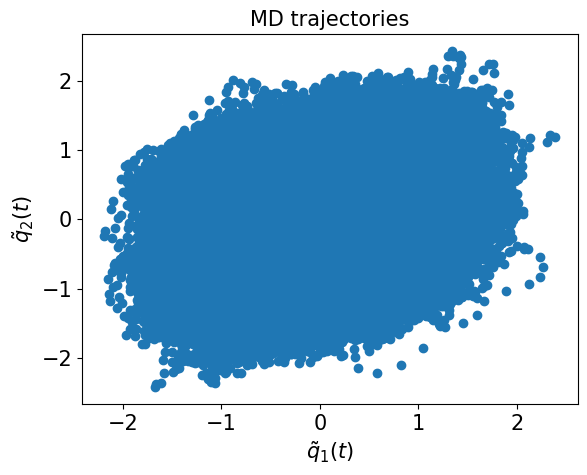

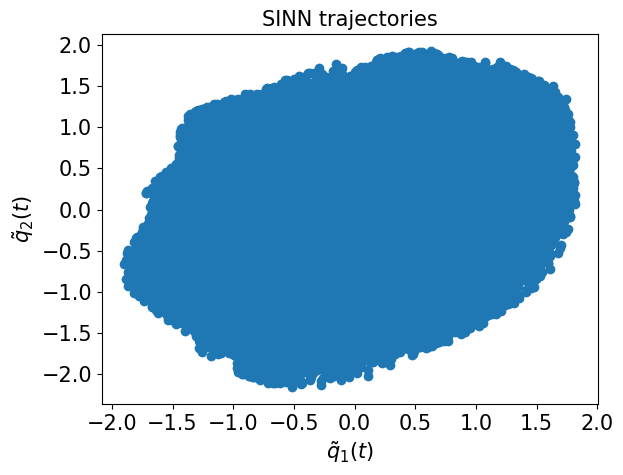

In [146]:
test6(model8)

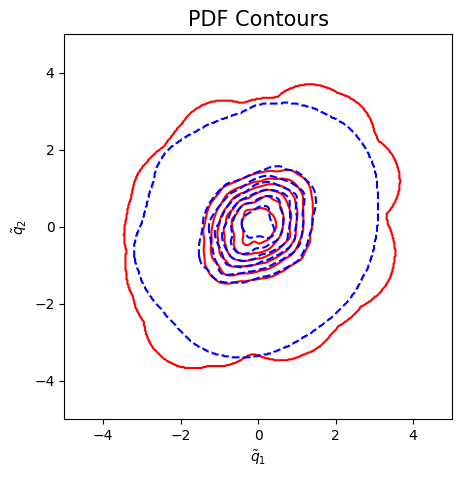

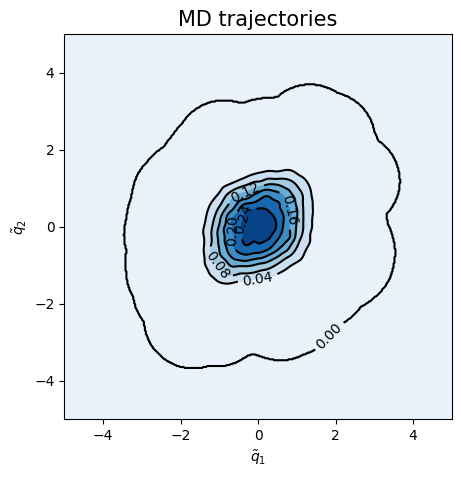

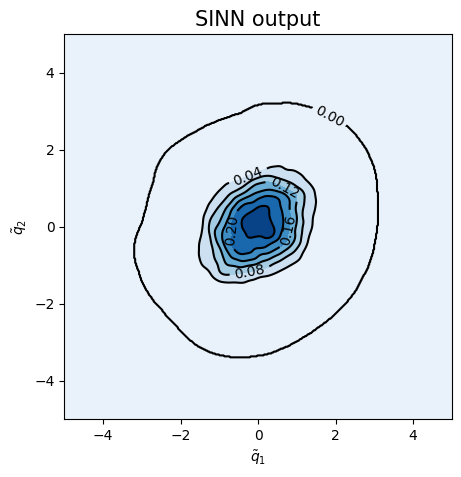

<Figure size 500x500 with 0 Axes>

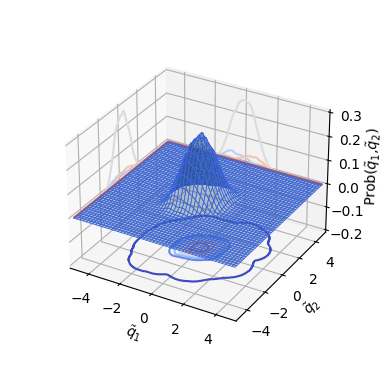

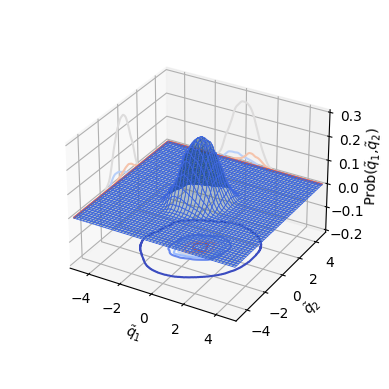

In [147]:
test7(model8)

In [148]:
### Defining SINN model
net9 = SINN(2, 10, 2, 2).to(device)

In [149]:
model9 = Model(net=net9)

In [150]:
model9.train()

[0]-th step loss: 0.5374, 0.5365, acf: 0.01156, ccf: 0.00724, pdf: 0.24652, pdf2: 0.26836, acf2: 0.00287
[50]-th step loss: 0.3139, 0.3038, acf: 0.00775, ccf: 0.00050, pdf: 0.17567, pdf2: 0.11851, acf2: 0.00132
[100]-th step loss: 0.0443, 0.0429, acf: 0.00837, ccf: 0.00541, pdf: 0.01676, pdf2: 0.01107, acf2: 0.00130
[150]-th step loss: 0.0116, 0.0118, acf: 0.00671, ccf: 0.00058, pdf: 0.00152, pdf2: 0.00172, acf2: 0.00125
[200]-th step loss: 0.0089, 0.0092, acf: 0.00509, ccf: 0.00082, pdf: 0.00089, pdf2: 0.00131, acf2: 0.00108
[250]-th step loss: 0.0079, 0.0080, acf: 0.00453, ccf: 0.00076, pdf: 0.00062, pdf2: 0.00104, acf2: 0.00106
[300]-th step loss: 0.0062, 0.0064, acf: 0.00370, ccf: 0.00065, pdf: 0.00042, pdf2: 0.00061, acf2: 0.00103
[350]-th step loss: 0.0036, 0.0037, acf: 0.00186, ccf: 0.00046, pdf: 0.00019, pdf2: 0.00030, acf2: 0.00085
[400]-th step loss: 0.0019, 0.0018, acf: 0.00058, ccf: 0.00031, pdf: 0.00020, pdf2: 0.00026, acf2: 0.00047
[450]-th step loss: 0.0014, 0.0012, acf:

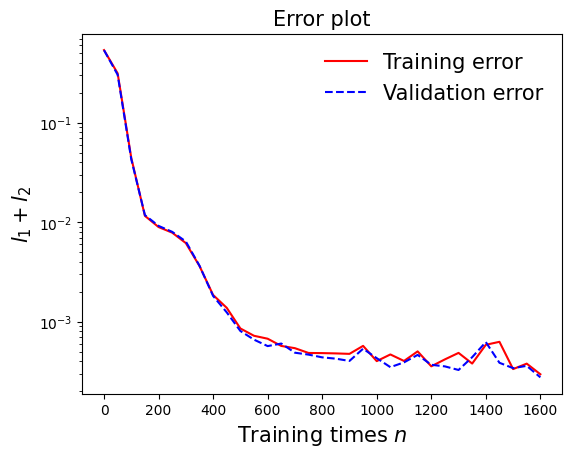

In [151]:
draw_loss(model9)

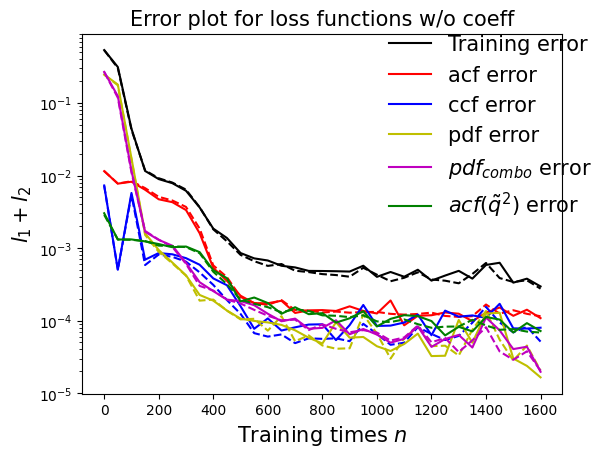

In [152]:
draw_errors(model9)

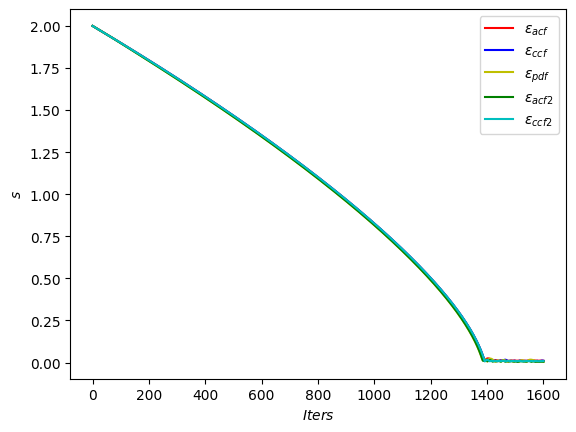

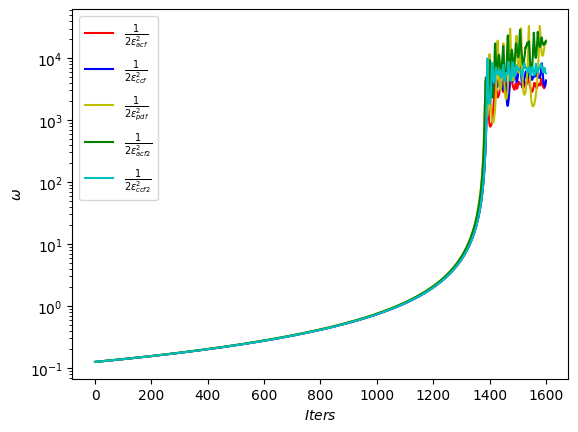

In [153]:
draw_adaptive_w(model9)
draw_epoch_w(model9)

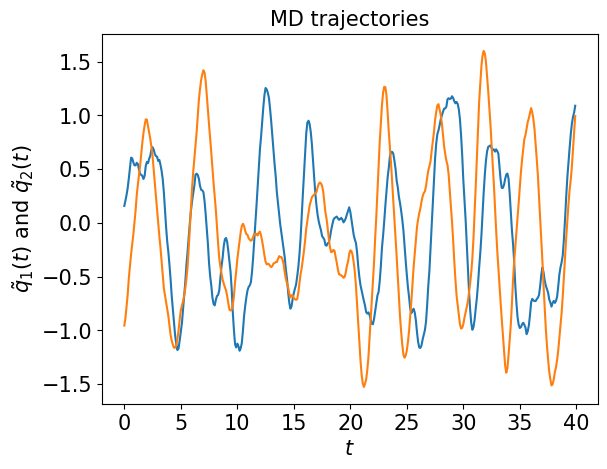

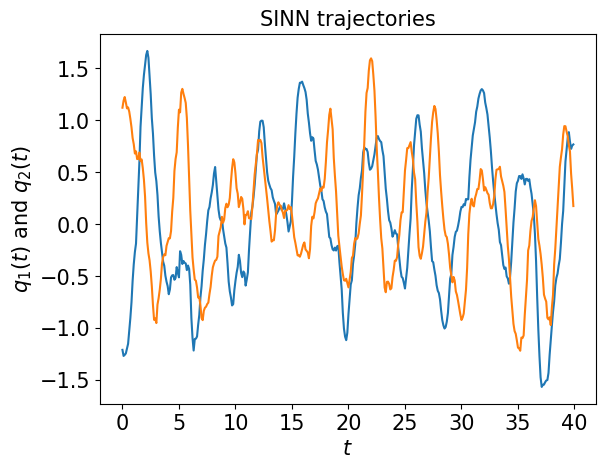

In [154]:
test1(model9)

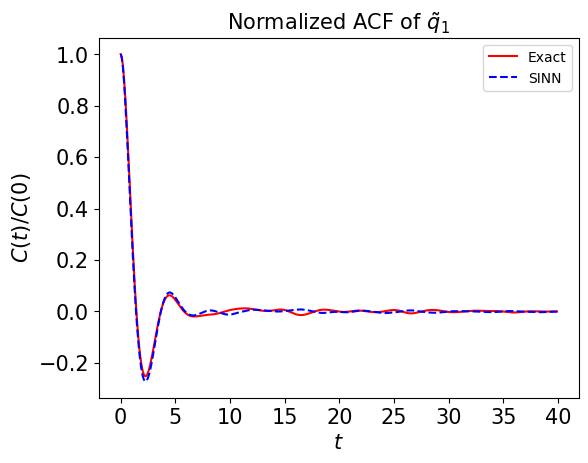

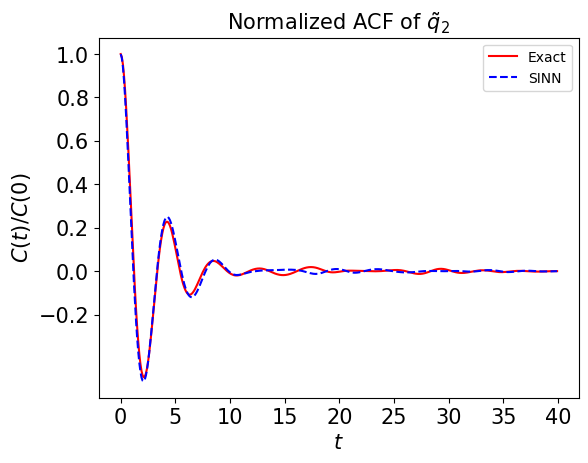

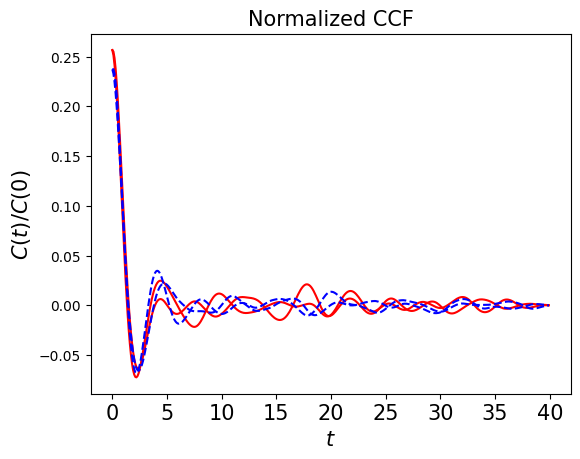

In [155]:
test2(model9)

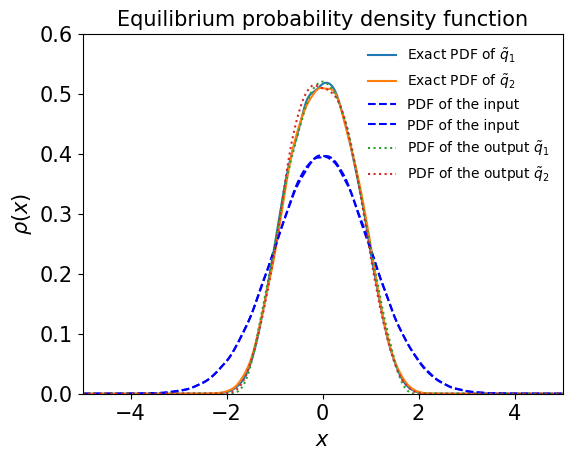

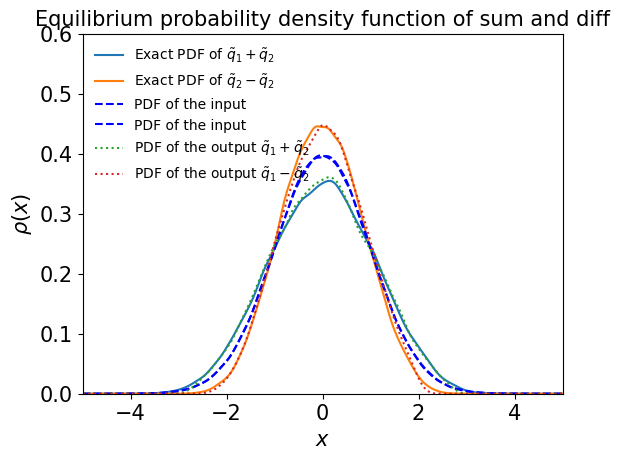

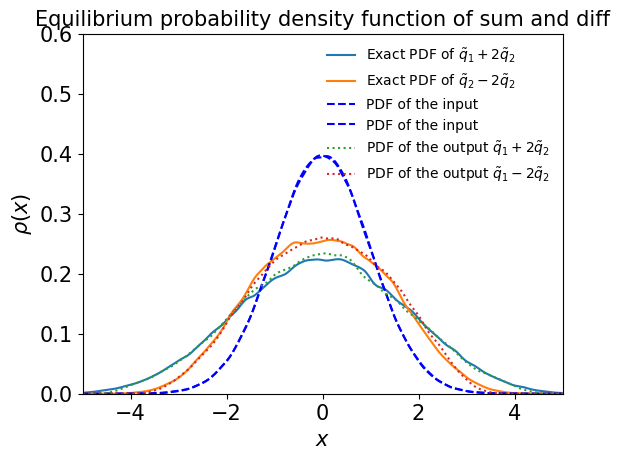

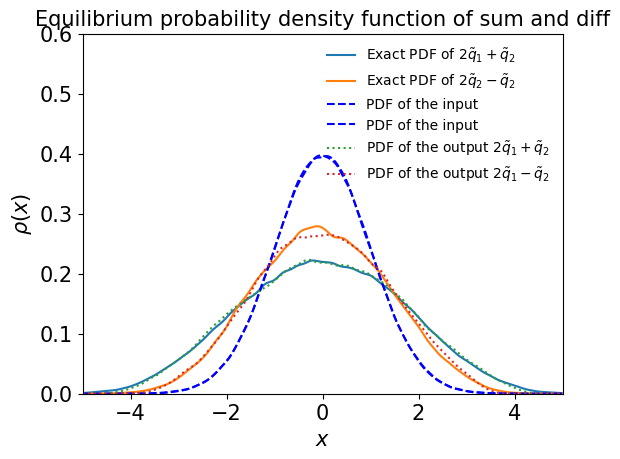

In [156]:
test3(model9)

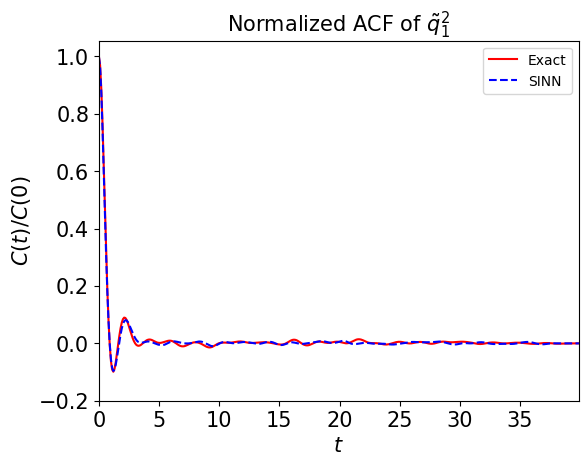

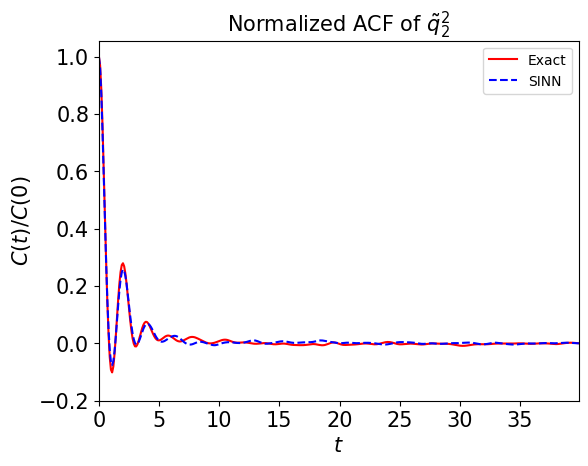

In [157]:
test4(model9)

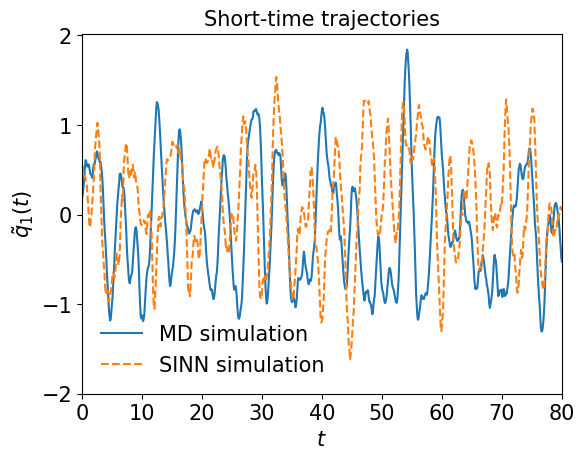

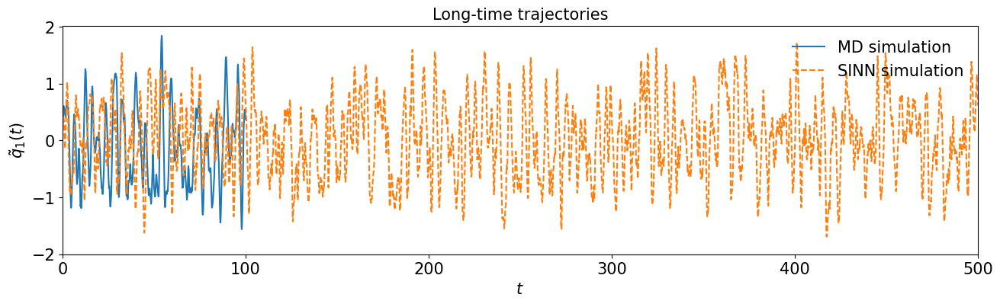

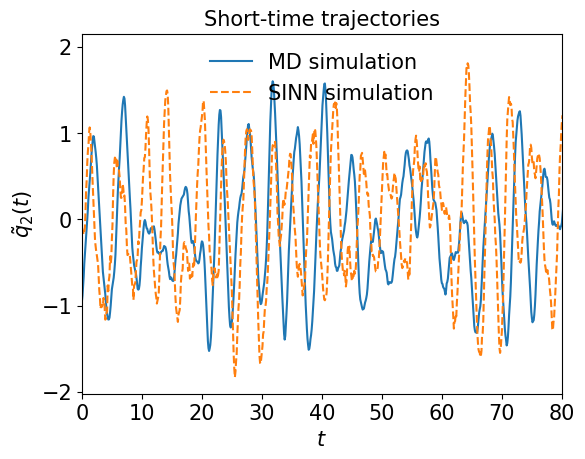

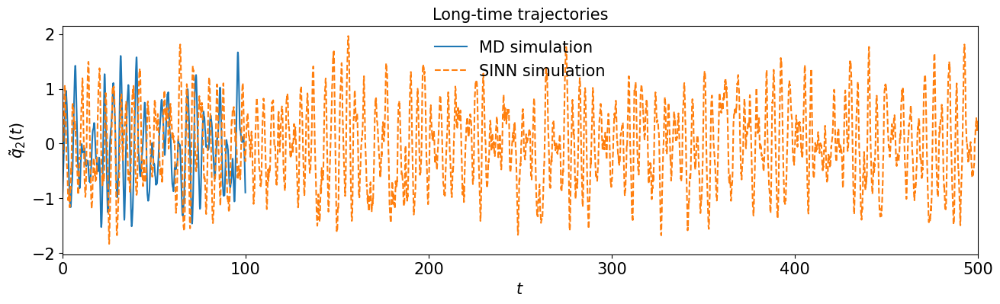

In [158]:
test5(model9)

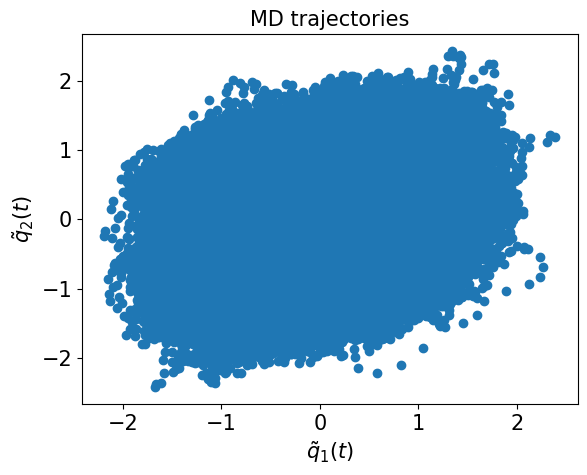

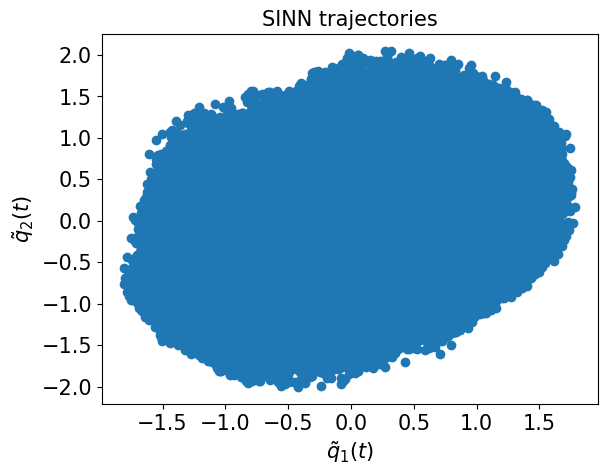

In [159]:
test6(model9)

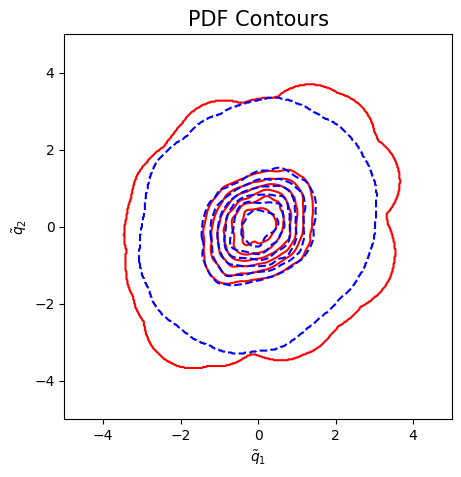

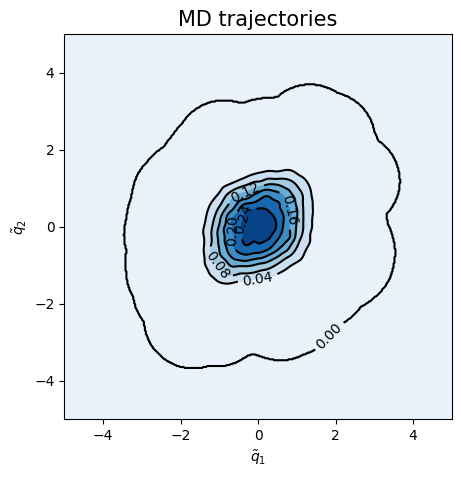

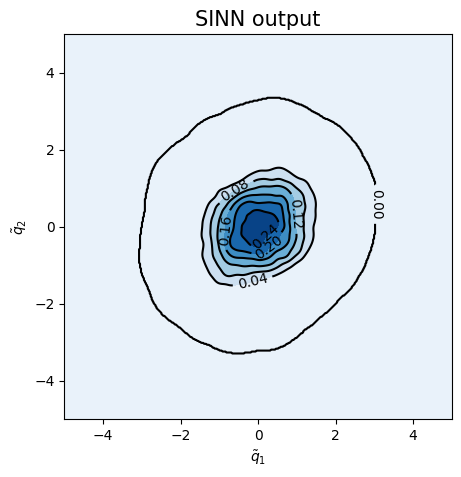

<Figure size 500x500 with 0 Axes>

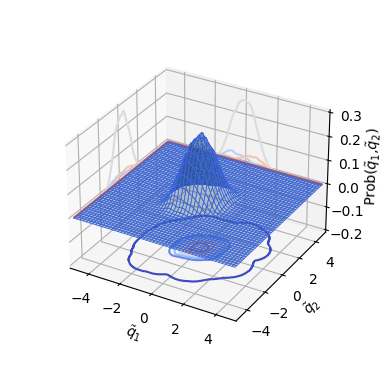

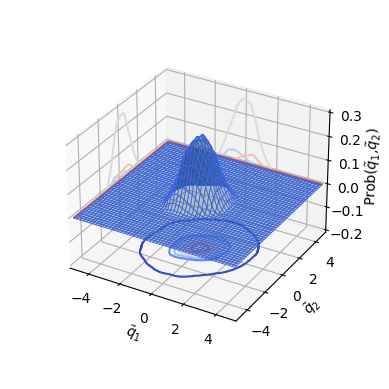

In [160]:
test7(model9)

In [161]:
### Defining SINN model
net10 = SINN(2, 10, 2, 2).to(device)

In [162]:
model10 = Model(net=net10)

In [163]:
model10.train()

[0]-th step loss: 0.5358, 0.5341, acf: 0.01352, ccf: 0.00147, pdf: 0.24704, pdf2: 0.26791, acf2: 0.00414
[50]-th step loss: 0.2081, 0.1968, acf: 0.00703, ccf: 0.00708, pdf: 0.09122, pdf2: 0.09023, acf2: 0.00128
[100]-th step loss: 0.0554, 0.0555, acf: 0.00834, ccf: 0.01042, pdf: 0.00815, pdf2: 0.02738, acf2: 0.00121
[150]-th step loss: 0.0415, 0.0415, acf: 0.00619, ccf: 0.00772, pdf: 0.00448, pdf2: 0.02198, acf2: 0.00111
[200]-th step loss: 0.0339, 0.0343, acf: 0.00540, ccf: 0.00636, pdf: 0.00296, pdf2: 0.01834, acf2: 0.00123
[250]-th step loss: 0.0271, 0.0270, acf: 0.00449, ccf: 0.00576, pdf: 0.00181, pdf2: 0.01364, acf2: 0.00128
[300]-th step loss: 0.0138, 0.0141, acf: 0.00329, ccf: 0.00522, pdf: 0.00067, pdf2: 0.00386, acf2: 0.00105
[350]-th step loss: 0.0094, 0.0095, acf: 0.00317, ccf: 0.00394, pdf: 0.00031, pdf2: 0.00122, acf2: 0.00084
[400]-th step loss: 0.0057, 0.0057, acf: 0.00217, ccf: 0.00188, pdf: 0.00033, pdf2: 0.00056, acf2: 0.00071
[450]-th step loss: 0.0039, 0.0037, acf:

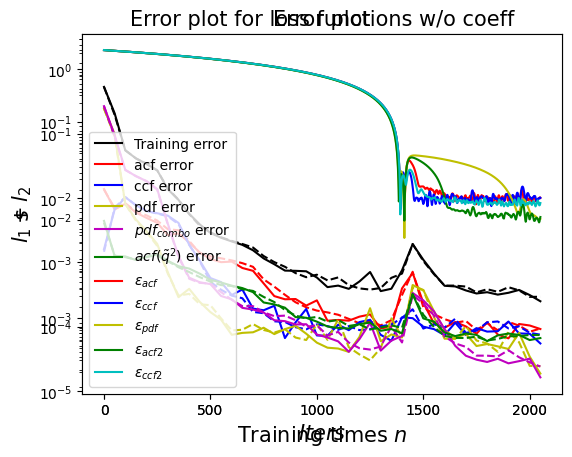

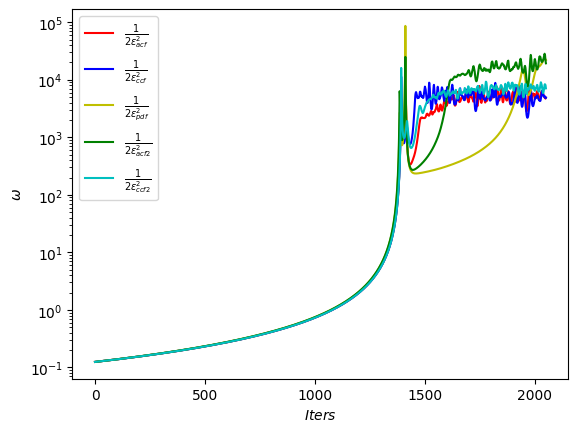

In [164]:
draw_loss(model10)
draw_errors(model10)
draw_adaptive_w(model10)
draw_epoch_w(model10)

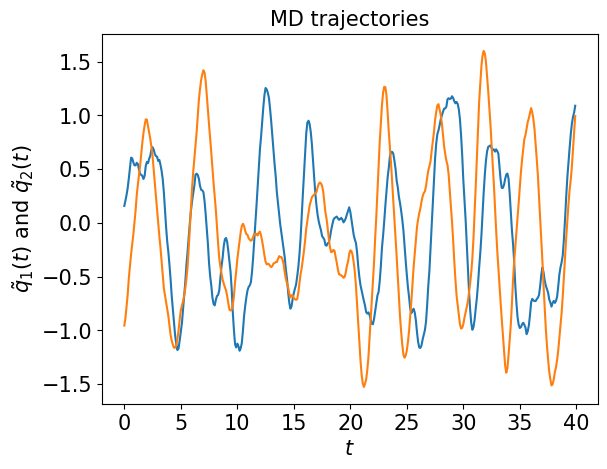

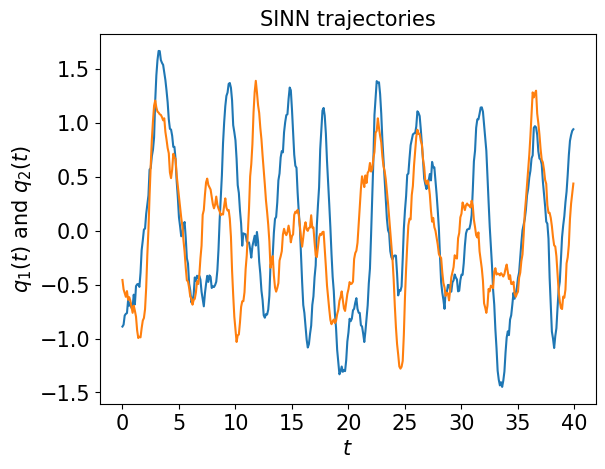

In [165]:
test1(model10)

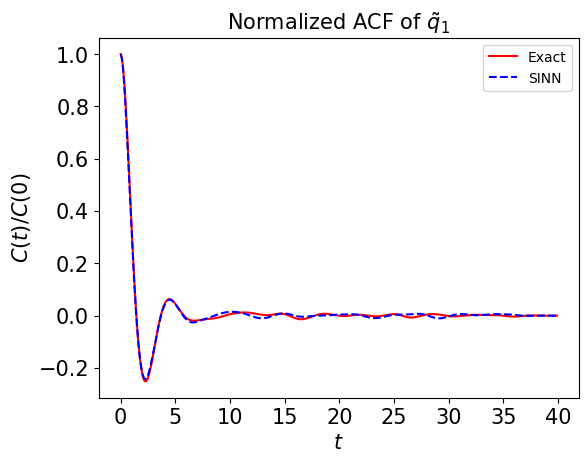

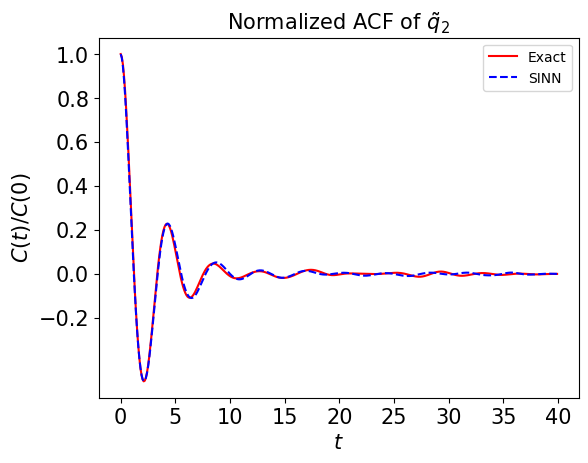

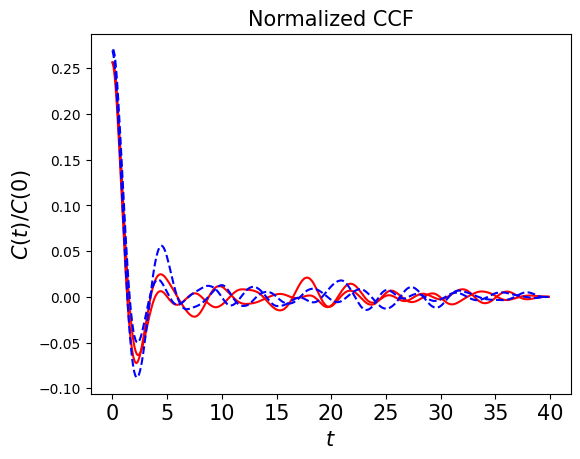

In [166]:
test2(model10)

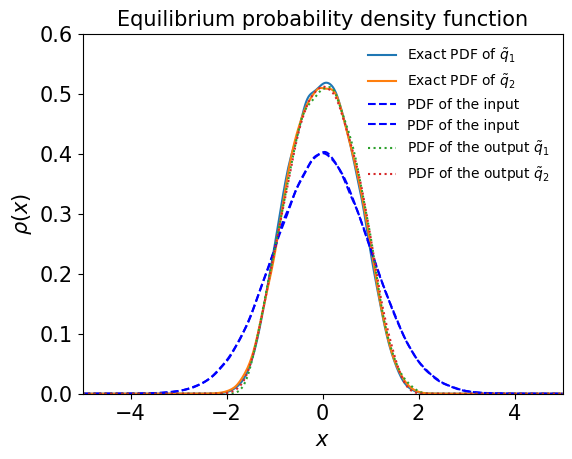

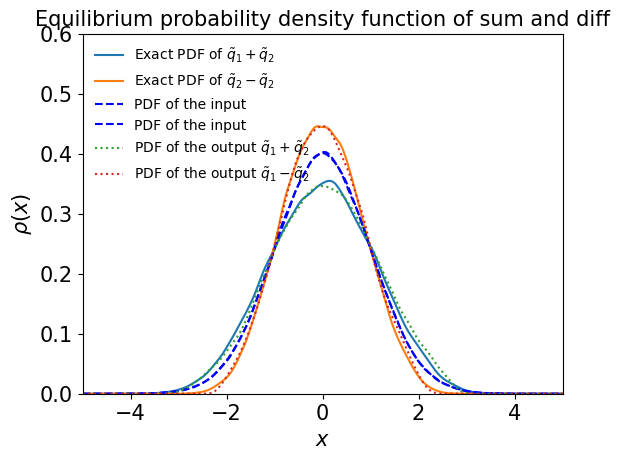

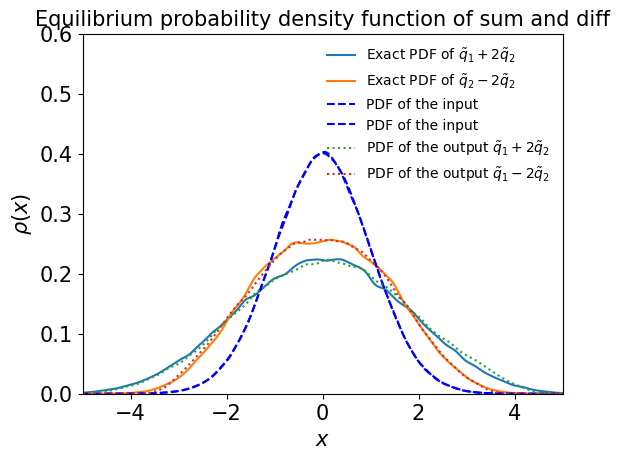

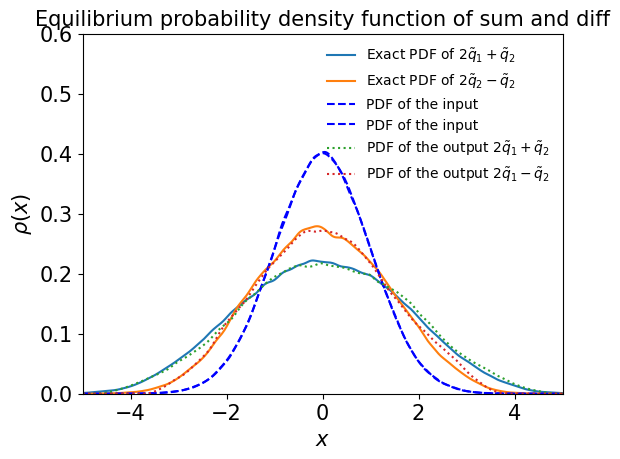

In [167]:
test3(model10)

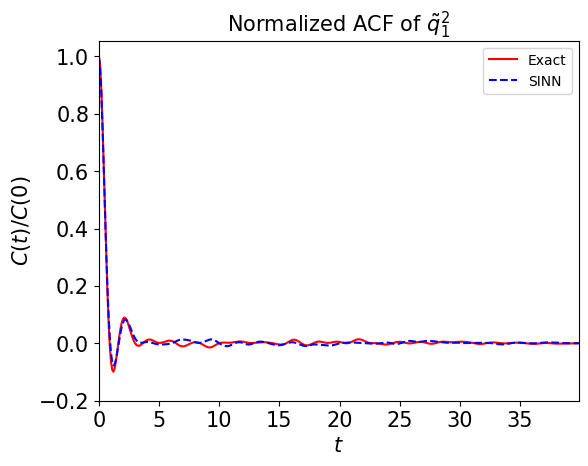

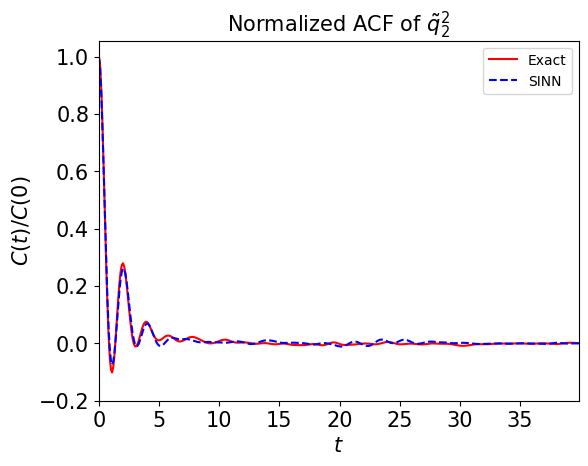

In [168]:
test4(model10)

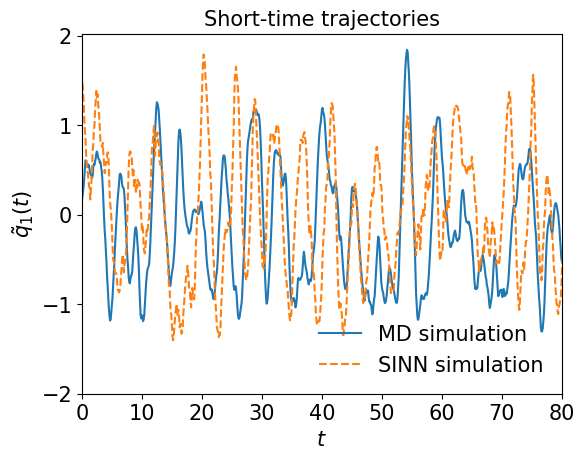

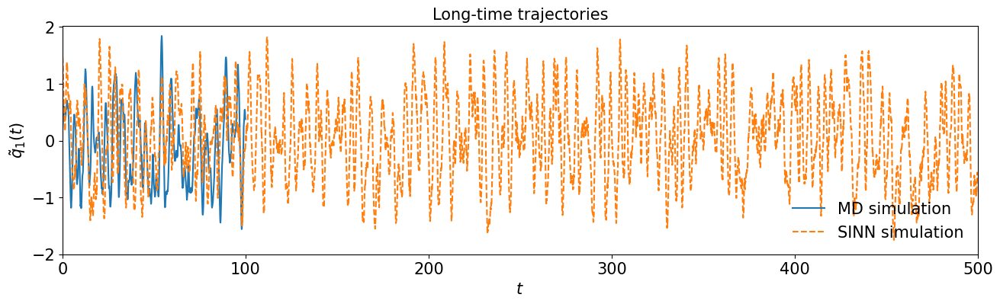

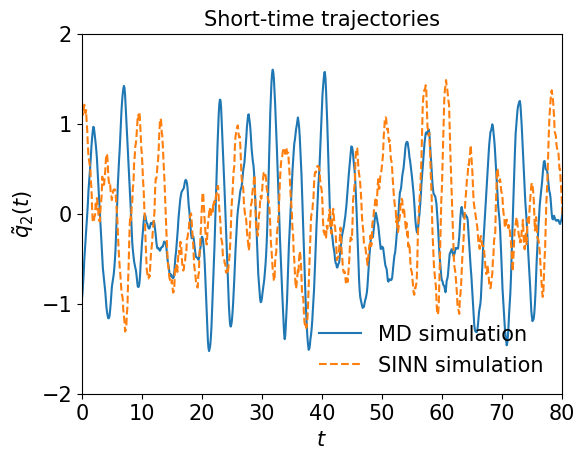

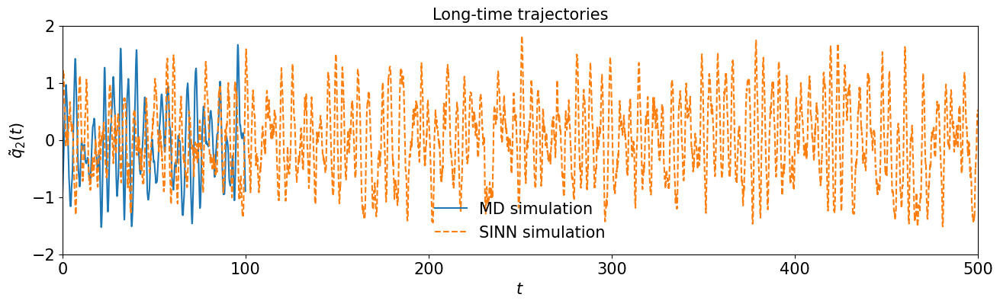

In [169]:
test5(model10)

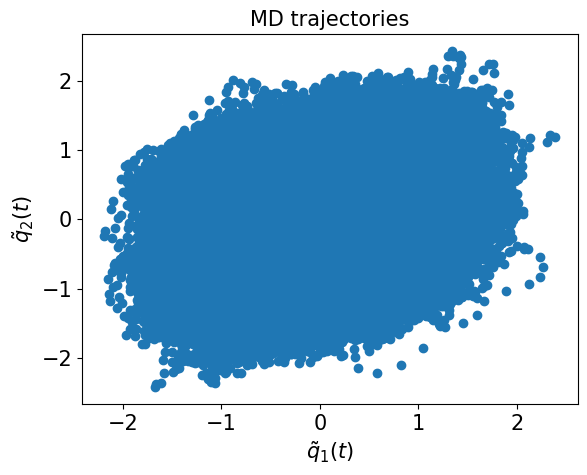

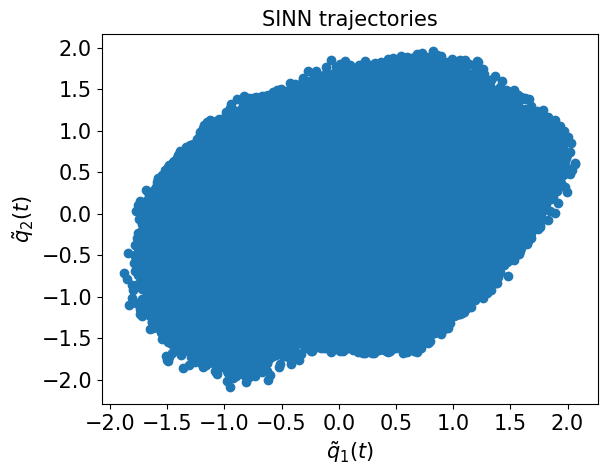

In [170]:
test6(model10)

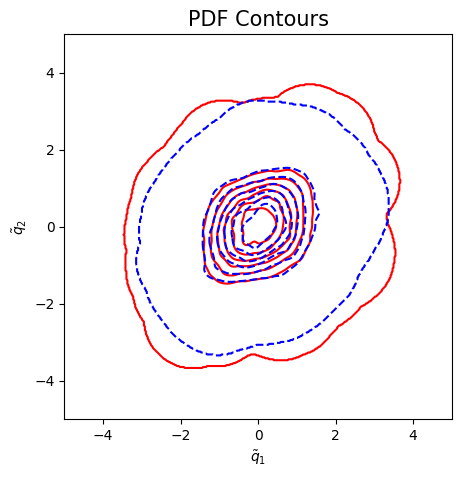

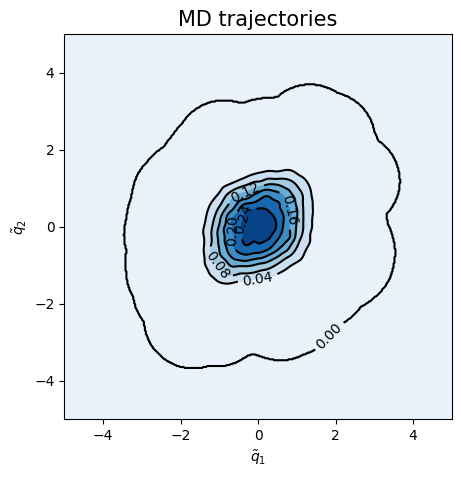

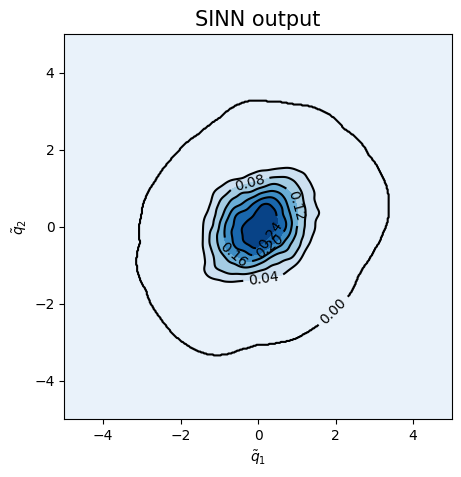

<Figure size 500x500 with 0 Axes>

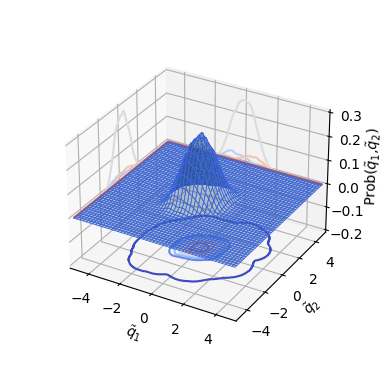

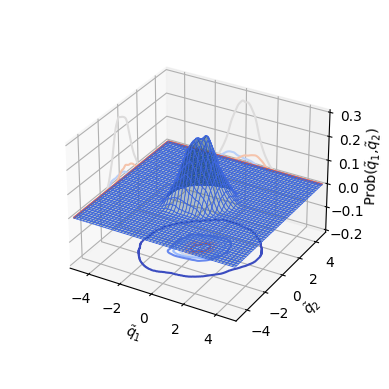

In [171]:
test7(model10)

In [172]:
### Defining SINN model
net11 = SINN(2, 10, 2, 2).to(device)
model11 = Model(net=net11)

In [173]:
model11.train()

[0]-th step loss: 0.5272, 0.5255, acf: 0.00850, ccf: 0.00644, pdf: 0.24450, pdf2: 0.26464, acf2: 0.00139
[50]-th step loss: 0.2128, 0.2048, acf: 0.00714, ccf: 0.00099, pdf: 0.13089, pdf2: 0.06457, acf2: 0.00118
[100]-th step loss: 0.0256, 0.0253, acf: 0.01035, ccf: 0.00037, pdf: 0.00832, pdf2: 0.00450, acf2: 0.00173
[150]-th step loss: 0.0140, 0.0143, acf: 0.00752, ccf: 0.00032, pdf: 0.00304, pdf2: 0.00228, acf2: 0.00112
[200]-th step loss: 0.0106, 0.0107, acf: 0.00610, ccf: 0.00039, pdf: 0.00149, pdf2: 0.00164, acf2: 0.00106
[250]-th step loss: 0.0090, 0.0092, acf: 0.00543, ccf: 0.00045, pdf: 0.00087, pdf2: 0.00136, acf2: 0.00107
[300]-th step loss: 0.0080, 0.0082, acf: 0.00472, ccf: 0.00059, pdf: 0.00064, pdf2: 0.00120, acf2: 0.00106
[350]-th step loss: 0.0067, 0.0069, acf: 0.00364, ccf: 0.00076, pdf: 0.00050, pdf2: 0.00103, acf2: 0.00101
[400]-th step loss: 0.0042, 0.0043, acf: 0.00176, ccf: 0.00066, pdf: 0.00036, pdf2: 0.00070, acf2: 0.00080
[450]-th step loss: 0.0027, 0.0028, acf:

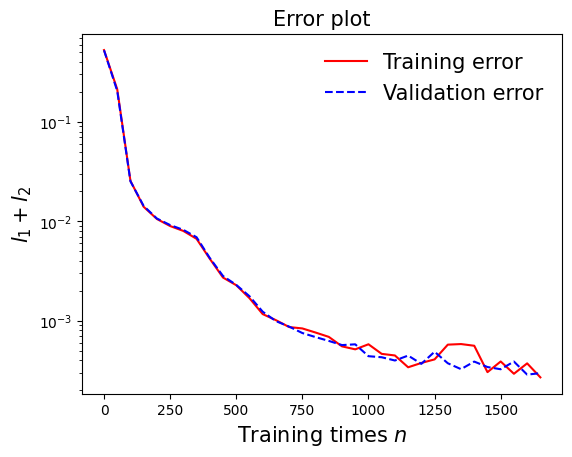

In [174]:
draw_loss(model11)

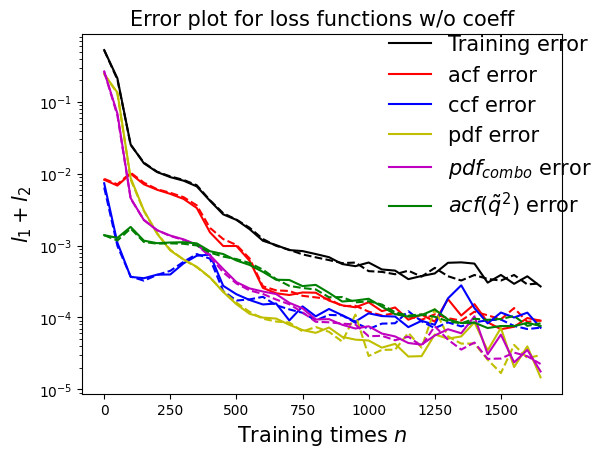

In [175]:
draw_errors(model11)

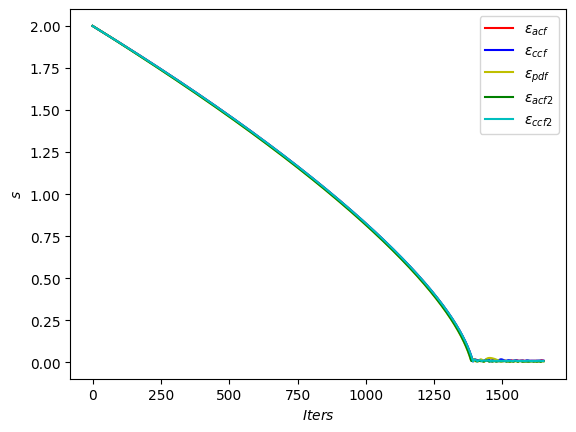

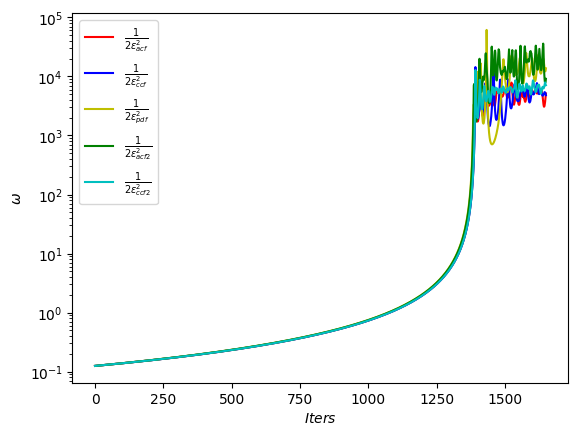

In [176]:
draw_adaptive_w(model11)
draw_epoch_w(model11)

In [177]:
### Defining SINN model
net12 = SINN(2, 10, 2, 2).to(device)
model12 = Model(net=net12)
model12.train()

[0]-th step loss: 0.5411, 0.5399, acf: 0.01313, ccf: 0.00368, pdf: 0.24763, pdf2: 0.27163, acf2: 0.00387
[50]-th step loss: 0.2757, 0.2632, acf: 0.00629, ccf: 0.00635, pdf: 0.13065, pdf2: 0.11812, acf2: 0.00181
[100]-th step loss: 0.0601, 0.0602, acf: 0.00832, ccf: 0.01074, pdf: 0.01099, pdf2: 0.02873, acf2: 0.00139
[150]-th step loss: 0.0318, 0.0315, acf: 0.00496, ccf: 0.00650, pdf: 0.00461, pdf2: 0.01433, acf2: 0.00111
[200]-th step loss: 0.0162, 0.0158, acf: 0.00344, ccf: 0.00559, pdf: 0.00145, pdf2: 0.00426, acf2: 0.00109
[250]-th step loss: 0.0105, 0.0102, acf: 0.00298, ccf: 0.00354, pdf: 0.00055, pdf2: 0.00229, acf2: 0.00087
[300]-th step loss: 0.0066, 0.0065, acf: 0.00228, ccf: 0.00189, pdf: 0.00028, pdf2: 0.00128, acf2: 0.00077
[350]-th step loss: 0.0043, 0.0043, acf: 0.00156, ccf: 0.00104, pdf: 0.00016, pdf2: 0.00089, acf2: 0.00063
[400]-th step loss: 0.0022, 0.0023, acf: 0.00082, ccf: 0.00033, pdf: 0.00009, pdf2: 0.00066, acf2: 0.00038
[450]-th step loss: 0.0013, 0.0012, acf:

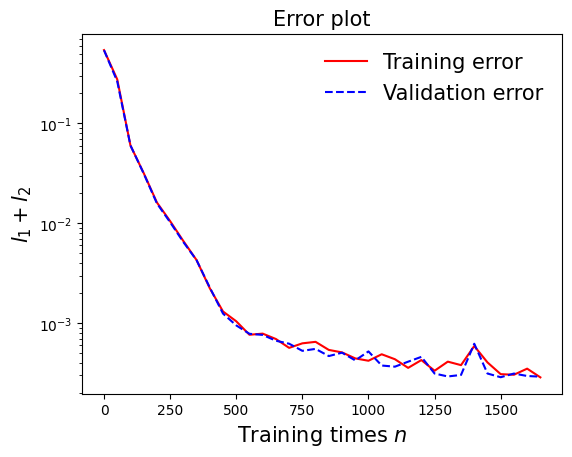

In [178]:
draw_loss(model12)

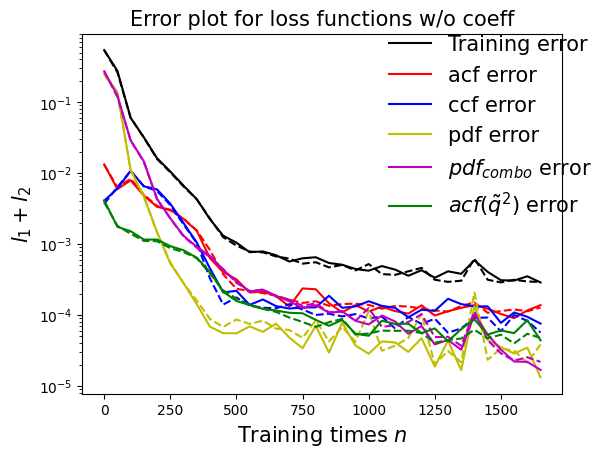

In [179]:
draw_errors(model12)

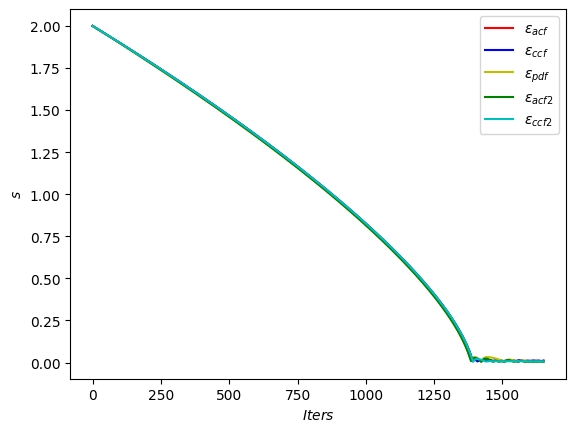

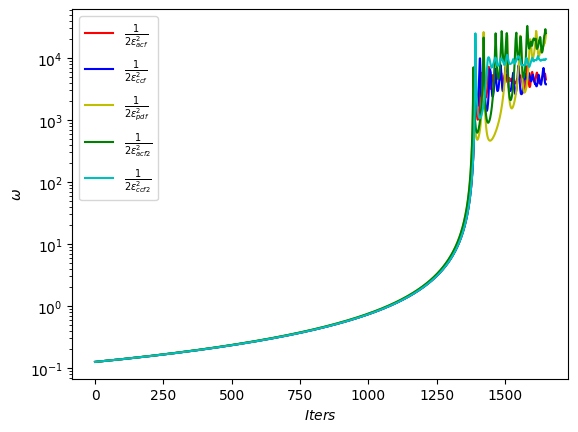

In [180]:
draw_adaptive_w(model12)
draw_epoch_w(model12)

In [181]:
### Defining SINN model
net13 = SINN(2, 10, 2, 2).to(device)
model13 = Model(net=net13)
model13.train()

[0]-th step loss: 0.5356, 0.5343, acf: 0.01317, ccf: 0.00799, pdf: 0.24541, pdf2: 0.26390, acf2: 0.00381
[50]-th step loss: 0.2374, 0.2275, acf: 0.00893, ccf: 0.00681, pdf: 0.13660, pdf2: 0.07208, acf2: 0.00311
[100]-th step loss: 0.0504, 0.0490, acf: 0.00537, ccf: 0.01095, pdf: 0.01707, pdf2: 0.01368, acf2: 0.00197
[150]-th step loss: 0.0246, 0.0243, acf: 0.00331, ccf: 0.00978, pdf: 0.00326, pdf2: 0.00609, acf2: 0.00191
[200]-th step loss: 0.0192, 0.0189, acf: 0.00339, ccf: 0.00908, pdf: 0.00150, pdf2: 0.00295, acf2: 0.00195
[250]-th step loss: 0.0149, 0.0148, acf: 0.00317, ccf: 0.00843, pdf: 0.00069, pdf2: 0.00139, acf2: 0.00115
[300]-th step loss: 0.0129, 0.0129, acf: 0.00250, ccf: 0.00776, pdf: 0.00051, pdf2: 0.00119, acf2: 0.00089
[350]-th step loss: 0.0111, 0.0111, acf: 0.00211, ccf: 0.00636, pdf: 0.00045, pdf2: 0.00130, acf2: 0.00087
[400]-th step loss: 0.0081, 0.0081, acf: 0.00190, ccf: 0.00397, pdf: 0.00039, pdf2: 0.00118, acf2: 0.00065
[450]-th step loss: 0.0046, 0.0046, acf:

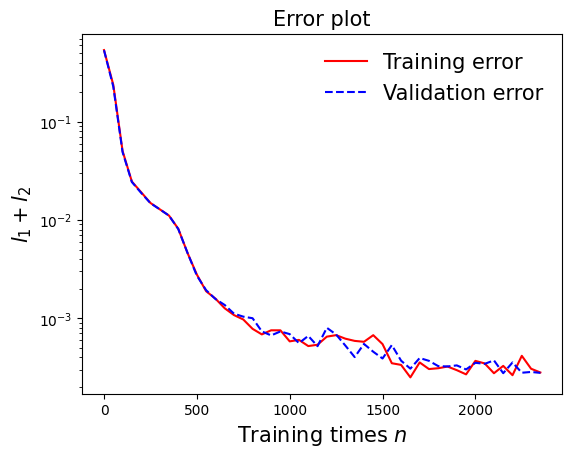

In [182]:
draw_loss(model13)

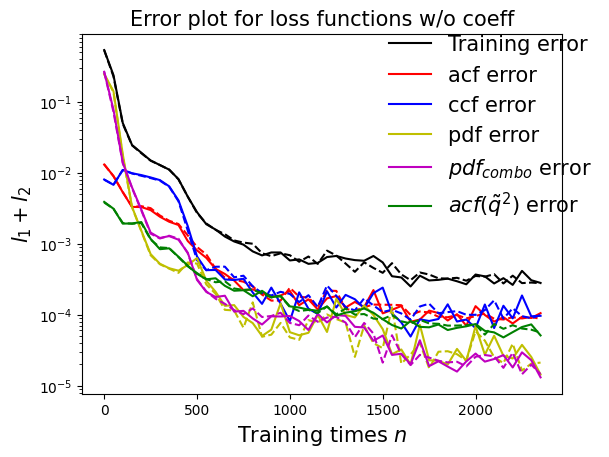

In [183]:
draw_errors(model13)

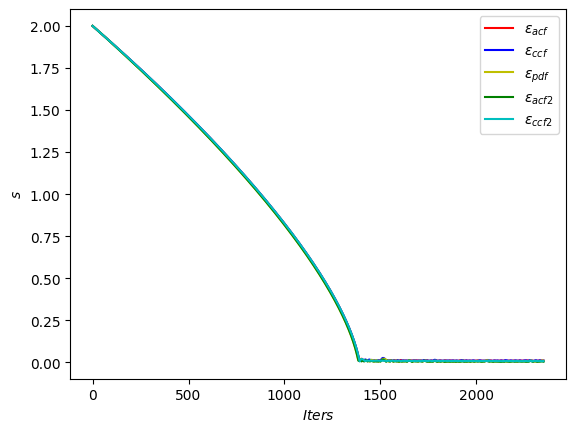

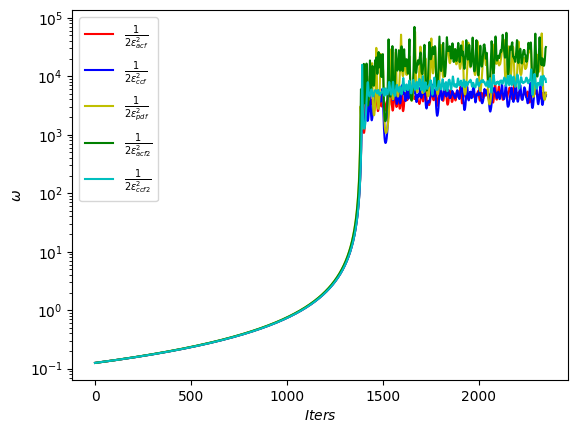

In [184]:
draw_adaptive_w(model13)
draw_epoch_w(model13)

In [185]:
### Defining SINN model
net14 = SINN(2, 10, 2, 2).to(device)
model14 = Model(net=net14)
model14.train()

[0]-th step loss: 0.5356, 0.5339, acf: 0.01146, ccf: 0.00921, pdf: 0.24445, pdf2: 0.26591, acf2: 0.00284
[50]-th step loss: 0.1857, 0.1776, acf: 0.00657, ccf: 0.02105, pdf: 0.06453, pdf2: 0.08411, acf2: 0.00134
[100]-th step loss: 0.0709, 0.0706, acf: 0.00625, ccf: 0.02295, pdf: 0.00875, pdf2: 0.03152, acf2: 0.00112
[150]-th step loss: 0.0444, 0.0442, acf: 0.00426, ccf: 0.01887, pdf: 0.00343, pdf2: 0.01609, acf2: 0.00151
[200]-th step loss: 0.0314, 0.0310, acf: 0.00253, ccf: 0.01542, pdf: 0.00267, pdf2: 0.00911, acf2: 0.00129
[250]-th step loss: 0.0244, 0.0246, acf: 0.00312, ccf: 0.01211, pdf: 0.00237, pdf2: 0.00553, acf2: 0.00145
[300]-th step loss: 0.0181, 0.0181, acf: 0.00312, ccf: 0.01010, pdf: 0.00175, pdf2: 0.00195, acf2: 0.00114
[350]-th step loss: 0.0107, 0.0104, acf: 0.00183, ccf: 0.00576, pdf: 0.00108, pdf2: 0.00089, acf2: 0.00088
[400]-th step loss: 0.0229, 0.0220, acf: 0.00408, ccf: 0.00466, pdf: 0.00639, pdf2: 0.00358, acf2: 0.00331
[450]-th step loss: 0.0079, 0.0075, acf:

[3850]-th step loss: 0.0072, 0.0074, acf: 0.00589, ccf: 0.00023, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00124
[3900]-th step loss: 0.0069, 0.0073, acf: 0.00578, ccf: 0.00021, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00122
[3950]-th step loss: 0.0068, 0.0071, acf: 0.00564, ccf: 0.00019, pdf: 0.00004, pdf2: 0.00002, acf2: 0.00120
[4000]-th step loss: 0.0068, 0.0070, acf: 0.00551, ccf: 0.00019, pdf: 0.00004, pdf2: 0.00003, acf2: 0.00119
[4050]-th step loss: 0.0066, 0.0068, acf: 0.00541, ccf: 0.00019, pdf: 0.00004, pdf2: 0.00002, acf2: 0.00117
[4100]-th step loss: 0.0065, 0.0066, acf: 0.00525, ccf: 0.00016, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00114
[4150]-th step loss: 0.0063, 0.0064, acf: 0.00511, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00113
[4200]-th step loss: 0.0060, 0.0063, acf: 0.00500, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00112
[4250]-th step loss: 0.0062, 0.0062, acf: 0.00488, ccf: 0.00012, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00110
[4300]-th step loss: 0.0055,

[7650]-th step loss: 0.0018, 0.0021, acf: 0.00145, ccf: 0.00009, pdf: 0.00004, pdf2: 0.00002, acf2: 0.00046
[7700]-th step loss: 0.0016, 0.0019, acf: 0.00134, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00043
[7750]-th step loss: 0.0018, 0.0019, acf: 0.00133, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00043
[7800]-th step loss: 0.0016, 0.0018, acf: 0.00131, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00043
[7850]-th step loss: 0.0018, 0.0018, acf: 0.00131, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00044
[7900]-th step loss: 0.0018, 0.0018, acf: 0.00130, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00043
[7950]-th step loss: 0.0016, 0.0018, acf: 0.00129, ccf: 0.00007, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00042
[8000]-th step loss: 0.0019, 0.0018, acf: 0.00131, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00042
[8050]-th step loss: 0.0016, 0.0018, acf: 0.00128, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00042
[8100]-th step loss: 0.0015,

[11450]-th step loss: 0.0032, 0.0034, acf: 0.00205, ccf: 0.00007, pdf: 0.00023, pdf2: 0.00026, acf2: 0.00080
[11500]-th step loss: 0.0032, 0.0033, acf: 0.00203, ccf: 0.00007, pdf: 0.00020, pdf2: 0.00024, acf2: 0.00078
[11550]-th step loss: 0.0031, 0.0032, acf: 0.00201, ccf: 0.00008, pdf: 0.00017, pdf2: 0.00021, acf2: 0.00075
[11600]-th step loss: 0.0032, 0.0031, acf: 0.00195, ccf: 0.00009, pdf: 0.00018, pdf2: 0.00018, acf2: 0.00073
[11650]-th step loss: 0.0028, 0.0030, acf: 0.00190, ccf: 0.00008, pdf: 0.00018, pdf2: 0.00016, acf2: 0.00070
[11700]-th step loss: 0.0028, 0.0029, acf: 0.00184, ccf: 0.00008, pdf: 0.00017, pdf2: 0.00015, acf2: 0.00068
[11750]-th step loss: 0.0028, 0.0028, acf: 0.00180, ccf: 0.00008, pdf: 0.00019, pdf2: 0.00013, acf2: 0.00065
[11800]-th step loss: 0.0026, 0.0028, acf: 0.00178, ccf: 0.00008, pdf: 0.00016, pdf2: 0.00011, acf2: 0.00063
[11850]-th step loss: 0.0027, 0.0027, acf: 0.00173, ccf: 0.00008, pdf: 0.00017, pdf2: 0.00010, acf2: 0.00061
[11900]-th step los

[15250]-th step loss: 0.0005, 0.0004, acf: 0.00015, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00017
[15300]-th step loss: 0.0004, 0.0004, acf: 0.00014, ccf: 0.00006, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00017
[15350]-th step loss: 0.0004, 0.0004, acf: 0.00014, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00016
[15400]-th step loss: 0.0005, 0.0004, acf: 0.00014, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00016
[15450]-th step loss: 0.0004, 0.0004, acf: 0.00014, ccf: 0.00008, pdf: 0.00001, pdf2: 0.00001, acf2: 0.00016
[15500]-th step loss: 0.0004, 0.0004, acf: 0.00013, ccf: 0.00007, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00015
[15550]-th step loss: 0.0003, 0.0004, acf: 0.00014, ccf: 0.00008, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00014
[15600]-th step loss: 0.0004, 0.0004, acf: 0.00013, ccf: 0.00007, pdf: 0.00004, pdf2: 0.00002, acf2: 0.00017
[15650]-th step loss: 0.0003, 0.0004, acf: 0.00012, ccf: 0.00006, pdf: 0.00002, pdf2: 0.00001, acf2: 0.00015
[15700]-th step los

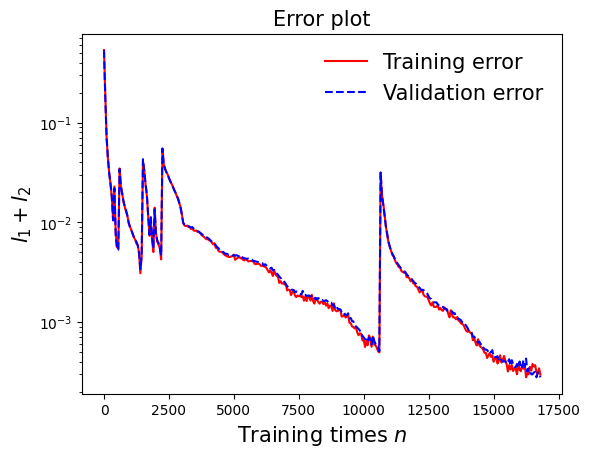

In [186]:
draw_loss(model14)

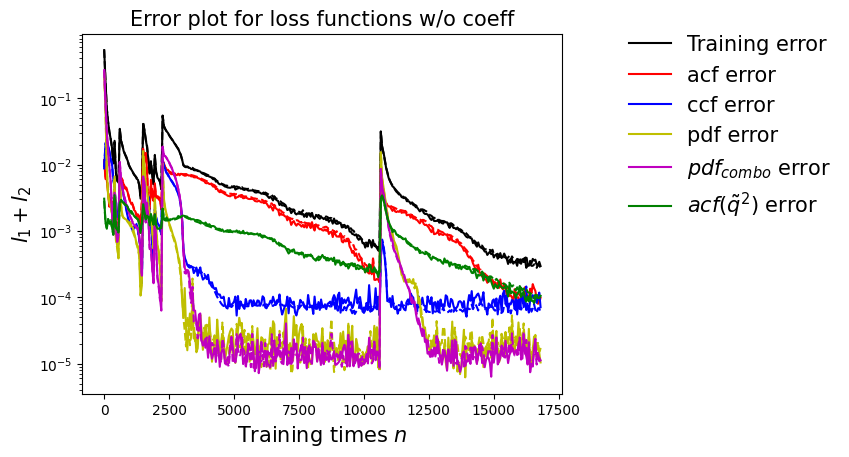

In [187]:
draw_errors(model14)

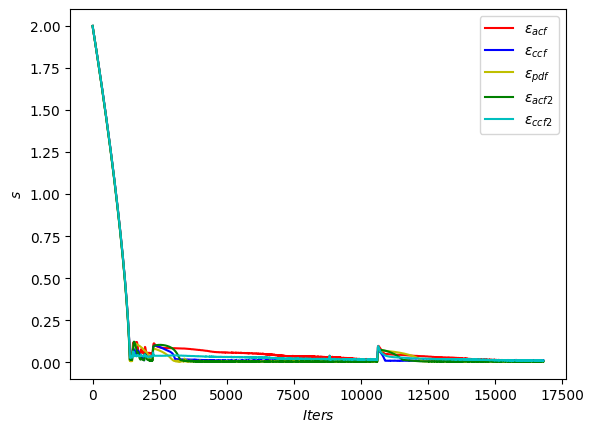

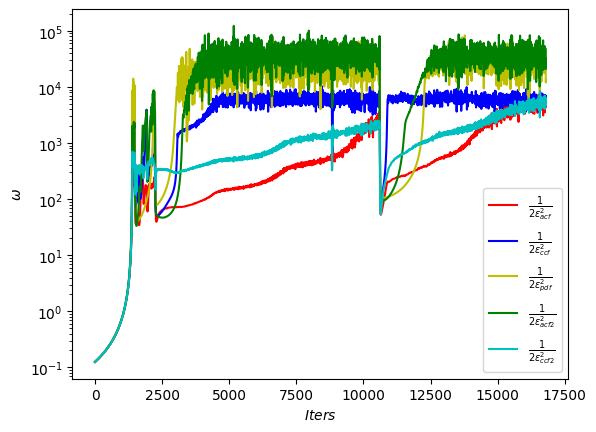

In [188]:
draw_adaptive_w(model14)
draw_epoch_w(model14)

In [189]:
### Defining SINN model
net15 = SINN(2, 10, 2, 2).to(device)
model15 = Model(net=net15)
model15.train()

[0]-th step loss: 0.5377, 0.5366, acf: 0.01093, ccf: 0.00062, pdf: 0.24929, pdf2: 0.27321, acf2: 0.00252
[50]-th step loss: 0.3985, 0.3864, acf: 0.00662, ccf: 0.00150, pdf: 0.20628, pdf2: 0.17070, acf2: 0.00134
[100]-th step loss: 0.0574, 0.0561, acf: 0.00692, ccf: 0.00540, pdf: 0.02681, pdf2: 0.01335, acf2: 0.00359
[150]-th step loss: 0.0172, 0.0173, acf: 0.00440, ccf: 0.00349, pdf: 0.00412, pdf2: 0.00400, acf2: 0.00130
[200]-th step loss: 0.0116, 0.0118, acf: 0.00420, ccf: 0.00244, pdf: 0.00179, pdf2: 0.00236, acf2: 0.00097
[250]-th step loss: 0.0076, 0.0076, acf: 0.00303, ccf: 0.00157, pdf: 0.00090, pdf2: 0.00119, acf2: 0.00092
[300]-th step loss: 0.0034, 0.0035, acf: 0.00107, ccf: 0.00060, pdf: 0.00053, pdf2: 0.00081, acf2: 0.00054
[350]-th step loss: 0.0022, 0.0024, acf: 0.00086, ccf: 0.00024, pdf: 0.00030, pdf2: 0.00063, acf2: 0.00039
[400]-th step loss: 0.0017, 0.0019, acf: 0.00073, ccf: 0.00019, pdf: 0.00019, pdf2: 0.00045, acf2: 0.00037
[450]-th step loss: 0.0015, 0.0016, acf:

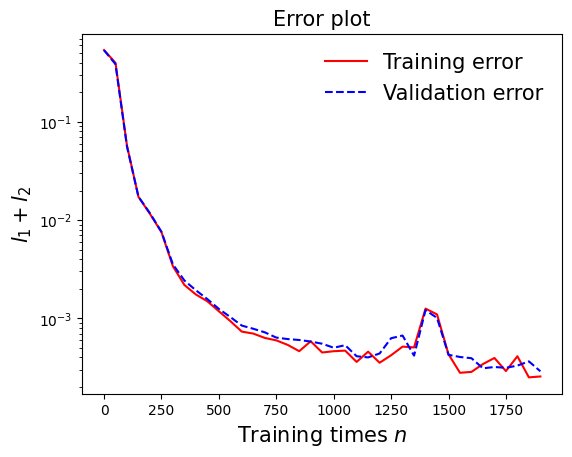

In [190]:
draw_loss(model15)

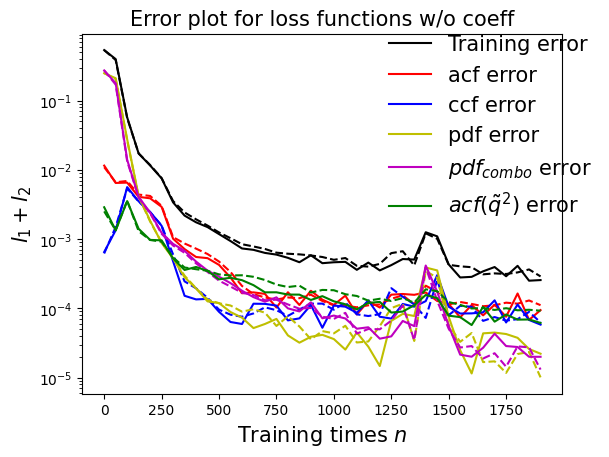

In [191]:
draw_errors(model15)


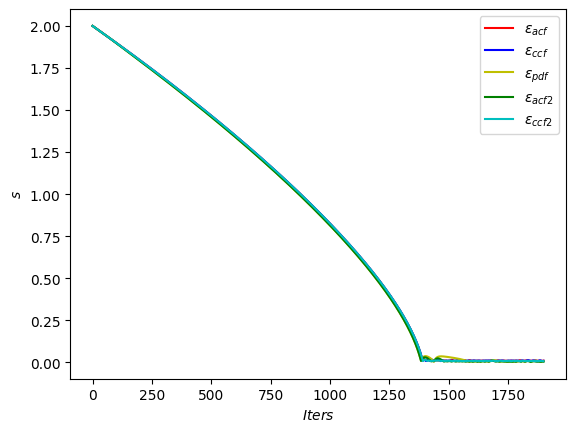

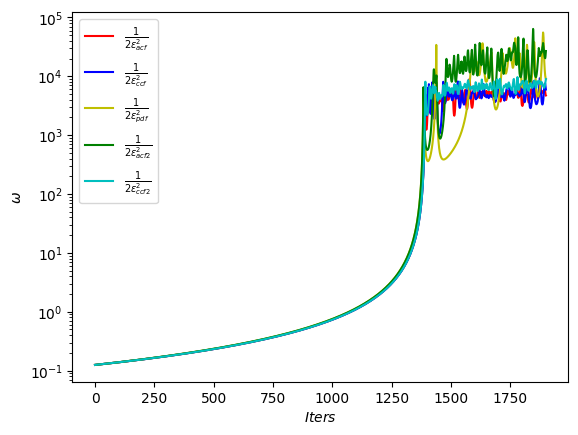

In [192]:
draw_adaptive_w(model15)
draw_epoch_w(model15)

In [193]:
### Defining SINN model
net16 = SINN(2, 10, 2, 2).to(device)
model16 = Model(net=net16)
model16.train()

[0]-th step loss: 0.5286, 0.5281, acf: 0.00907, ccf: 0.00038, pdf: 0.24592, pdf2: 0.27117, acf2: 0.00157
[50]-th step loss: 0.3450, 0.3340, acf: 0.00656, ccf: 0.00422, pdf: 0.17416, pdf2: 0.14773, acf2: 0.00128
[100]-th step loss: 0.0619, 0.0606, acf: 0.00723, ccf: 0.00816, pdf: 0.01714, pdf2: 0.02665, acf2: 0.00146
[150]-th step loss: 0.0210, 0.0208, acf: 0.00411, ccf: 0.00442, pdf: 0.00541, pdf2: 0.00537, acf2: 0.00151
[200]-th step loss: 0.0119, 0.0120, acf: 0.00427, ccf: 0.00207, pdf: 0.00220, pdf2: 0.00233, acf2: 0.00109
[250]-th step loss: 0.0073, 0.0074, acf: 0.00339, ccf: 0.00084, pdf: 0.00087, pdf2: 0.00126, acf2: 0.00102
[300]-th step loss: 0.0043, 0.0042, acf: 0.00144, ccf: 0.00093, pdf: 0.00038, pdf2: 0.00079, acf2: 0.00070
[350]-th step loss: 0.0031, 0.0031, acf: 0.00111, ccf: 0.00061, pdf: 0.00027, pdf2: 0.00058, acf2: 0.00058
[400]-th step loss: 0.0022, 0.0023, acf: 0.00066, ccf: 0.00054, pdf: 0.00024, pdf2: 0.00043, acf2: 0.00044
[450]-th step loss: 0.0017, 0.0018, acf:

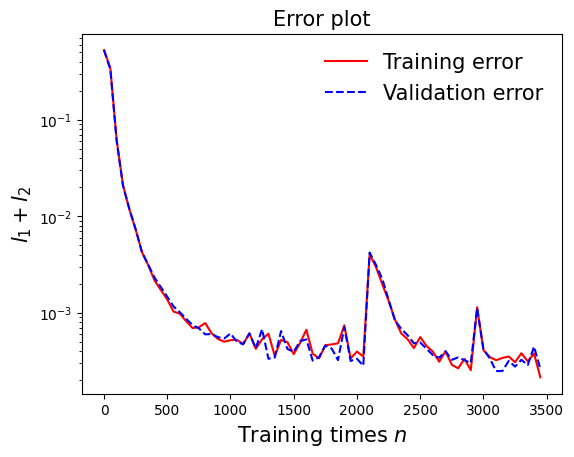

In [194]:
draw_loss(model16)


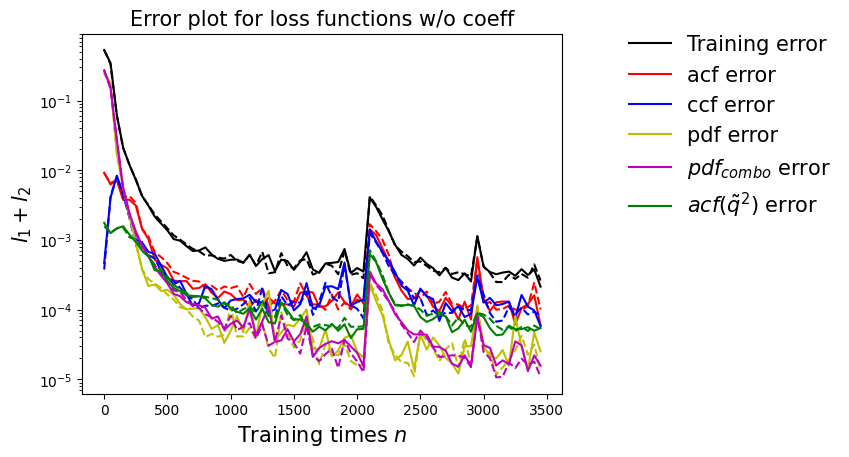

In [195]:
draw_errors(model16)

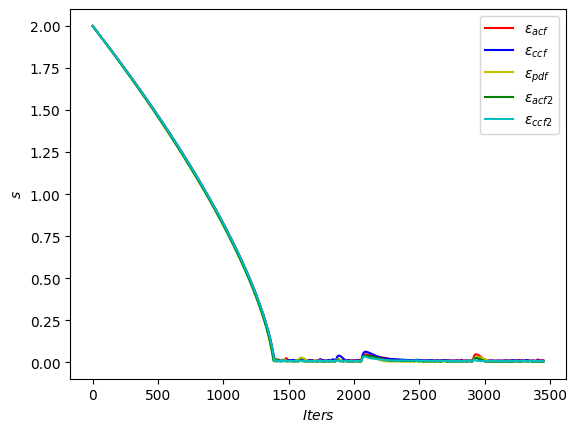

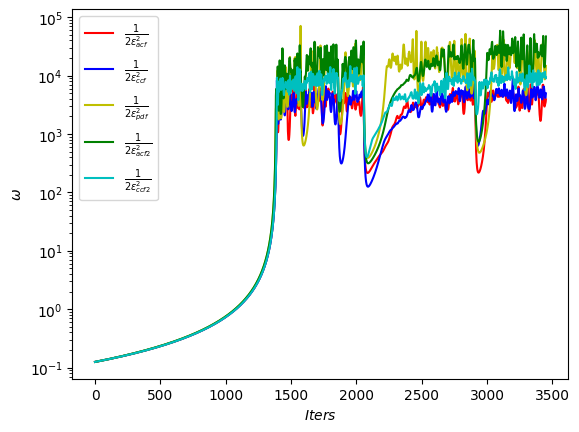

In [196]:
draw_adaptive_w(model16)
draw_epoch_w(model16)

In [197]:
### Defining SINN model
net17 = SINN(2, 10, 2, 2).to(device)
model17 = Model(net=net17)
model17.train()

[0]-th step loss: 0.5316, 0.5307, acf: 0.00916, ccf: 0.00978, pdf: 0.24517, pdf2: 0.26488, acf2: 0.00170
[50]-th step loss: 0.2015, 0.1920, acf: 0.01029, ccf: 0.02837, pdf: 0.06970, pdf2: 0.08139, acf2: 0.00229
[100]-th step loss: 0.0946, 0.0951, acf: 0.00977, ccf: 0.02850, pdf: 0.01562, pdf2: 0.03999, acf2: 0.00122
[150]-th step loss: 0.0726, 0.0725, acf: 0.00705, ccf: 0.02459, pdf: 0.00790, pdf2: 0.03194, acf2: 0.00105
[200]-th step loss: 0.0574, 0.0575, acf: 0.00565, ccf: 0.02124, pdf: 0.00400, pdf2: 0.02550, acf2: 0.00107
[250]-th step loss: 0.0435, 0.0433, acf: 0.00507, ccf: 0.01893, pdf: 0.00214, pdf2: 0.01591, acf2: 0.00122
[300]-th step loss: 0.0283, 0.0279, acf: 0.00340, ccf: 0.01641, pdf: 0.00191, pdf2: 0.00517, acf2: 0.00100
[350]-th step loss: 0.0167, 0.0165, acf: 0.00389, ccf: 0.00789, pdf: 0.00090, pdf2: 0.00237, acf2: 0.00148
[400]-th step loss: 0.0117, 0.0118, acf: 0.00349, ccf: 0.00417, pdf: 0.00096, pdf2: 0.00185, acf2: 0.00138
[450]-th step loss: 0.0072, 0.0073, acf:

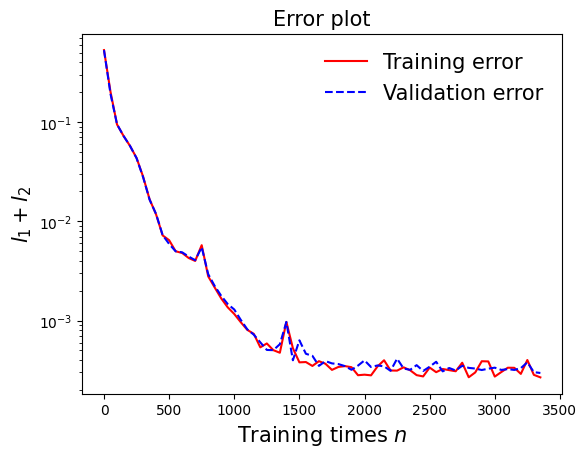

In [198]:
draw_loss(model17)

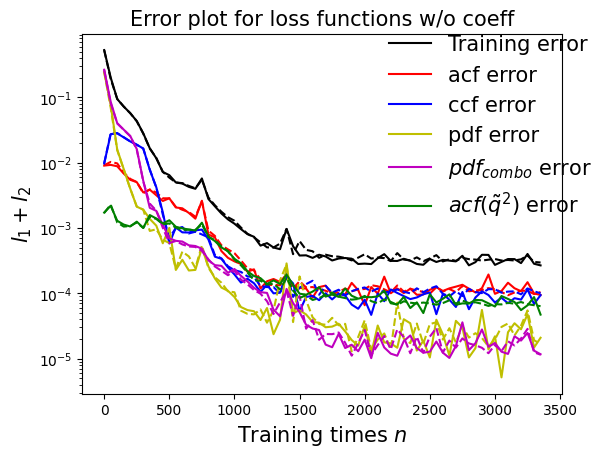

In [199]:
draw_errors(model17)

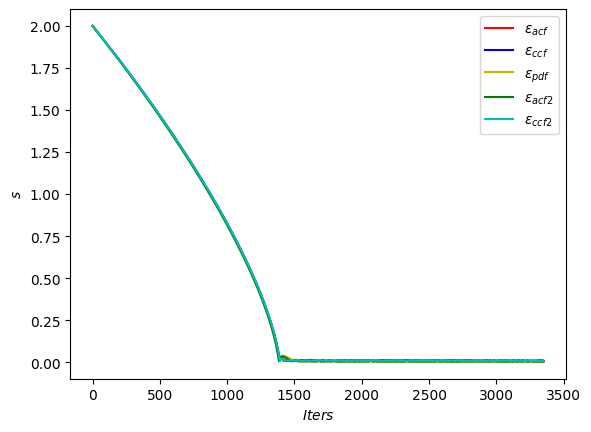

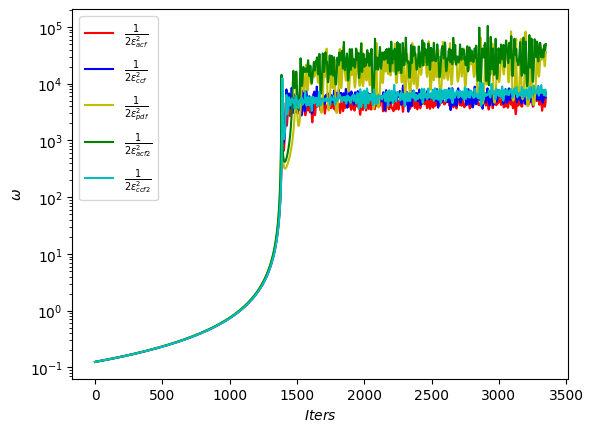

In [200]:
draw_adaptive_w(model17)
draw_epoch_w(model17)

In [201]:
### Defining SINN model
net18 = SINN(2, 10, 2, 2).to(device)
model18 = Model(net=net18)
model18.train()

[0]-th step loss: 0.5222, 0.5208, acf: 0.00885, ccf: 0.00144, pdf: 0.24470, pdf2: 0.26425, acf2: 0.00161
[50]-th step loss: 0.2157, 0.2054, acf: 0.00658, ccf: 0.00160, pdf: 0.12265, pdf2: 0.07310, acf2: 0.00151
[100]-th step loss: 0.0329, 0.0324, acf: 0.00517, ccf: 0.00552, pdf: 0.01267, pdf2: 0.00760, acf2: 0.00142
[150]-th step loss: 0.0173, 0.0173, acf: 0.00270, ccf: 0.00598, pdf: 0.00435, pdf2: 0.00312, acf2: 0.00113
[200]-th step loss: 0.0130, 0.0129, acf: 0.00288, ccf: 0.00452, pdf: 0.00237, pdf2: 0.00217, acf2: 0.00100
[250]-th step loss: 0.0091, 0.0092, acf: 0.00283, ccf: 0.00245, pdf: 0.00121, pdf2: 0.00164, acf2: 0.00112
[300]-th step loss: 0.0058, 0.0060, acf: 0.00205, ccf: 0.00087, pdf: 0.00078, pdf2: 0.00124, acf2: 0.00109
[350]-th step loss: 0.0034, 0.0036, acf: 0.00093, ccf: 0.00036, pdf: 0.00049, pdf2: 0.00098, acf2: 0.00088
[400]-th step loss: 0.0023, 0.0023, acf: 0.00036, ccf: 0.00026, pdf: 0.00036, pdf2: 0.00076, acf2: 0.00062
[450]-th step loss: 0.0016, 0.0016, acf:

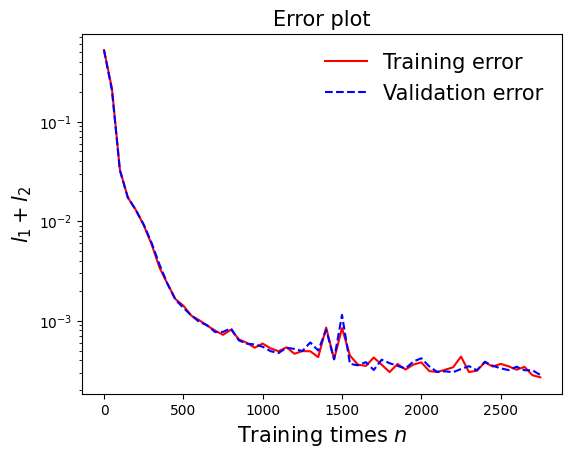

In [202]:
draw_loss(model18)

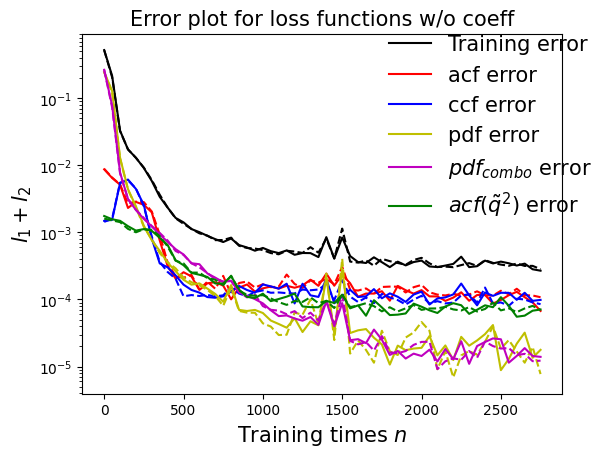

In [203]:
draw_errors(model18)

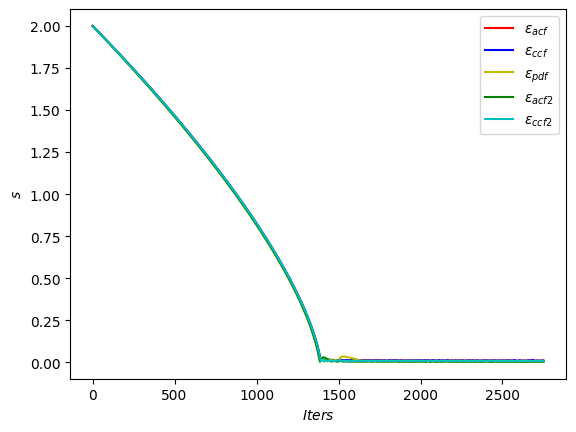

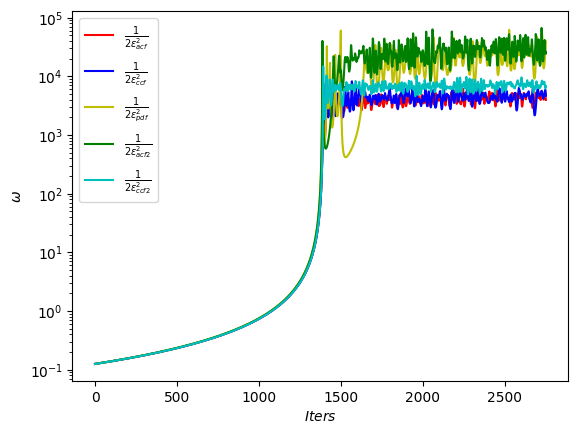

In [204]:
draw_adaptive_w(model18)
draw_epoch_w(model18)

In [205]:
### Defining SINN model
net19 = SINN(2, 10, 2, 2).to(device)
model19 = Model(net=net19)
model19.train()

[0]-th step loss: 0.5336, 0.5330, acf: 0.01062, ccf: 0.00185, pdf: 0.24756, pdf2: 0.27073, acf2: 0.00224
[50]-th step loss: 0.2456, 0.2379, acf: 0.00904, ccf: 0.00089, pdf: 0.15517, pdf2: 0.07053, acf2: 0.00230
[100]-th step loss: 0.0818, 0.0817, acf: 0.00861, ccf: 0.00984, pdf: 0.03632, pdf2: 0.02530, acf2: 0.00158
[150]-th step loss: 0.0500, 0.0500, acf: 0.00578, ccf: 0.00640, pdf: 0.02148, pdf2: 0.01503, acf2: 0.00134
[200]-th step loss: 0.0248, 0.0244, acf: 0.00318, ccf: 0.00578, pdf: 0.00791, pdf2: 0.00609, acf2: 0.00141
[250]-th step loss: 0.0145, 0.0143, acf: 0.00262, ccf: 0.00515, pdf: 0.00260, pdf2: 0.00297, acf2: 0.00096
[300]-th step loss: 0.0106, 0.0109, acf: 0.00245, ccf: 0.00416, pdf: 0.00177, pdf2: 0.00172, acf2: 0.00083
[350]-th step loss: 0.0087, 0.0087, acf: 0.00311, ccf: 0.00236, pdf: 0.00080, pdf2: 0.00133, acf2: 0.00112
[400]-th step loss: 0.0071, 0.0071, acf: 0.00293, ccf: 0.00165, pdf: 0.00060, pdf2: 0.00095, acf2: 0.00097
[450]-th step loss: 0.0061, 0.0061, acf:

[3850]-th step loss: 0.0008, 0.0008, acf: 0.00037, ccf: 0.00021, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00019
[3900]-th step loss: 0.0008, 0.0008, acf: 0.00036, ccf: 0.00023, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00019
[3950]-th step loss: 0.0007, 0.0008, acf: 0.00037, ccf: 0.00019, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00019
[4000]-th step loss: 0.0007, 0.0008, acf: 0.00035, ccf: 0.00017, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00019
[4050]-th step loss: 0.0007, 0.0007, acf: 0.00033, ccf: 0.00017, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00019
[4100]-th step loss: 0.0007, 0.0007, acf: 0.00032, ccf: 0.00016, pdf: 0.00003, pdf2: 0.00003, acf2: 0.00019
[4150]-th step loss: 0.0006, 0.0007, acf: 0.00031, ccf: 0.00015, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00019
[4200]-th step loss: 0.0007, 0.0007, acf: 0.00031, ccf: 0.00014, pdf: 0.00002, pdf2: 0.00002, acf2: 0.00020
[4250]-th step loss: 0.0006, 0.0007, acf: 0.00028, ccf: 0.00013, pdf: 0.00003, pdf2: 0.00002, acf2: 0.00019
[4300]-th step loss: 0.0006,

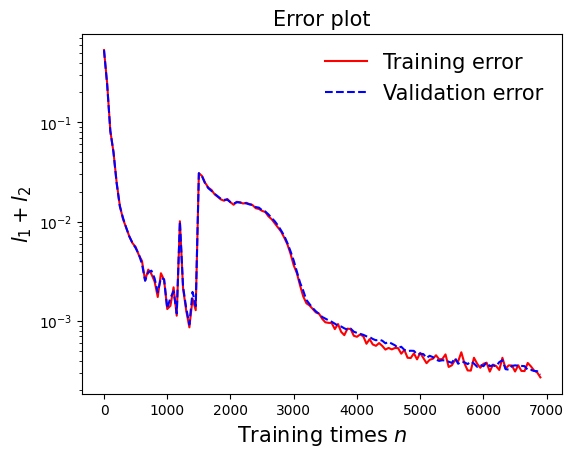

In [206]:
draw_loss(model19)

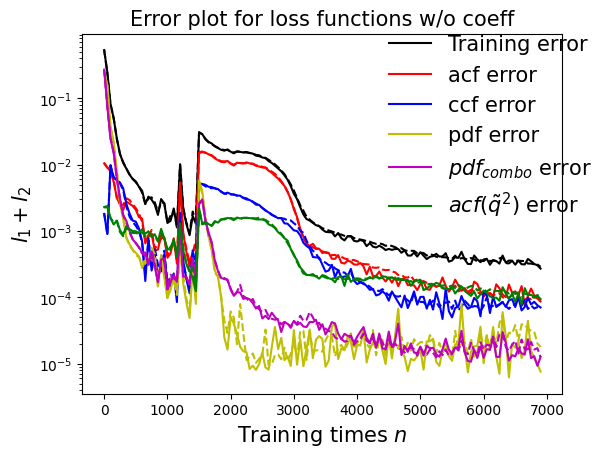

In [207]:
draw_errors(model19)

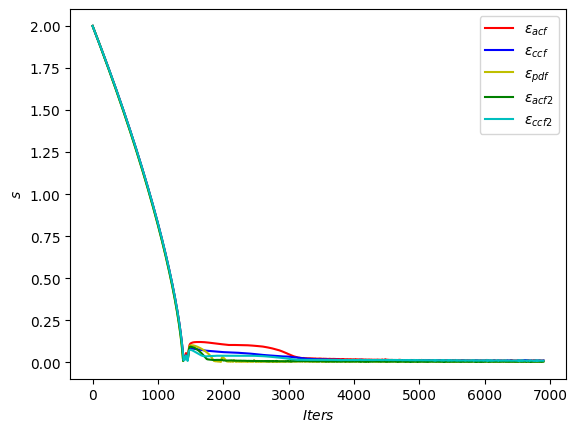

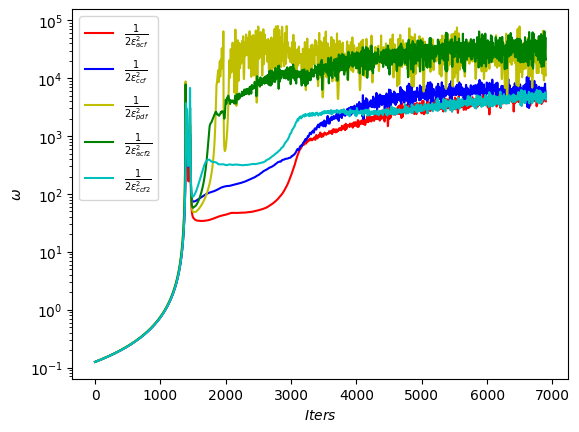

In [208]:
draw_adaptive_w(model19)
draw_epoch_w(model19)